In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%cd /content/drive/My Drive/optical-rl-gym-Modif
!ls #To check that we are inside the optical-rl-gym folder

/content/drive/My Drive/optical-rl-gym-Modif
docs			 Optimization_agents.ipynb	      setup.py
examples		 pyproject.toml			      tb
LICENSE			 README.md			      tests
optical_rl_gym		 Results_for_comparison_Agents.ipynb  tmp
optical_rl_gym.egg-info  setup.cfg


In [ ]:
!pip install -e .

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Obtaining file:///content/drive/My%20Drive/optical-rl-gym-Modif
  Installing build dependencies ... done
  Checking if build backend supports build_editable ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Running setup.py develop for optical-rl-gym


In [ ]:
from google.colab import drive
drive.mount('/content/drive')
!apt install swig cmake libopenmpi-dev zlib1g-dev
!pip install stable-baselines3[extra] box2d box2d-kengz
!pip install tensorflow==1.15

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Reading package lists... Done
Building dependency tree       
Reading state information... Done
libopenmpi-dev is already the newest version (4.0.3-0ubuntu1).
cmake is already the newest version (3.16.3-1ubuntu1.20.04.1).
zlib1g-dev is already the newest version (1:1.2.11.dfsg-2ubuntu1.5).
zlib1g-dev set to manually installed.
The following additional packages will be installed:
  swig4.0
Suggested packages:
  swig-doc swig-examples swig4.0-examples swig4.0-doc
The following NEW packages will be installed:
  swig swig4.0
0 upgraded, 2 newly installed, 0 to remove and 22 not upgraded.
Need to get 1,086 kB of archives.
After this operation, 5,413 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu focal/universe amd64 swig4.0 amd64 4.0.1-5build1 [1,081 kB]
Get:2 http://archive.ubuntu.com/ubuntu focal/universe amd64 swig all 4.0.1-5b

In [ ]:
%matplotlib inline
%config InlineBackend.figure_format = 'svg'

In [ ]:
import os
import gym
import pickle
import pandas as pd
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt

import logging
logging.getLogger('tensorflow').setLevel(logging.FATAL)
from IPython.display import clear_output

import stable_baselines3
from stable_baselines3.common.callbacks import BaseCallback
from stable_baselines3.common.results_plotter import load_results, ts2xy

ModuleNotFoundError: ignored

In [ ]:
from stable_baselines3 import DQN
from stable_baselines3 import PPO
from stable_baselines3 import A2C
from stable_baselines3.common.monitor import Monitor

In [ ]:
!pip install pandas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
class SaveOnBestTrainingRewardCallback(BaseCallback):
    """
    Callback for saving a model (the check is done every ``check_freq`` steps)
    based on the training reward (in practice, we recommend using ``EvalCallback``).

    :param check_freq: (int)
    :param log_dir: (str) Path to the folder where the model will be saved.
      It must contains the file created by the ``Monitor`` wrapper.
    :param verbose: (int)
    """
    def __init__(self, check_freq: int, log_dir: str, verbose=1):
        super(SaveOnBestTrainingRewardCallback, self).__init__(verbose)
        self.check_freq = check_freq
        self.log_dir = log_dir
        self.save_path = os.path.join(log_dir, 'best_model')
        self.best_mean_reward = -np.inf

    def _init_callback(self) -> None:
        # Create folder if needed
        if self.save_path is not None:
            os.makedirs(self.save_path, exist_ok=True)

    def _on_step(self) -> bool:
        if self.n_calls % self.check_freq == 0:
            # Retrieve training reward
            x, y = ts2xy(load_results(self.log_dir), 'timesteps')
            if len(x) > 0:
                 # Mean training reward over the last 100 episodes
                mean_reward = np.mean(y[-100:])
                if self.verbose > 0:
                    print("Num timesteps: {} - ".format(self.num_timesteps),end="")
                    print("Best mean reward: {:.2f} - Last mean reward per episode: {:.2f}".format(self.best_mean_reward, mean_reward))
                  # New best model, you could save the agent here
                if mean_reward > self.best_mean_reward:
                    self.best_mean_reward = mean_reward
                    # Example for saving best model
                    if self.verbose > 0:
                        print("Saving new best model to {}".format(self.save_path))
                        self.model.save(self.save_path)
                if self.verbose > 0:
                    clear_output(wait=True)

        return True

# Creating the topologies

NSFNET

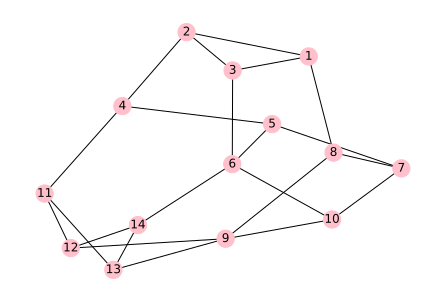

In [ ]:
## To Create the topology, use this part of the code, which calls the file "create_topology_nsfnet.py" designed to create nsfnet topology for k_paths = 5
## for which we did not have the h5 file

#import optical_rl_gym
#from optical_rl_gym.utils import Path

#from itertools import islice
#import numpy as np
#import networkx as nx
#import math
#import pickle
#from xml.dom.minidom import parse
#import xml.dom.minidom

#import matplotlib.pyplot as plt

#from examples.graph_utils import read_sndlib_topology, read_txt_file, get_k_shortest_paths, get_path_weight
#from examples.create_topology_nsfnet import get_topology

import h5py
import networkx as nx
import matplotlib as plt

nxG = nx.Graph()

import sys
sys.path.insert(0, "/content/drive/MyDrive/optical-rl-gym-Modif")

#import optical_rl_gym

# loading the topology binary file containing the graph and the k-shortest paths
# if you want to generate your own binary topology file, check examples/create_topology_rmsa.py
topology_name = 'nsfnet_chen_eon'
k_paths = 10


with open(f"/content/drive/MyDrive/optical-rl-gym-Modif/examples/topologies/{topology_name}_{k_paths}-paths.h5", 'rb') as f:
  topology = pickle.load(f)

#node probabilities from https://github.com/xiaoliangchenUCD/DeepRMSA/blob/6708e9a023df1ec05bfdc77804b6829e33cacfe4/Deep_RMSA_A3C.py#L77
node_request_probabilities = np.array([0.01801802, 0.04004004, 0.05305305, 0.01901902, 0.04504505,
       0.02402402, 0.06706707, 0.08908909, 0.13813814, 0.12212212,
       0.07607608, 0.12012012, 0.01901902, 0.16916917])

nxG.add_edges_from(topology.edges())
nxG.add_nodes_from(topology.nodes())
pos = nx.kamada_kawai_layout(nxG)
nx.draw(nxG, edge_color = 'black', node_color = 'pink', labels ={node: node for node in nxG.nodes()})

EUROCORE

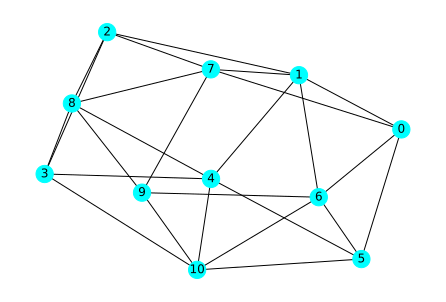

In [ ]:
## To Create the topology, use this part of the code, which calls the file "create_topology_eurocore.py" designed to create eurocore topology for k_paths = 5
## for which we did not have the h5 file

#import optical_rl_gym
#from optical_rl_gym.utils import Path

#from itertools import islice
#import numpy as np
#import networkx as nx
#import math
#import pickle
#from xml.dom.minidom import parse
#import xml.dom.minidom

#import matplotlib.pyplot as plt

#from examples.graph_utils import read_sndlib_topology, read_txt_file, get_k_shortest_paths, get_path_weight
#from examples.create_topology_eurocore import get_topology

import h5py
import networkx as nx
import matplotlib as plt

nxG2 = nx.Graph()
import sys
sys.path.insert(0, "/content/drive/MyDrive/optical-rl-gym-Modif")

topology_name_2 = 'eurocore_eon'
k_paths = 5

with open(f'/content/drive/MyDrive/optical-rl-gym-Modif/examples/topologies/{topology_name_2}_{k_paths}-paths.h5', 'rb') as f2:
    topology2 = pickle.load(f2)

node_request_probabilities_eurocore = np.array([1/11, 1/11, 1/11, 1/11, 1/11, 1/11, 1/11, 1/11, 1/11, 1/11, 1/11])

nxG2.add_edges_from(topology2.edges())
nxG2.add_nodes_from(topology2.nodes())
#pos2 = nx.kamada_kawai_layout(nxG2)
nx.draw(nxG2, edge_color = 'black', node_color = 'cyan', labels ={node: node for node in nxG2.nodes()})

New topology: 17 nodes, 28 edges

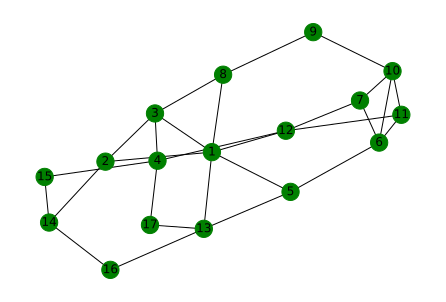

In [ ]:
## To Create the topology, use this part of the code, which calls the file "create_topology.py" designed to create new_topology topology

#import optical_rl_gym
#from optical_rl_gym.utils import Path

#from itertools import islice
#import numpy as np
#import networkx as nx
#import math
#import pickle
#from xml.dom.minidom import parse
#import xml.dom.minidom

#import matplotlib.pyplot as plt

#from examples.graph_utils import read_sndlib_topology, read_txt_file, get_k_shortest_paths, get_path_weight
#from examples.create_topology import get_topology

import h5py
import networkx as nx
import matplotlib as plt

# Importing and plotting the topology
nxG3 = nx.Graph()
import sys
sys.path.insert(0, "/content/drive/MyDrive/optical-rl-gym-Modif")

topology_name_3 = 'new_topology_eon'
k_paths = 5

with open(f'/content/drive/MyDrive/optical-rl-gym-Modif/examples/topologies/{topology_name_3}_{k_paths}-paths.h5', 'rb') as f3:
    topology3 = pickle.load(f3)

node_request_probabilities_new_topology = np.array([1/17, 1/17, 1/17, 1/17, 1/17,
       1/17, 1/17, 1/17, 1/17, 1/17, 1/17, 1/17,
       1/17, 1/17, 1/17, 1/17, 1/17])

nxG3.add_edges_from(topology3.edges())
nxG3.add_nodes_from(topology3.nodes())
#pos3 = nx.kamada_kawai_layout(nxG3)
nx.draw(nxG3, edge_color = 'black', node_color = 'green', labels ={node: node for node in nxG3.nodes()})

# Training the A2C agent

NSFNET topology

In [ ]:
from stable_baselines3.a2c.policies import MlpPolicy

for ht in [7.5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]:

  # mean_service_holding_time varying between 7.5 and 60,
  env_args = dict(topology=topology, seed=10, 
                allow_rejection=False, # the agent cannot proactively reject a request
                j=1, # consider only the first suitable spectrum block for the spectrum assignment
                mean_service_holding_time=ht, # value is not set as in the paper to achieve comparable reward values
                episode_length=50, node_request_probabilities=node_request_probabilities, num_spectrum_resources = 358)
  
  # Create log dir
  log_dir = "/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-{}-nsfnet".format(ht)
  os.makedirs(log_dir, exist_ok=True)
  callback = SaveOnBestTrainingRewardCallback(check_freq=100, log_dir=log_dir)

  env = gym.make('DeepRMSADPP-v0', **env_args)

  # logs will be saved in log_dir/monitor.csv
  # in this case, on top of the usual monitored things, we also monitor service and bit rate blocking probabilities
  env = Monitor(env, log_dir + 'training', info_keywords=('episode_service_blocking_rate', 'bit_rate_blocking_rate', 'failure', 'episode_failure',
                    'failure_slots','episode_failure_slots', 
                    'failure_disjointness','episode_failure_disjointness'))

  policy_args = dict(net_arch=5*[128])#, act_fun=tf.nn.elu) # the neural network has four layers with 150 neurons each

  agent = A2C(MlpPolicy, env, verbose=0, tensorboard_log="/content/drive/MyDrive/optical-rl-gym-Modif/tb/A2C-50-DeepRMSA-v0/", policy_kwargs=policy_args, gamma=.95 , learning_rate=10e-5)

  a = agent.learn(total_timesteps=50000, callback=callback)

  from stable_baselines3.common import results_plotter

  results_plotter.plot_results([log_dir], 1e10, results_plotter.X_TIMESTEPS, "DeepRMSA A2C for {}*10 Erlangs".format(ht))

  from stable_baselines3.common.evaluation import evaluate_policy

  testing_env = gym.make('DeepRMSADPP-v0', **env_args)

  # Logs will be saved in log_dir/monitor.csv
  testing_env = Monitor(testing_env, log_dir + 'testing', info_keywords=('episode_service_blocking_rate', 'bit_rate_blocking_rate','failure', 'episode_failure',
                    'failure_slots','episode_failure_slots', 
                    'failure_disjointness','episode_failure_disjointness'))

  # Evaluate the trained agent
  mean_reward, std_reward = evaluate_policy(a, testing_env, n_eval_episodes=500)

  print(f"mean_reward:{mean_reward:.2f} +/- {std_reward:.2f}")

Plotting the results

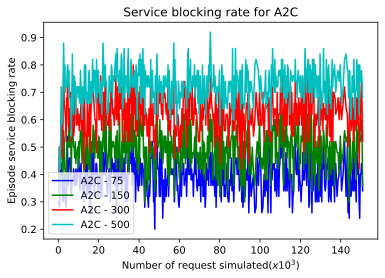

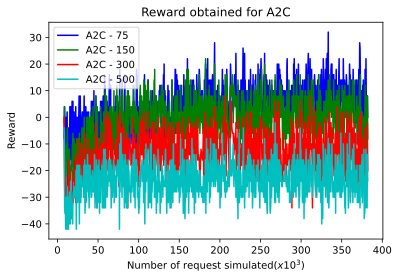

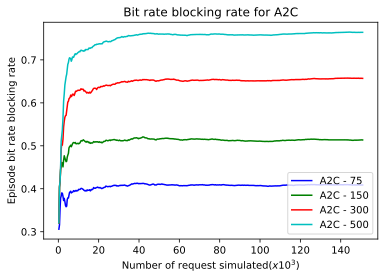

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Testing phase
df=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-7.5-nsfnet/testing.monitor.csv',header=1)
df_2=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-15-nsfnet/testing.monitor.csv',header=1)
df_3=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-30-nsfnet/testing.monitor.csv',header=1)
df_4=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-50-nsfnet/testing.monitor.csv',header=1)

df_5=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-7.5-nsfnet/training.monitor.csv',header=1)
df_6=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-15-nsfnet/training.monitor.csv',header=1)
df_7=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-30-nsfnet/training.monitor.csv',header=1)
df_8=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-50-nsfnet/training.monitor.csv',header=1)
images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results/a2c_topologies/'

x = df.t
y = df.episode_service_blocking_rate
y_2 = df_2.episode_service_blocking_rate
y_3 = df_3.episode_service_blocking_rate
y_4 = df_4.episode_service_blocking_rate

x2 = df_5.t
y_5 = df_5.r
y_6 = df_6.r
y_7 = df_7.r
y_8 = df_8.r

plt.plot(x, y, 'b')
plt.plot(x, y_2, 'g')
plt.plot(x, y_3, 'r')
plt.plot(x, y_4, 'c')

plt.xlabel("Number of request simulated" + '$(x10^3)$') 
plt.ylabel("Episode service blocking rate") 
plt.title("Service blocking rate for A2C") 
#plt.axhline(y=0.05, color='tab:red', linestyle='-')
plt.gca().legend(('A2C - 75', 'A2C - 150', 'A2C - 300', 'A2C - 500'))
plt.savefig(f"{images_dir}a2cSBR_2.png")
plt.show()



plt.plot(x2, y_5, 'b')
plt.plot(x2, y_6, 'g')
plt.plot(x2, y_7, 'r')
plt.plot(x2, y_8, 'c')

plt.xlabel("Number of request simulated" + '$(x10^3)$') 
plt.ylabel("Reward") 
plt.title("Reward obtained for A2C") 
#plt.axhline(y=0.05, color='tab:red', linestyle='-')
plt.gca().legend(('A2C - 75', 'A2C - 150', 'A2C - 300', 'A2C - 500'))
plt.savefig(f"{images_dir}a2cR_2.png")
plt.show()


z = df.bit_rate_blocking_rate
z_2 = df_2.bit_rate_blocking_rate
z_3 = df_3.bit_rate_blocking_rate
z_4 = df_4.bit_rate_blocking_rate

plt.plot(x, z, 'b')
plt.plot(x, z_2, 'g')
plt.plot(x, z_3, 'r')
plt.plot(x, z_4, 'c')

plt.xlabel("Number of request simulated" + '$(x10^3)$') 
plt.ylabel("Episode bit rate blocking rate") 
plt.title("Bit rate blocking rate for A2C") 
#plt.axhline(y=0.05, color='tab:red', linestyle='-')
plt.gca().legend(('A2C - 75', 'A2C - 150', 'A2C - 300', 'A2C - 500'))
plt.savefig(f"{images_dir}a2cBBR_2.png")
plt.show()

# Training on different topologies

Eurocore

/usr/local/lib/python3.8/dist-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.8/dist-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


mean_reward:27.34 +/- 10.74


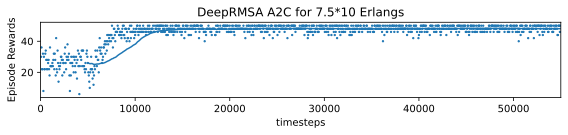

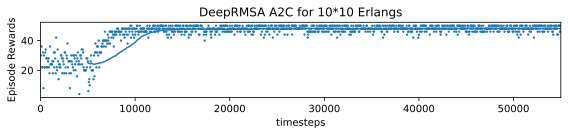

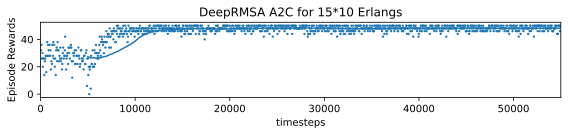

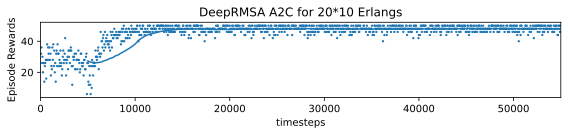

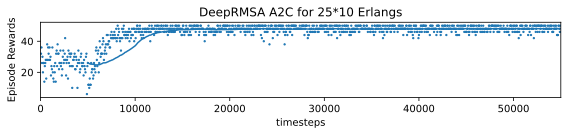

...

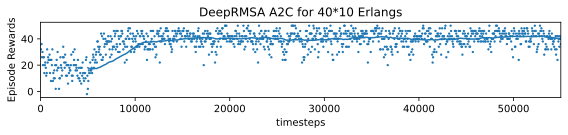

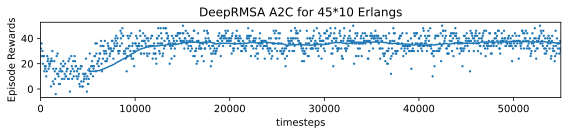

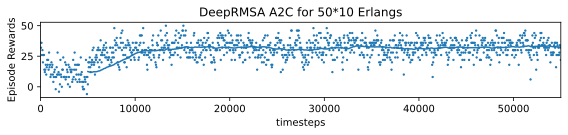

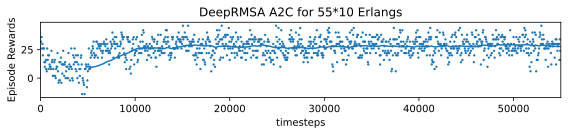

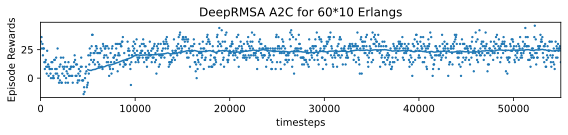

In [ ]:
from stable_baselines3.a2c import MlpPolicy

for ht in [7.5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]:
  env_args = dict(topology=topology2, seed=10, 
                  allow_rejection=False, # the agent cannot proactively reject a request
                  j=1, # consider only the first suitable spectrum block for the spectrum assignment
                  mean_service_holding_time=ht, # value is not set as in the paper to achieve comparable reward values
                  episode_length=50, node_request_probabilities=node_request_probabilities_eurocore, num_spectrum_resources = 358)

  # Create log dir
  log_dir = "/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-{}-eurocore/".format(ht)
  os.makedirs(log_dir, exist_ok=True)
  callback = SaveOnBestTrainingRewardCallback(check_freq=50, log_dir=log_dir)

  env = gym.make('DeepRMSADPP-v0', **env_args)

  # logs will be saved in log_dir/monitor.csv
  # in this case, on top of the usual monitored things, we also monitor service and bit rate blocking probabilities

  env = Monitor(env, log_dir + 'training', info_keywords=('episode_service_blocking_rate','bit_rate_blocking_rate','failure', 'episode_failure',
                    'failure_slots','episode_failure_slots', 
                    'failure_disjointness','episode_failure_disjointness'))
  
  policy_kwargs = dict(net_arch=5*[128])
  model = A2C(MlpPolicy, env, verbose=0, tensorboard_log="/content/drive/MyDrive/optical-rl-gym-Modif/tb/A2C-1k-DeepRMSA-v0/", gamma=.95, policy_kwargs=policy_kwargs,
           learning_rate=10e-5)

  training_m = model.learn(total_timesteps=50000, callback=callback)

  from stable_baselines3.common import results_plotter

  results_plotter.plot_results([log_dir], 1e5, results_plotter.X_TIMESTEPS, "DeepRMSA A2C for {}*10 Erlangs".format(ht))

  from stable_baselines3.common.evaluation import evaluate_policy
  testing_env = gym.make('DeepRMSADPP-v0', **env_args)

  # Logs will be saved in log_dir/monitor.csv
  testing_env = Monitor(testing_env, log_dir + 'testing', info_keywords=('episode_service_blocking_rate','bit_rate_blocking_rate','failure', 'episode_failure',
                    'failure_slots','episode_failure_slots', 
                    'failure_disjointness','episode_failure_disjointness'))

  # Evaluate the trained agent
  mean_reward, std_reward = evaluate_policy(model, testing_env, n_eval_episodes=100)

  print(f"mean_reward:{mean_reward:.2f} +/- {std_reward:.2f}")

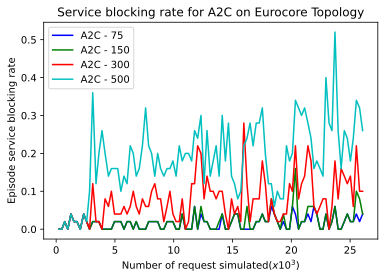

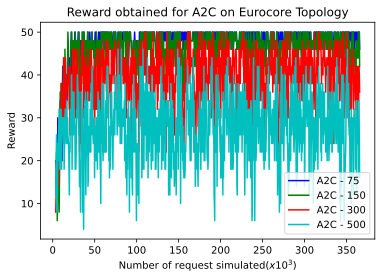

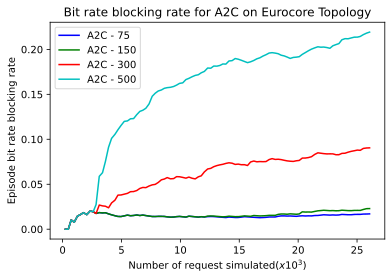

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Testing phase
df=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-7.5-eurocore/testing.monitor.csv',header=1)
df_2=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-30-eurocore/testing.monitor.csv',header=1)
df_3=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-40-eurocore/testing.monitor.csv',header=1)
df_4=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-55-eurocore/testing.monitor.csv',header=1)

df_5=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-7.5-eurocore/training.monitor.csv',header=1)
df_6=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-30-eurocore/training.monitor.csv',header=1)
df_7=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-40-eurocore/training.monitor.csv',header=1)
df_8=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-55-eurocore/training.monitor.csv',header=1)
images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results/a2c_topologies/'

x = df.t
y = df.episode_service_blocking_rate
y_2 = df_2.episode_service_blocking_rate
y_3 = df_3.episode_service_blocking_rate
y_4 = df_4.episode_service_blocking_rate

x2 = df_5.t
y_5 = df_5.r
y_6 = df_6.r
y_7 = df_7.r
y_8 = df_8.r

plt.plot(x, y, 'b')
plt.plot(x, y_2, 'g')
plt.plot(x, y_3, 'r')
plt.plot(x, y_4, 'c')

plt.xlabel("Number of request simulated" + '$(x10^3)$') 
plt.ylabel("Episode service blocking rate") 
plt.title("Service blocking rate for A2C on Eurocore Topology") 
#plt.axhline(y=0.05, color='tab:red', linestyle='-')
plt.gca().legend(('A2C - 75', 'A2C - 300', 'A2C - 400', 'A2C - 550'))
plt.savefig(f"{images_dir}a2cSBR_eurocore.png")
plt.show()



plt.plot(x2, y_5, 'b')
plt.plot(x2, y_6, 'g')
plt.plot(x2, y_7, 'r')
plt.plot(x2, y_8, 'c')

plt.xlabel("Number of request simulated" + '$(x10^3)$') 
plt.ylabel("Reward") 
plt.title("Reward obtained for A2C on Eurocore Topology") 
#plt.axhline(y=0.05, color='tab:red', linestyle='-')
plt.gca().legend(('A2C - 75', 'A2C - 300', 'A2C - 400', 'A2C - 550'))
plt.savefig(f"{images_dir}a2cR_eurocore.png")
plt.show()


z = df.bit_rate_blocking_rate
z_2 = df_2.bit_rate_blocking_rate
z_3 = df_3.bit_rate_blocking_rate
z_4 = df_4.bit_rate_blocking_rate

plt.plot(x, z, 'b')
plt.plot(x, z_2, 'g')
plt.plot(x, z_3, 'r')
plt.plot(x, z_4, 'c')

plt.xlabel("Number of request simulated" + '$(x10^3)$') 
plt.ylabel("Episode bit rate blocking rate") 
plt.title("Bit rate blocking rate for A2C on Eurocore Topology") 
#plt.axhline(y=0.05, color='tab:red', linestyle='-')
plt.gca().legend(('A2C - 75', 'A2C - 300', 'A2C - 400', 'A2C - 550'))
plt.savefig(f"{images_dir}a2cBBR_eurocore.png")
plt.show()

New topology: 17 nodes, 28 edges

/usr/local/lib/python3.8/dist-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.8/dist-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


mean_reward:-1.60 +/- 7.75


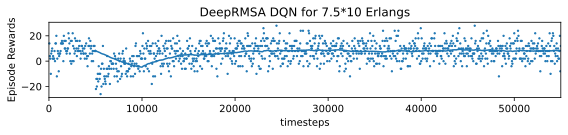

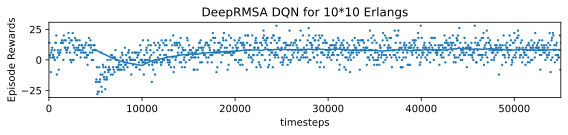

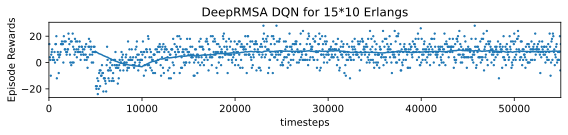

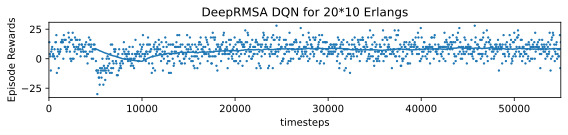

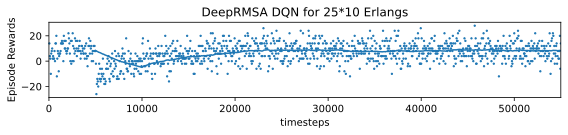

...

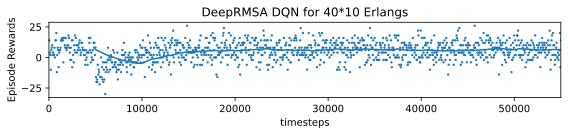

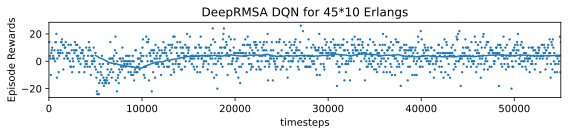

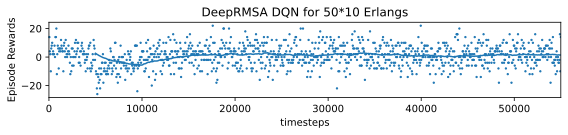

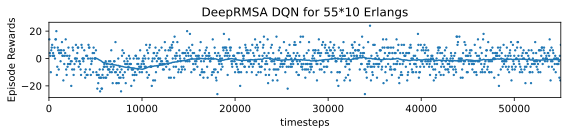

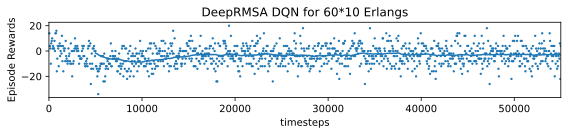

In [ ]:
from stable_baselines3.a2c import MlpPolicy

for ht in [7.5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]:

  env_args = dict(topology=topology3, seed=10, 
                  allow_rejection=False, # the agent cannot proactively reject a request
                  j=1, # consider only the first suitable spectrum block for the spectrum assignment
                  mean_service_holding_time=ht, # value is not set as in the paper to achieve comparable reward values
                  episode_length=50, node_request_probabilities=node_request_probabilities_new_topology, num_spectrum_resources = 358)

  # Create log dir
  log_dir = "/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-{}-new_topology/".format(ht)
  os.makedirs(log_dir, exist_ok=True)
  callback = SaveOnBestTrainingRewardCallback(check_freq=50, log_dir=log_dir)

  env = gym.make('DeepRMSADPP-v0', **env_args)

  # logs will be saved in log_dir/monitor.csv
  # in this case, on top of the usual monitored things, we also monitor service and bit rate blocking probabilities

  env = Monitor(env, log_dir + 'training', info_keywords=('episode_service_blocking_rate','bit_rate_blocking_rate','failure', 'episode_failure',
                    'failure_slots','episode_failure_slots', 
                    'failure_disjointness','episode_failure_disjointness'))
  
  policy_kwargs = dict(net_arch=5*[128])
  model = A2C(MlpPolicy, env, verbose=0, tensorboard_log="/content/drive/MyDrive/optical-rl-gym-Modif/tb/DQN-1k-DeepRMSA-v0/", gamma=.95, policy_kwargs=policy_kwargs,
           learning_rate=10e-5)

  training_m = model.learn(total_timesteps=50000, callback=callback)

  from stable_baselines3.common import results_plotter

  results_plotter.plot_results([log_dir], 1e5, results_plotter.X_TIMESTEPS, "DeepRMSA DQN for {}*10 Erlangs".format(ht))

  from stable_baselines3.common.evaluation import evaluate_policy
  testing_env = gym.make('DeepRMSADPP-v0', **env_args)

  # Logs will be saved in log_dir/monitor.csv
  testing_env = Monitor(testing_env, log_dir + 'testing', info_keywords=('episode_service_blocking_rate','bit_rate_blocking_rate','failure', 'episode_failure',
                    'failure_slots','episode_failure_slots', 
                    'failure_disjointness','episode_failure_disjointness'))

  # Evaluate the trained agent
  mean_reward, std_reward = evaluate_policy(model, testing_env, n_eval_episodes=100)

  print(f"mean_reward:{mean_reward:.2f} +/- {std_reward:.2f}")


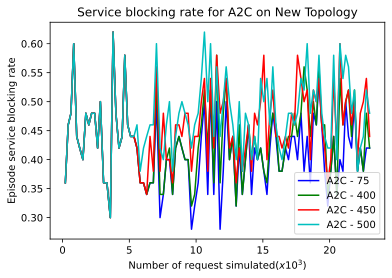

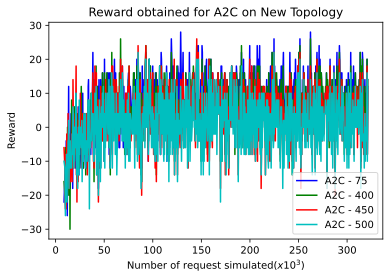

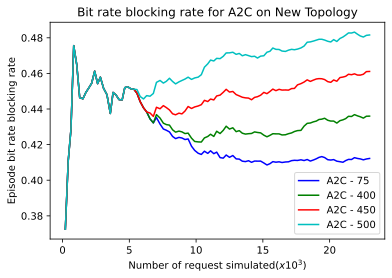

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Testing phase
df=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-7.5-new_topology/testing.monitor.csv',header=1)
df_2=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-40-new_topology/testing.monitor.csv',header=1)
df_3=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-45-new_topology/testing.monitor.csv',header=1)
df_4=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-50-new_topology/testing.monitor.csv',header=1)

df_5=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-7.5-new_topology/training.monitor.csv',header=1)
df_6=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-40-new_topology/training.monitor.csv',header=1)
df_7=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-45-new_topology/training.monitor.csv',header=1)
df_8=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-50-new_topology/training.monitor.csv',header=1)
images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results/a2c_topologies/'

x = df.t
y = df.episode_service_blocking_rate
y_2 = df_2.episode_service_blocking_rate
y_3 = df_3.episode_service_blocking_rate
y_4 = df_4.episode_service_blocking_rate

x2 = df_5.t
y_5 = df_5.r
y_6 = df_6.r
y_7 = df_7.r
y_8 = df_8.r

plt.plot(x, y, 'b')
plt.plot(x, y_2, 'g')
plt.plot(x, y_3, 'r')
plt.plot(x, y_4, 'c')

plt.xlabel("Number of request simulated" + '$(x10^3)$') 
plt.ylabel("Episode service blocking rate") 
plt.title("Service blocking rate for A2C on New Topology") 
#plt.axhline(y=0.05, color='tab:red', linestyle='-')
plt.gca().legend(('A2C - 75', 'A2C - 400', 'A2C - 450', 'A2C - 500'))
plt.savefig(f"{images_dir}a2cSBR_newt.png")
plt.show()



plt.plot(x2, y_5, 'b')
plt.plot(x2, y_6, 'g')
plt.plot(x2, y_7, 'r')
plt.plot(x2, y_8, 'c')

plt.xlabel("Number of request simulated" + '$(x10^3)$') 
plt.ylabel("Reward") 
plt.title("Reward obtained for A2C on New Topology") 
plt.gca().legend(('A2C - 75', 'A2C - 400', 'A2C - 450', 'A2C - 500'))
plt.savefig(f"{images_dir}a2cR_newt.png")
plt.show()


z = df.bit_rate_blocking_rate
z_2 = df_2.bit_rate_blocking_rate
z_3 = df_3.bit_rate_blocking_rate
z_4 = df_4.bit_rate_blocking_rate

plt.plot(x, z, 'b')
plt.plot(x, z_2, 'g')
plt.plot(x, z_3, 'r')
plt.plot(x, z_4, 'c')

plt.xlabel("Number of request simulated" + '$(x10^3)$') 
plt.ylabel("Episode bit rate blocking rate") 
plt.title("Bit rate blocking rate for A2C on New Topology") 
plt.gca().legend(('A2C - 75', 'A2C - 400', 'A2C - 450', 'A2C - 500'))
plt.savefig(f"{images_dir}a2cBBR_newt.png")
plt.show()

# Heuristics

## NSFNET

### Shortest Available Path First Fit: KSP-FF

In [ ]:
import time
from stable_baselines3.a2c import MlpPolicy
from optical_rl_gym.envs.deeprmsa_env_dpp_ksp import shortest_path_first_fit, shortest_available_path_first_fit

from stable_baselines3.common.evaluation import evaluate_policy
from optical_rl_gym.utils import evaluate_heuristic, random_policy


testing_runtime_heuristic_nsfnet_sp_ff = []

for ht in [7.5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]:


  env_args = dict(topology=topology, seed=10, 
                  allow_rejection=False, # the agent cannot proactively reject a request
                  j=1, # consider only the first suitable spectrum block for the spectrum assignment
                  mean_service_holding_time=ht, # value is not set as in the paper to achieve comparable reward values
                  episode_length=50, node_request_probabilities=node_request_probabilities, num_spectrum_resources = 358)

  # Create log dir
  log_dir = "/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/heuristics-{}-nsfnet/".format(ht)
  os.makedirs(log_dir, exist_ok=True)
  callback = SaveOnBestTrainingRewardCallback(check_freq=50, log_dir=log_dir)

  env = gym.make('DeepRMSADPPKSP-v0', **env_args)

  # logs will be saved in log_dir/monitor.csv
  # in this case, on top of the usual monitored things, we also monitor service and bit rate blocking probabilities

  env = Monitor(env, log_dir + 'sp_ff', info_keywords=('episode_service_blocking_rate','bit_rate_blocking_rate','failure', 'episode_failure',
                      'failure_slots','episode_failure_slots', 
                      'failure_disjointness','episode_failure_disjointness'))


  # Evaluate the trained agent
  
  start_testing = time.time()
  mean_reward_sp_ff, std_reward_sp_ff = evaluate_heuristic(env, shortest_path_first_fit, n_eval_episodes=2000)

  end_testing = time.time()

  time_testing = end_testing - start_testing

  testing_runtime_heuristic_nsfnet_sp_ff.append(time_testing)

  print("Time testing: ", end_testing - start_testing)

  print(f"mean_reward:{mean_reward_sp_ff:.2f} +/- {std_reward_sp_ff:.2f}")

  print('SP-FF:'.ljust(8), f'{mean_reward_sp_ff:.4f}  {std_reward_sp_ff:>7.4f}')
  print('Bit rate blocking:', (env.episode_bit_rate_requested - env.episode_bit_rate_provisioned) / env.episode_bit_rate_requested)
  print('Request blocking:', (env.episode_services_processed - env.episode_services_accepted) / env.episode_services_processed)

/usr/local/lib/python3.8/dist-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.8/dist-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Time testing:  601.6557993888855
mean_reward:39.01 +/- 6.82
SP-FF:   39.0100   6.8200
Bit rate blocking: 0.17683302526186076
Request blocking: 0.14
Time testing:  591.3447806835175
mean_reward:29.29 +/- 8.35
SP-FF:   29.2940   8.3452
Bit rate blocking: 0.18253234750462108
Request blocking: 0.16
Time testing:  543.0315017700195
mean_reward:15.85 +/- 8.40
SP-FF:   15.8450   8.3994
Bit rate blocking: 0.5043130006161429
Request blocking: 0.46
Time testing:  509.45025658607483
mean_reward:6.51 +/- 8.57
SP-FF:   6.5060   8.5732
Bit rate blocking: 0.6260012322858903
Request blocking: 0.58
Time testing:  485.6659824848175
mean_reward:-0.84 +/- 8.57
SP-FF:   -0.8400   8.5659
Bit rate blocking: 0.5460566851509551
Request blocking: 0.5
Time testing:  478.11456656455994
mean_reward:-6.07 +/- 8.14
SP-FF:   -6.0700   8.1424
Bit rate blocking: 0.6837646333949476
Request blocking: 0.62
Time testing:  462.116108417511
mean_reward:-10.63 +/- 7.89
SP-FF:   -10.6260   7.8885
Bit rate blocking: 0.586105976

## Eurocore

### Shortest Available Path First Fit: KSP-FF

In [ ]:
import time
from optical_rl_gym.envs.deeprmsa_env_dpp_ksp import shortest_path_first_fit, shortest_available_path_first_fit


from stable_baselines3.common.evaluation import evaluate_policy
from optical_rl_gym.utils import evaluate_heuristic, random_policy


testing_runtime_heuristic_eurocore_sp_ff = []

for ht in [7.5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]:

  env_args = dict(topology=topology2, seed=10, 
                  allow_rejection=False, # the agent cannot proactively reject a request
                  j=1, # consider only the first suitable spectrum block for the spectrum assignment
                  mean_service_holding_time=ht, # value is not set as in the paper to achieve comparable reward values
                  episode_length=50, node_request_probabilities = node_request_probabilities_eurocore, num_spectrum_resources = 358)

  # Create log dir
  log_dir = "/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/heuristics-{}-eurocore/".format(ht)
  os.makedirs(log_dir, exist_ok=True)
  callback = SaveOnBestTrainingRewardCallback(check_freq=50, log_dir=log_dir)

  env = gym.make('DeepRMSADPPKSP-v0', **env_args)

  env = Monitor(env, log_dir + 'sp_ff', info_keywords=('episode_service_blocking_rate','bit_rate_blocking_rate','failure', 'episode_failure',
                      'failure_slots','episode_failure_slots', 
                      'failure_disjointness','episode_failure_disjointness'))


  # Evaluate the trained agent

  start_testing = time.time()

  mean_reward_sp_ff, std_reward_sp_ff = evaluate_heuristic(env, shortest_path_first_fit, n_eval_episodes=2000)

  end_testing = time.time()

  time_testing = end_testing - start_testing
  
  testing_runtime_heuristic_eurocore_sp_ff.append(time_testing)

  print("Testing time: ", end_testing - start_testing)

  print(f"mean_reward:{mean_reward_sp_ff:.2f} +/- {std_reward_sp_ff:.2f}")
  
  print('SP-FF:'.ljust(8), f'{mean_reward_sp_ff:.4f}  {std_reward_sp_ff:>7.4f}')
  print('Bit rate blocking:', (env.episode_bit_rate_requested - env.episode_bit_rate_provisioned) / env.episode_bit_rate_requested)
  print('Request blocking:', (env.episode_services_processed - env.episode_services_accepted) / env.episode_services_processed)

Testing time:  552.6124997138977
mean_reward:48.30 +/- 2.53
SP-FF:   48.3000   2.5255
Bit rate blocking: 0.05083179297597042
Request blocking: 0.04
Testing time:  534.9113705158234
mean_reward:45.42 +/- 4.09
SP-FF:   45.4170   4.0942
Bit rate blocking: 0.11337030191004313
Request blocking: 0.1
Testing time:  524.6934599876404
mean_reward:41.30 +/- 5.53
SP-FF:   41.2980   5.5349
Bit rate blocking: 0.08826247689463956
Request blocking: 0.08
Testing time:  507.91895484924316
mean_reward:36.53 +/- 6.71
SP-FF:   36.5320   6.7130
Bit rate blocking: 0.20271102895871843
Request blocking: 0.18
Testing time:  493.0252776145935
mean_reward:31.79 +/- 7.63
SP-FF:   31.7940   7.6327
Bit rate blocking: 0.2570856438693777
Request blocking: 0.24
Testing time:  476.36853432655334
mean_reward:27.40 +/- 7.94
SP-FF:   27.4020   7.9397
Bit rate blocking: 0.3615218730745533
Request blocking: 0.32


## New topology: 17 nodes, 28 edges

### Shortest Available Path FIrst Fit: KSP-FF

In [ ]:
import time

from optical_rl_gym.envs.deeprmsa_env_dpp_ksp import shortest_path_first_fit, shortest_available_path_first_fit

from stable_baselines3.common.evaluation import evaluate_policy
from optical_rl_gym.utils import evaluate_heuristic, random_policy

testing_runtime_heuristic_newt_sp_ff = []

for ht in [7.5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]:


  env_args = dict(topology=topology3, seed=10, 
                  allow_rejection=False, # the agent cannot proactively reject a request
                  j=1, # consider only the first suitable spectrum block for the spectrum assignment
                  mean_service_holding_time=ht, # value is not set as in the paper to achieve comparable reward values
                  episode_length=50, node_request_probabilities=node_request_probabilities_new_topology, num_spectrum_resources = 358)

  # Create log dir
  log_dir = "/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/heuristics-{}-new_topology/".format(ht)
  os.makedirs(log_dir, exist_ok=True)
  callback = SaveOnBestTrainingRewardCallback(check_freq=50, log_dir=log_dir)

  env = gym.make('DeepRMSADPPKSP-v0', **env_args)

  # logs will be saved in log_dir/monitor.csv
  # in this case, on top of the usual monitored things, we also monitor service and bit rate blocking probabilities

  env = Monitor(env, log_dir + 'sp_ff', info_keywords=('episode_service_blocking_rate','bit_rate_blocking_rate','failure', 'episode_failure',
                      'failure_slots','episode_failure_slots', 
                      'failure_disjointness','episode_failure_disjointness'))
  

  # Evaluate the trained agent

  start_testing = time.time()

  mean_reward_sp_ff, std_reward_sp_ff = evaluate_heuristic(env, shortest_path_first_fit, n_eval_episodes=2000)

  end_testing = time.time()

  time_testing = end_testing - start_testing

  testing_runtime_heuristic_newt_sp_ff.append(time_testing)

  print("Testing time: ", end_testing - start_testing)

  print(f"mean_reward:{mean_reward_sp_ff:.2f} +/- {std_reward_sp_ff:.2f}")

  print('SP-FF:'.ljust(8), f'{mean_reward_sp_ff:.4f}  {std_reward_sp_ff:>7.4f}')
  print('Bit rate blocking:', (env.episode_bit_rate_requested - env.episode_bit_rate_provisioned) / env.episode_bit_rate_requested)
  print('Request blocking:', (env.episode_services_processed - env.episode_services_accepted) / env.episode_services_processed)

Testing time:  546.504287481308
mean_reward:41.20 +/- 3.98
SP-FF:   41.2010   3.9849
Bit rate blocking: 0.07131854590264941
Request blocking: 0.06
Testing time:  555.219583272934
mean_reward:41.20 +/- 3.98
SP-FF:   41.2010   3.9849
Bit rate blocking: 0.07131854590264941
Request blocking: 0.06
Testing time:  578.9607801437378
mean_reward:41.20 +/- 3.98
SP-FF:   41.2010   3.9849
Bit rate blocking: 0.07131854590264941
Request blocking: 0.06


/usr/local/lib/python3.8/dist-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.8/dist-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Testing time:  593.8232476711273
mean_reward:40.32 +/- 4.37
SP-FF:   40.3220   4.3718
Bit rate blocking: 0.07131854590264941
Request blocking: 0.06
Testing time:  587.7650909423828
mean_reward:36.09 +/- 5.83
SP-FF:   36.0860   5.8269
Bit rate blocking: 0.21796056685150955
Request blocking: 0.18
Testing time:  564.4157750606537
mean_reward:29.83 +/- 7.21
SP-FF:   29.8310   7.2134
Bit rate blocking: 0.34165126309303756
Request blocking: 0.3
Testing time:  538.1396169662476
mean_reward:23.59 +/- 7.85
SP-FF:   23.5860   7.8501
Bit rate blocking: 0.46226124460874923
Request blocking: 0.4
Testing time:  512.4188344478607
mean_reward:17.85 +/- 8.27
SP-FF:   17.8500   8.2696
Bit rate blocking: 0.33903265557609363
Request blocking: 0.3
Testing time:  493.322735786438
mean_reward:13.55 +/- 8.37
SP-FF:   13.5470   8.3719
Bit rate blocking: 0.5271102895871842
Request blocking: 0.48
Testing time:  473.61725902557373
mean_reward:9.45 +/- 8.32
SP-FF:   9.4500   8.3248
Bit rate blocking: 0.63031423290

.

=============================================================================


### Plotting the results


=============================================================================

.

### Comparison between topologies for agents and heuristics

[0.40586095313943443, 0.44495422016617636, 0.5109970197849039, 0.558668817079142, 0.6003982269249866, 0.6450488546083967, 0.6762882129146958, 0.7025989803048074, 0.7319491846308284, 0.7481123753426725, 0.7659687744409497, 0.7824787976686493]
[0.3948, 0.43060000000000004, 0.49344000000000005, 0.5385599999999999, 0.582, 0.6229199999999999, 0.6547200000000001, 0.6796800000000001, 0.70804, 0.7262799999999999, 0.7444000000000001, 0.76024]
[0.01449176165011876, 0.01449176165011876, 0.01449176165011876, 0.01449176165011876, 0.01449176165011876, 0.016041084970291067, 0.03307003533007755, 0.06027311413739201, 0.09519938160685365, 0.1202393400583329, 0.15553840594142443, 0.18119678224758448]
[0.016800000000000002, 0.016800000000000002, 0.016800000000000002, 0.016800000000000002, 0.016800000000000002, 0.0212, 0.046400000000000004, 0.07659999999999999, 0.11800000000000002, 0.1516, 0.18739999999999998, 0.22659999999999997]
[0.42346633342460627, 0.42346633342460627, 0.42346633342460627, 0.4234663334

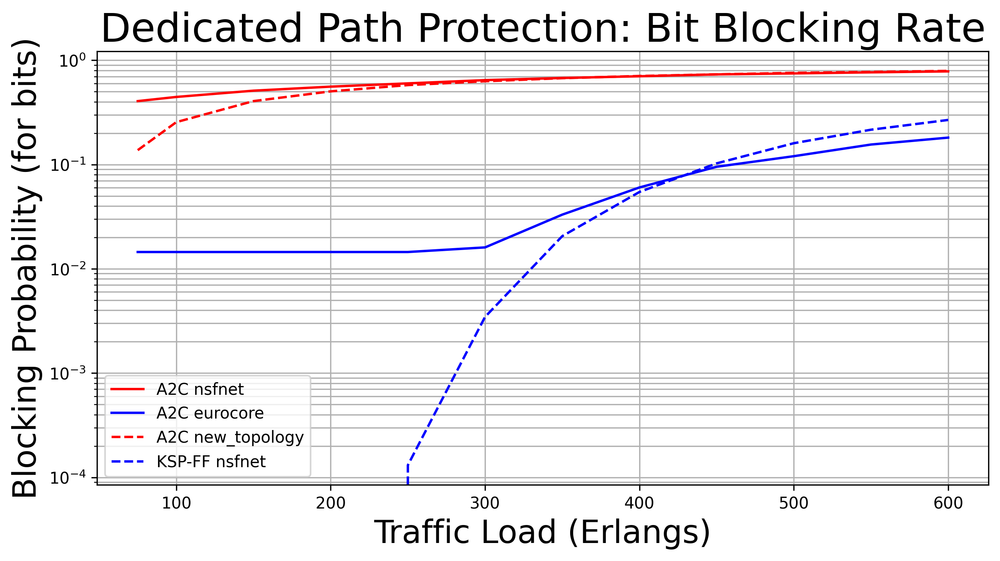

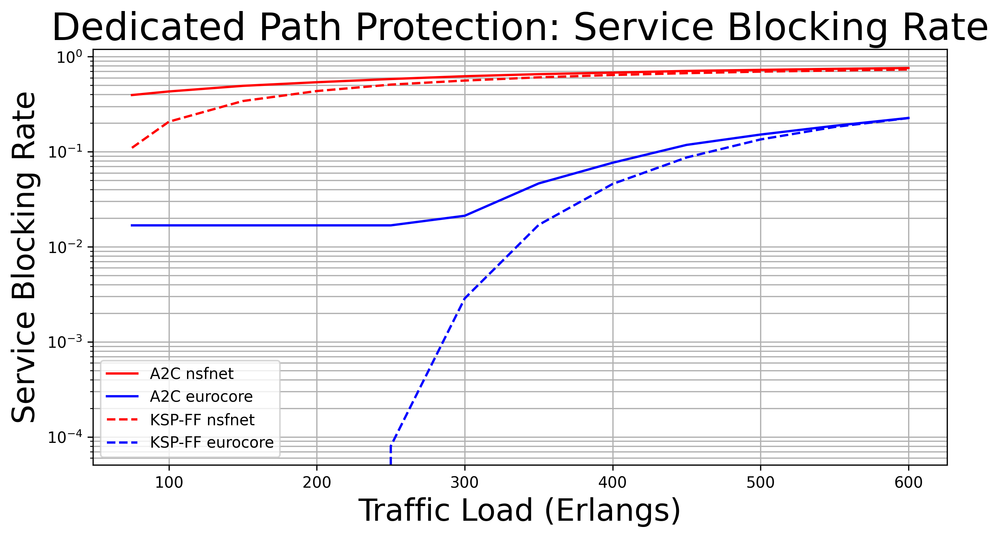

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

Matrix = [7.5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]

means_bit_rate_a2c_nsfnet = []
means_episode_a2c_nsfnet = []


for i in Matrix: 
  df=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-{}-nsfnet/testing.monitor.csv'.format(i),header=1)
  means_bit_rate_a2c_nsfnet.append(df.bit_rate_blocking_rate.mean())
  means_episode_a2c_nsfnet.append(df.episode_service_blocking_rate.mean())

  
print(means_bit_rate_a2c_nsfnet)
print(means_episode_a2c_nsfnet)

means_bit_rate_a2c_eurocore = []
means_episode_a2c_eurocore = []


for i in Matrix: 
  df_2=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-{}-eurocore/testing.monitor.csv'.format(i),header=1)
  means_bit_rate_a2c_eurocore.append(df_2.bit_rate_blocking_rate.mean())
  means_episode_a2c_eurocore.append(df_2.episode_service_blocking_rate.mean())


print(means_bit_rate_a2c_eurocore)
print(means_episode_a2c_eurocore)

means_bit_rate_a2c_new_topology = []
means_episode_a2c_new_topology = []


for i in Matrix: 
  df_3=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-{}-new_topology/testing.monitor.csv'.format(i),header=1)
  means_bit_rate_a2c_new_topology.append(df_3.bit_rate_blocking_rate.mean())
  means_episode_a2c_new_topology.append(df_3.episode_service_blocking_rate.mean())


print(means_bit_rate_a2c_new_topology)
print(means_episode_a2c_new_topology)



means_bit_rate_heuristics_nsfnet_sp_ff = []
means_episode_heuristics_nsfnet_sp_ff = []


for i in Matrix:
  df_4 = pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/heuristics-{}-nsfnet/sp_ff.monitor.csv'.format(i),header=1)
  means_bit_rate_heuristics_nsfnet_sp_ff.append(df_4.bit_rate_blocking_rate.mean())
  means_episode_heuristics_nsfnet_sp_ff.append(df_4.episode_service_blocking_rate.mean())  



means_bit_rate_heuristics_eurocore_sp_ff = []
means_episode_heuristics_eurocore_sp_ff = []


for i in Matrix:
  df_5 = pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/heuristics-{}-eurocore/sp_ff.monitor.csv'.format(i),header=1)
  means_bit_rate_heuristics_eurocore_sp_ff.append(df_5.bit_rate_blocking_rate.mean())
  means_episode_heuristics_eurocore_sp_ff.append(df_5.episode_service_blocking_rate.mean())  



means_bit_rate_heuristics_new_topology_sp_ff = []
means_episode_heuristics_new_topology_sp_ff = []


for i in Matrix:
  df_6 = pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/heuristics-{}-new_topology/sp_ff.monitor.csv'.format(i),header=1)
  means_bit_rate_heuristics_new_topology_sp_ff.append(df_6.bit_rate_blocking_rate.mean())
  means_episode_heuristics_new_topology_sp_ff.append(df_6.episode_service_blocking_rate.mean())  






Loads = []
for i in Matrix:
  Loads.append(i*10)


plt.figure(figsize=(10, 5), dpi = 300)


y_10 = means_bit_rate_a2c_nsfnet

y_20 = means_bit_rate_a2c_eurocore

#y_30 = means_bit_rate_a2c_new_topology

y_11 = means_bit_rate_heuristics_nsfnet_sp_ff

y_21 = means_bit_rate_heuristics_eurocore_sp_ff

#y_31 = means_bit_rate_heuristics_new_topology_sp_ff



plt.plot(Loads,y_10,'r', linewidth = 1.5)
plt.plot(Loads, y_20, 'b', linewidth = 1.5)
#plt.plot(Loads, y_30, 'g', linewidth = 1.5)
plt.plot(Loads,y_11, 'r--', linewidth = 1.5)
plt.plot(Loads,y_21, 'b--', linewidth = 1.5)
#plt.plot(Loads,y_31, 'g--', linewidth = 1.5)



plt.yscale("log")
plt.grid(axis='y', which = 'both')
plt.grid(axis='x', which='both')
plt.title(("Dedicated Path Protection: Bit Blocking Rate"), fontsize = 25)

plt.xlabel(("Traffic Load (Erlangs)"), fontsize = 20)
plt.ylabel(("Blocking Probability (for bits)"), fontsize = 20)

plt.gca().legend(('A2C nsfnet', 'A2C eurocore', 'A2C new_topology', 'KSP-FF nsfnet', 'KSP-FF eurocore', 'KSP-FF new_topology'))
images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results/'
plt.savefig(f"{images_dir}comparisonheuristics_all_BBR.png")
plt.show()


y_40 = means_episode_a2c_nsfnet

y_50 = means_episode_a2c_eurocore

#y_60 = means_episode_a2c_new_topology

y_41 = means_episode_heuristics_nsfnet_sp_ff

y_51 = means_episode_heuristics_eurocore_sp_ff

#y_61 = means_episode_heuristics_new_topology_sp_ff


plt.figure(figsize=(10, 5), dpi = 300)

plt.plot(Loads,y_40,'r', linewidth = 1.5)
plt.plot(Loads, y_50, 'b', linewidth = 1.5)
#plt.plot(Loads, y_60, 'g', linewidth = 1.5)
plt.plot(Loads,y_41,'r--', linewidth = 1.5)
plt.plot(Loads, y_51, 'b--', linewidth = 1.5)
#plt.plot(Loads, y_61, 'g--', linewidth = 1.5)


plt.yscale("log")
plt.grid(axis='y', which = 'both')
plt.grid(axis='x', which='both')
plt.title(("Dedicated Path Protection: Service Blocking Rate"), fontsize = 25)

plt.xlabel(("Traffic Load (Erlangs)"), fontsize = 20)
plt.ylabel(("Service Blocking Rate"), fontsize = 20)

plt.gca().legend(('A2C nsfnet', 'A2C eurocore',  'KSP-FF nsfnet', 'KSP-FF eurocore')) # 'A2C new_topology', 'KSP-FF new_topology'

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results/'
plt.savefig(f"{images_dir}comparisonheuristics_all_SBR.png")
plt.show()

# NSFNET Plotting results

Plotting the A2C compared to Heuristics for Episode Service Blocking Rate

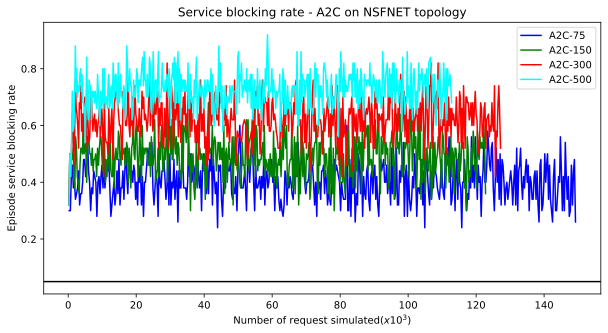

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(10,5))

df=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/deeprmsa-a2c-50/deeprmsa-a2c-50-7.5-nsfnet/testing.monitor.csv',header=1)
x = df.t
y = df.episode_service_blocking_rate
plt.plot(x, y, 'b')

df_1=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/deeprmsa-a2c-50/deeprmsa-a2c-50-15-nsfnet/testing.monitor.csv',header=1)
x_1 = df_1.t
y_1 = df_1.episode_service_blocking_rate
plt.plot(x_1, y_1, 'g')

df_2=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/deeprmsa-a2c-50/deeprmsa-a2c-50-30-nsfnet/testing.monitor.csv',header=1)
x_2 = df_2.t
y_2 = df_2.episode_service_blocking_rate
plt.plot(x_2, y_2, 'r')

df_3=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/deeprmsa-a2c-50/deeprmsa-a2c-50-50-nsfnet/testing.monitor.csv',header=1)
x_3 = df_3.t
y_3 = df_3.episode_service_blocking_rate
plt.plot(x_3, y_3, 'cyan')


plt.xlabel("Number of request simulated" + '$(x10^3)$') 
plt.ylabel("Episode service blocking rate") 
plt.title("Service blocking rate - A2C on NSFNET topology") 
plt.axhline(y=0.05, color='k', linestyle='-')
plt.gca().legend(( 'A2C-75','A2C-150','A2C-300','A2C-500'))
plt.show()

# ====================================
# ====================================
# Hyperparameter Tuning with Optuna
# ====================================
# ====================================

In [ ]:
!pip install optuna

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 365.3/365.3 KB 13.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 210.6/210.6 KB 26.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.7/78.7 KB 11.8 MB/s eta 0:00:00


In [ ]:
from stable_baselines3.common.evaluation import evaluate_policy

import optuna
import gym

def sample_a2c_params(trial:optuna.Trial):
  gamma = trial.suggest_categorical("gamma", [0.99, 0.95, 0.85, 0.5])
  learning_rate = trial.suggest_categorical("learning_rate", [5e-2, 5e-3, 1e-4, 1e-5, 1e-6, 1e-7])
  n_steps = trial.suggest_categorical("n_steps", [4, 16, 32, 128, 256, 512])
  vf_coef = trial.suggest_categorical("vf_coef", [0.05, 0.10, 0.25, 0.40, 0.5])
  ent_coef = trial.suggest_categorical("ent_coef", [0.05, 0.10, 0.25, 0.40, 0.5])

  return {"gamma": gamma,
          "learning_rate": learning_rate,
          "n_steps": n_steps,
          "vf_coef": vf_coef,
          "ent_coef": ent_coef}

def calculate_blocking(df):
  blocking = df.bit_rate_blocking_rate.mean()
  return blocking


In [ ]:
from optuna.visualization import plot_contour
from optuna.visualization import plot_edf
from optuna.visualization import plot_intermediate_values
from optuna.visualization import plot_optimization_history
from optuna.visualization import plot_parallel_coordinate
from optuna.visualization import plot_param_importances
from optuna.visualization import plot_slice

# NSFNET Optimization

In [ ]:
from stable_baselines3.a2c.policies import MlpPolicy

def objective(trial:optuna.Trial):

  hyperparameters = sample_a2c_params(trial)
  

  env_args = dict(topology=topology, seed=10, 
                  allow_rejection=False, # the agent cannot proactively reject a request
                  j=1, # consider only the first suitable spectrum block for the spectrum assignment
                  mean_service_holding_time=20, # value is not set as in the paper to achieve comparable reward values
                  episode_length=50, node_request_probabilities=node_request_probabilities, num_spectrum_resources = 358)

  # Create log dir
  log_dir = "/content/drive/MyDrive/optical-rl-gym-Modif/tmp/deeprmsa-a2c-optuna/nsfnet/"

  os.makedirs(log_dir, exist_ok=True)
  callback = SaveOnBestTrainingRewardCallback(check_freq=50, log_dir=log_dir)

  env = gym.make('DeepRMSADPP-v0', **env_args)

  policy_kwargs = dict(net_arch=5*[128])

  model = A2C('MlpPolicy', env, verbose=0, policy_kwargs=policy_kwargs, **hyperparameters,  tensorboard_log="/content/drive/MyDrive/optical-rl-gym-Modif/tb/A2C-50-DeepRMSA-v0/")
  model.learn(total_timesteps=50000)

  testing_env = gym.make('DeepRMSADPP-v0', **env_args)

  # Logs will be saved in log_dir/monitor.csv
  testing_env = Monitor(testing_env, log_dir + 'optuna', info_keywords=('episode_service_blocking_rate','bit_rate_blocking_rate','failure', 'episode_failure',
                      'failure_slots','episode_failure_slots', 
                      'failure_disjointness','episode_failure_disjointness'))

  mean_reward, std_reward = evaluate_policy(model, testing_env, n_eval_episodes=1000)

  df=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/deeprmsa-a2c-optuna/nsfnet/optuna.monitor.csv',header=1) 

  return calculate_blocking(df)


study_name = "nsfnet_chen_eon"  # Unique identifier of the study.
storage_name = "sqlite:////content/drive/MyDrive/optical-rl-gym-Modif/tmp/deeprmsa-a2c-optuna/nsfnet/{}.db".format(study_name)

sampler = optuna.samplers.TPESampler(seed=42)
study = optuna.create_study(direction='minimize', sampler = sampler, pruner = optuna.pruners.HyperbandPruner(), study_name=study_name, storage=storage_name, load_if_exists=True)

study.optimize(objective, n_trials = 50, catch=(ValueError, ZeroDivisionError)) #If stops here, delete ZeroDivisionError

## Best trial for now: gamma = 0.5, kearning_rate = 0.0001, n_steps = 16, vf_coef = 0.4, ent_coef = 0.1
##                  {'gamma': 0.5, 'learning_rate': 0.0001, 'n_steps': 16, 'vf_coef': 0.4, 'ent_coef': 0.1}

[I 2023-01-17 14:20:24,295] Using an existing study with name 'nsfnet_chen_eon' instead of creating a new one.
[W 2023-01-17 14:20:50,066] Trial 102 failed because of the following error: KeyboardInterrupt()
Traceback (most recent call last):
  File "/usr/local/lib/python3.8/dist-packages/optuna/study/_optimize.py", line 196, in _run_trial
    value_or_values = func(trial)
  File "<ipython-input-20-f67b882f35d1>", line 25, in objective
    model.learn(total_timesteps=50000)
  File "/usr/local/lib/python3.8/dist-packages/stable_baselines3/a2c/a2c.py", line 193, in learn
    return super().learn(
  File "/usr/local/lib/python3.8/dist-packages/stable_baselines3/common/on_policy_algorithm.py", line 269, in learn
    self.train()
  File "/usr/local/lib/python3.8/dist-packages/stable_baselines3/a2c/a2c.py", line 128, in train
    self.policy.set_training_mode(True)
  File "/usr/local/lib/python3.8/dist-packages/stable_baselines3/common/policies.py", line 220, in set_training_mode
    self.tr

KeyboardInterrupt: ignored

In [ ]:
plot_parallel_coordinate(study)

In [ ]:
plot_param_importances(study)

In [ ]:
plot_edf(study)

In [ ]:
plot_optimization_history(study)

In [ ]:
plot_slice(study)

In [ ]:
print(study.best_trial.value)  # Show the best value.

0.5466019355291207


# Eurocore Optimization

In [ ]:
from stable_baselines3.a2c.policies import MlpPolicy

def objective(trial:optuna.Trial):

  hyperparameters = sample_a2c_params(trial)
  

  env_args = dict(topology=topology2, seed=10, 
                  allow_rejection=False, # the agent cannot proactively reject a request
                  j=1, # consider only the first suitable spectrum block for the spectrum assignment
                  mean_service_holding_time=50, # value is not set as in the paper to achieve comparable reward values
                  episode_length=50, node_request_probabilities=node_request_probabilities_eurocore, num_spectrum_resources = 358)

  # Create log dir
  log_dir = "/content/drive/MyDrive/optical-rl-gym-Modif/tmp/deeprmsa-a2c-optuna/eurocore/"

  os.makedirs(log_dir, exist_ok=True)
  callback = SaveOnBestTrainingRewardCallback(check_freq=50, log_dir=log_dir)

  env = gym.make('DeepRMSADPP-v0', **env_args)

  policy_kwargs = dict(net_arch=5*[128])

  model = A2C('MlpPolicy', env, verbose=0, policy_kwargs=policy_kwargs, **hyperparameters,  tensorboard_log="/content/drive/MyDrive/optical-rl-gym-Modif/tb/A2C-50-DeepRMSA-v0/")
  model.learn(total_timesteps=50000)

  testing_env = gym.make('DeepRMSADPP-v0', **env_args)

  # Logs will be saved in log_dir/monitor.csv
  testing_env = Monitor(testing_env, log_dir + 'optuna_eurocore', info_keywords=('episode_service_blocking_rate','bit_rate_blocking_rate','failure', 'episode_failure',
                      'failure_slots','episode_failure_slots', 
                      'failure_disjointness','episode_failure_disjointness'))

  mean_reward, std_reward = evaluate_policy(model, testing_env, n_eval_episodes=1000)

  df=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/deeprmsa-a2c-optuna/eurocore/optuna_eurocore.monitor.csv',header=1) 

  return calculate_blocking(df)

study_name_2 = topology_name_2  # Unique identifier of the study.
storage_name_2 = "sqlite:////content/drive/MyDrive/optical-rl-gym-Modif/tmp/deeprmsa-a2c-optuna/eurocore/{}.db".format(study_name_2)

sampler = optuna.samplers.TPESampler(seed=42)
study2 = optuna.create_study(direction='minimize', sampler = sampler, pruner = optuna.pruners.HyperbandPruner(), study_name=study_name_2, storage=storage_name_2, load_if_exists=True)

study2.optimize(objective, n_trials = 50, catch=(ValueError, ZeroDivisionError)) #If stops here, delete ZeroDivisionError


# {'gamma': 0.5, 'learning_rate': 0.0001, 'n_steps': 32, 'vf_coef': 0.25, 'ent_coef': 0.4} = Best parameters for best trial

[I 2023-01-18 14:57:17,935] Using an existing study with name 'eurocore_eon' instead of creating a new one.
/usr/local/lib/python3.8/dist-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.8/dist-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
[I 2023-01-18 15:08:49,547] Trial 25 finished with value: 0.1953248805941085 and parameters: {'gamma': 0.99, 'learning_rate': 1e-06, 'n_steps': 4, 'vf_coef': 0.1, 'ent_coef': 0.05}. Best is trial 1 with value: 0.1953248805941085.
[I 2023-01-18 15:18:40,912] Trial 26 finished with value: 0.1953248805941085 and parameters: {'gamma': 0.85, 'learning_rate': 1e-06, 'n_steps': 32, 'vf_coef': 0.1, 'ent_coef': 0.05}. Best is trial 1 with value: 0.1953248805941085.
[I 2023-01-18 15:29:41,539] Trial 27 finished with value: 0.1953248805941085 and parameters: {'gamma': 0.99,

KeyboardInterrupt: ignored

In [ ]:
plot_parallel_coordinate(study2)

In [ ]:
plot_param_importances(study2)

In [ ]:
plot_edf(study2)

In [ ]:
plot_optimization_history(study2)

In [ ]:
plot_slice(study2)

In [ ]:
print(study2.best_trial.value)  # Show the best value.

0.15607577034825698


# New Topology Optimization

In [ ]:
from stable_baselines3.a2c.policies import MlpPolicy

def objective(trial:optuna.Trial):

  hyperparameters = sample_a2c_params(trial)
  

  env_args = dict(topology=topology3, seed=10, 
                  allow_rejection=False, # the agent cannot proactively reject a request
                  j=1, # consider only the first suitable spectrum block for the spectrum assignment
                  mean_service_holding_time=40, # value is not set as in the paper to achieve comparable reward values
                  episode_length=50, node_request_probabilities=node_request_probabilities_new_topology, num_spectrum_resources = 358)

  # Create log dir
  log_dir = "/content/drive/MyDrive/optical-rl-gym-Modif/tmp/deeprmsa-a2c-optuna/new_topology/"

  os.makedirs(log_dir, exist_ok=True)
  callback = SaveOnBestTrainingRewardCallback(check_freq=50, log_dir=log_dir)

  env = gym.make('DeepRMSADPP-v0', **env_args)

  policy_kwargs = dict(net_arch=5*[128])

  model = A2C('MlpPolicy', env, verbose=0, policy_kwargs=policy_kwargs, **hyperparameters,  tensorboard_log="/content/drive/MyDrive/optical-rl-gym-Modif/tb/A2C-50-DeepRMSA-v0/")
  model.learn(total_timesteps=50000)

  testing_env = gym.make('DeepRMSADPP-v0', **env_args)

  # Logs will be saved in log_dir/monitor.csv
  testing_env = Monitor(testing_env, log_dir + 'optuna_new_topology', info_keywords=('episode_service_blocking_rate','bit_rate_blocking_rate','failure', 'episode_failure',
                      'failure_slots','episode_failure_slots', 
                      'failure_disjointness','episode_failure_disjointness'))

  mean_reward, std_reward = evaluate_policy(model, testing_env, n_eval_episodes=1000)

  df=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/deeprmsa-a2c-optuna/new_topology/optuna_new_topology.monitor.csv',header=1) 

  return calculate_blocking(df)

study_name_3 = topology_name_3  # Unique identifier of the study.
storage_name_3 = "sqlite:////content/drive/MyDrive/optical-rl-gym-Modif/tmp/deeprmsa-a2c-optuna/new_topology/{}.db".format(study_name_3)

sampler = optuna.samplers.TPESampler(seed=42)
study3 = optuna.create_study(direction='minimize', sampler = sampler, pruner = optuna.pruners.HyperbandPruner(), study_name=study_name_3, storage=storage_name_3, load_if_exists=True)

study3.optimize(objective, n_trials = 50, catch=(ValueError, ZeroDivisionError)) #If stops here, delete ZeroDivisionError

# {'gamma': 0.5, 'learning_rate': 0.0001, 'n_steps': 16, 'vf_coef': 0.1, 'ent_coef': 0.05}

[I 2023-01-24 10:47:19,077] Using an existing study with name 'new_topology_eon' instead of creating a new one.
/usr/local/lib/python3.8/dist-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.8/dist-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
[I 2023-01-24 10:55:25,973] Trial 48 finished with value: 0.4372840919974459 and parameters: {'gamma': 0.99, 'learning_rate': 1e-06, 'n_steps': 32, 'vf_coef': 0.4, 'ent_coef': 0.5}. Best is trial 27 with value: 0.43244198648419274.
[I 2023-01-24 11:03:09,218] Trial 49 finished with value: 0.48560836047521827 and parameters: {'gamma': 0.95, 'learning_rate': 1e-07, 'n_steps': 16, 'vf_coef': 0.1, 'ent_coef': 0.4}. Best is trial 27 with value: 0.43244198648419274.
[I 2023-01-24 11:12:14,454] Trial 50 finished with value: 0.4372840919974459 and parameters: {'gamma

KeyboardInterrupt: ignored

In [ ]:
plot_parallel_coordinate(study3)

In [ ]:
plot_param_importances(study3)

In [ ]:
plot_edf(study3)

In [ ]:
plot_optimization_history(study3)

In [ ]:
plot_slice(study3)

In [ ]:
print(study3.best_trial.value)  # Show the best value.

0.43244198648419274


# Hyperparameters tuning training and comparison

### NSFNET

/usr/local/lib/python3.8/dist-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning:

Mean of empty slice.

/usr/local/lib/python3.8/dist-packages/numpy/core/_methods.py:189: RuntimeWarning:

invalid value encountered in double_scalars



mean_reward:-25.32 +/- 6.53


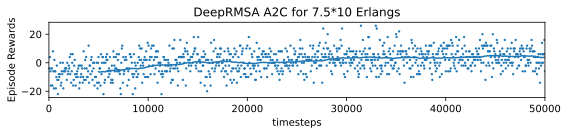

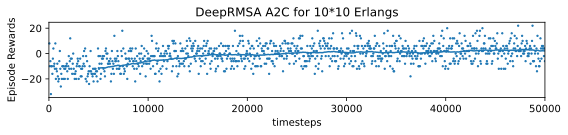

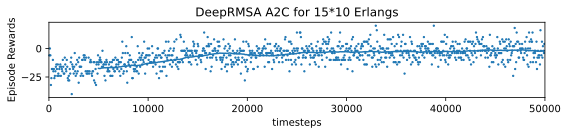

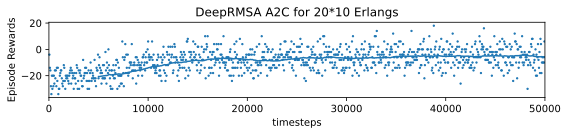

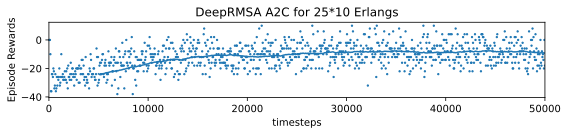

...

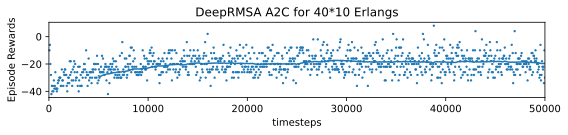

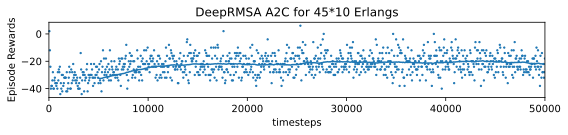

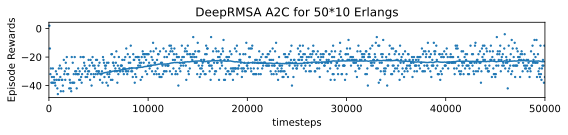

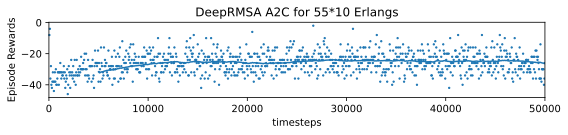

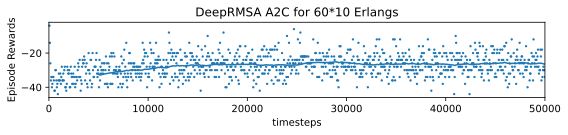

In [ ]:
from stable_baselines3.a2c.policies import MlpPolicy

for ht in [7.5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]:

  # mean_service_holding_time varying between 7.5 and 60,
  env_args = dict(topology=topology, seed=10, 
                allow_rejection=False, # the agent cannot proactively reject a request
                j=1, # consider only the first suitable spectrum block for the spectrum assignment
                mean_service_holding_time=ht, # value is not set as in the paper to achieve comparable reward values
                episode_length=50, node_request_probabilities=node_request_probabilities, num_spectrum_resources = 358)
  
  # Create log dir
  log_dir = "/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-{}-nsfnet_tuned/".format(ht)
  os.makedirs(log_dir, exist_ok=True)
  callback = SaveOnBestTrainingRewardCallback(check_freq=100, log_dir=log_dir)

  env = gym.make('DeepRMSADPP-v0', **env_args)

  # logs will be saved in log_dir/monitor.csv
  # in this case, on top of the usual monitored things, we also monitor service and bit rate blocking probabilities
  env = Monitor(env, log_dir + 'training', info_keywords=('episode_service_blocking_rate', 'bit_rate_blocking_rate', 'failure', 'episode_failure',
                    'failure_slots','episode_failure_slots', 
                    'failure_disjointness','episode_failure_disjointness'))

  policy_args = dict(net_arch=5*[128])#, act_fun=tf.nn.elu) # the neural network has four layers with 150 neurons each

  agent = A2C(MlpPolicy, env, verbose=0, tensorboard_log="/content/drive/MyDrive/optical-rl-gym-Modif/tb/A2C-50-DeepRMSA-v0/", policy_kwargs=policy_args, gamma=0.5 , learning_rate=1e-4, n_steps=16, vf_coef=0.4,  ent_coef=0.1)

  a = agent.learn(total_timesteps=50000, callback=callback)

  from stable_baselines3.common import results_plotter

  results_plotter.plot_results([log_dir], 1e10, results_plotter.X_TIMESTEPS, "DeepRMSA A2C for {}*10 Erlangs".format(ht))

  from stable_baselines3.common.evaluation import evaluate_policy

  testing_env = gym.make('DeepRMSADPP-v0', **env_args)

  # Logs will be saved in log_dir/monitor.csv
  testing_env = Monitor(testing_env, log_dir + 'testing', info_keywords=('episode_service_blocking_rate', 'bit_rate_blocking_rate','failure', 'episode_failure',
                    'failure_slots','episode_failure_slots', 
                    'failure_disjointness','episode_failure_disjointness'))

  # Evaluate the trained agent
  mean_reward, std_reward = evaluate_policy(a, testing_env, n_eval_episodes=500)

  print(f"mean_reward:{mean_reward:.2f} +/- {std_reward:.2f}")


### Eurocore

/usr/local/lib/python3.8/dist-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.8/dist-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


mean_reward:27.48 +/- 8.38


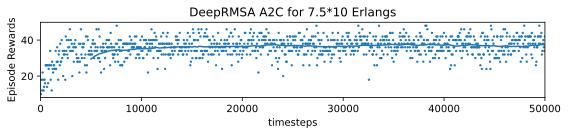

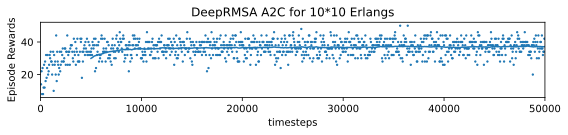

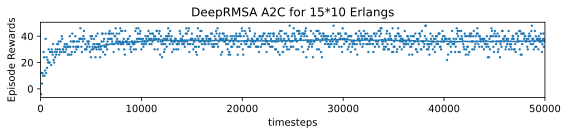

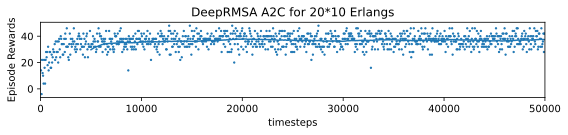

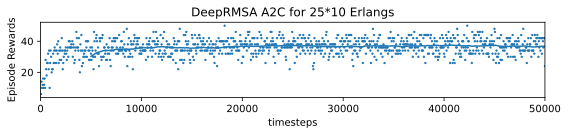

...

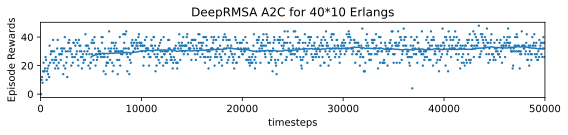

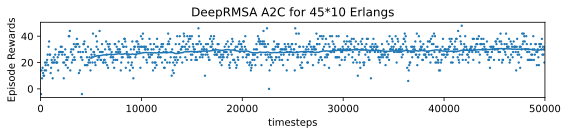

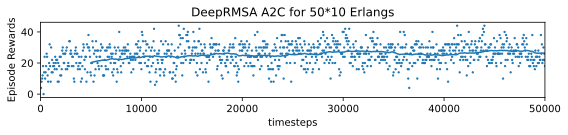

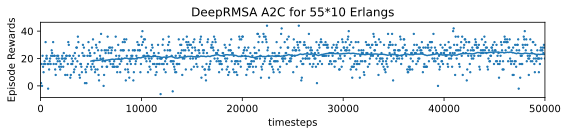

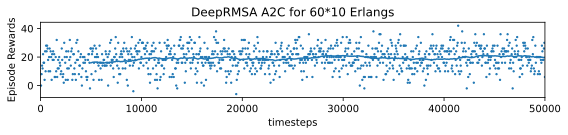

In [ ]:
from stable_baselines3.a2c.policies import MlpPolicy

for ht in [7.5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]:

  # mean_service_holding_time varying between 7.5 and 60,
  env_args = dict(topology=topology2, seed=10, 
                allow_rejection=False, # the agent cannot proactively reject a request
                j=1, # consider only the first suitable spectrum block for the spectrum assignment
                mean_service_holding_time=ht, # value is not set as in the paper to achieve comparable reward values
                episode_length=50, node_request_probabilities=node_request_probabilities_eurocore, num_spectrum_resources = 358)
  
  # Create log dir
  log_dir = "/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-{}-eurocore_tuned/".format(ht)
  os.makedirs(log_dir, exist_ok=True)
  callback = SaveOnBestTrainingRewardCallback(check_freq=100, log_dir=log_dir)

  env = gym.make('DeepRMSADPP-v0', **env_args)

  # logs will be saved in log_dir/monitor.csv
  # in this case, on top of the usual monitored things, we also monitor service and bit rate blocking probabilities
  env = Monitor(env, log_dir + 'training', info_keywords=('episode_service_blocking_rate', 'bit_rate_blocking_rate', 'failure', 'episode_failure',
                    'failure_slots','episode_failure_slots', 
                    'failure_disjointness','episode_failure_disjointness'))

  policy_args = dict(net_arch=5*[128])#, act_fun=tf.nn.elu) # the neural network has four layers with 150 neurons each

  agent = A2C(MlpPolicy, env, verbose=0, tensorboard_log="/content/drive/MyDrive/optical-rl-gym-Modif/tb/A2C-50-DeepRMSA-v0/", policy_kwargs=policy_args, gamma=0.5 , learning_rate=0.0001, n_steps=32, vf_coef=0.25,  ent_coef=0.4)

  a = agent.learn(total_timesteps=50000, callback=callback)

  from stable_baselines3.common import results_plotter

  results_plotter.plot_results([log_dir], 1e10, results_plotter.X_TIMESTEPS, "DeepRMSA A2C for {}*10 Erlangs".format(ht))

  from stable_baselines3.common.evaluation import evaluate_policy

  testing_env = gym.make('DeepRMSADPP-v0', **env_args)

  # Logs will be saved in log_dir/monitor.csv
  testing_env = Monitor(testing_env, log_dir + 'testing', info_keywords=('episode_service_blocking_rate', 'bit_rate_blocking_rate','failure', 'episode_failure',
                    'failure_slots','episode_failure_slots', 
                    'failure_disjointness','episode_failure_disjointness'))

  # Evaluate the trained agent
  mean_reward, std_reward = evaluate_policy(a, testing_env, n_eval_episodes=500)

  print(f"mean_reward:{mean_reward:.2f} +/- {std_reward:.2f}")


### New_topology

/usr/local/lib/python3.8/dist-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.8/dist-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


mean_reward:-1.39 +/- 7.45


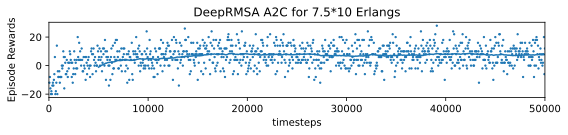

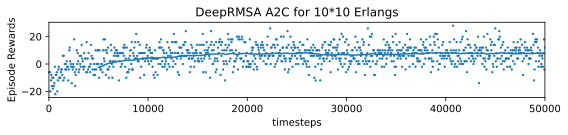

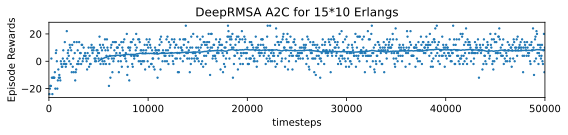

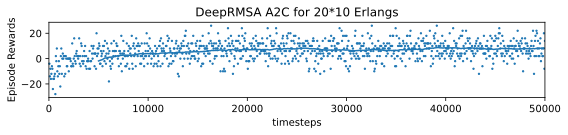

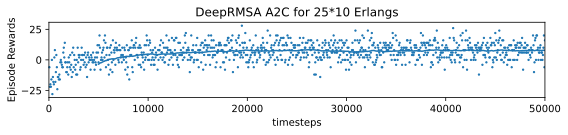

...

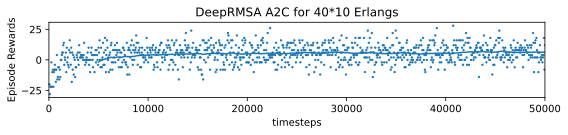

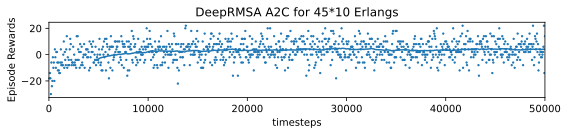

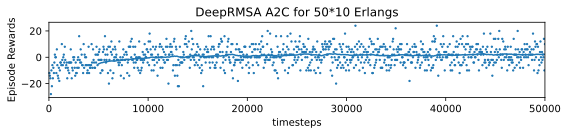

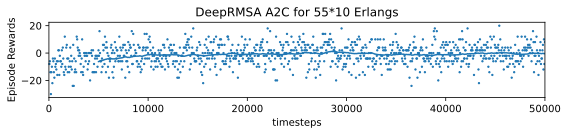

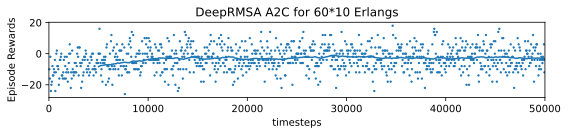

In [ ]:
from stable_baselines3.a2c.policies import MlpPolicy

for ht in [7.5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]:

  # mean_service_holding_time varying between 7.5 and 60,
  env_args = dict(topology=topology3, seed=10, 
                allow_rejection=False, # the agent cannot proactively reject a request
                j=1, # consider only the first suitable spectrum block for the spectrum assignment
                mean_service_holding_time=ht, # value is not set as in the paper to achieve comparable reward values
                episode_length=50, node_request_probabilities=node_request_probabilities_new_topology, num_spectrum_resources = 358)
  
  # Create log dir
  log_dir = "/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-{}-new_topology_tuned/".format(ht)
  os.makedirs(log_dir, exist_ok=True)
  callback = SaveOnBestTrainingRewardCallback(check_freq=100, log_dir=log_dir)

  env = gym.make('DeepRMSADPP-v0', **env_args)

  # logs will be saved in log_dir/monitor.csv
  # in this case, on top of the usual monitored things, we also monitor service and bit rate blocking probabilities
  env = Monitor(env, log_dir + 'training', info_keywords=('episode_service_blocking_rate', 'bit_rate_blocking_rate', 'failure', 'episode_failure',
                    'failure_slots','episode_failure_slots', 
                    'failure_disjointness','episode_failure_disjointness'))

  policy_args = dict(net_arch=5*[128])#, act_fun=tf.nn.elu) # the neural network has four layers with 150 neurons each

  agent = A2C(MlpPolicy, env, verbose=0, tensorboard_log="/content/drive/MyDrive/optical-rl-gym-Modif/tb/A2C-50-DeepRMSA-v0/", policy_kwargs=policy_args, gamma=0.5 , learning_rate=1e-4, n_steps=16, vf_coef=0.1,  ent_coef=0.05)
                                                                                                                            
  a = agent.learn(total_timesteps=50000, callback=callback)

  from stable_baselines3.common import results_plotter

  results_plotter.plot_results([log_dir], 1e10, results_plotter.X_TIMESTEPS, "DeepRMSA A2C for {}*10 Erlangs".format(ht))

  from stable_baselines3.common.evaluation import evaluate_policy

  testing_env = gym.make('DeepRMSADPP-v0', **env_args)

  # Logs will be saved in log_dir/monitor.csv
  testing_env = Monitor(testing_env, log_dir + 'testing', info_keywords=('episode_service_blocking_rate', 'bit_rate_blocking_rate','failure', 'episode_failure',
                    'failure_slots','episode_failure_slots', 
                    'failure_disjointness','episode_failure_disjointness'))

  # Evaluate the trained agent
  mean_reward, std_reward = evaluate_policy(a, testing_env, n_eval_episodes=500)

  print(f"mean_reward:{mean_reward:.2f} +/- {std_reward:.2f}")


### Plots

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

Matrix = [7.5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]

means_bit_rate_a2c_nsfnet = []
means_episode_a2c_nsfnet = []

for i in Matrix: 
  df=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-{}-nsfnet/testing.monitor.csv'.format(i),header=1)
  means_bit_rate_a2c_nsfnet.append(df.bit_rate_blocking_rate.mean())
  means_episode_a2c_nsfnet.append(df.episode_service_blocking_rate.mean())
  
print(means_bit_rate_a2c_nsfnet)
print(means_episode_a2c_nsfnet)

means_bit_rate_a2c_eurocore = []
means_episode_a2c_eurocore = []

for i in Matrix: 
  df_2=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-{}-eurocore/testing.monitor.csv'.format(i),header=1)
  means_bit_rate_a2c_eurocore.append(df_2.bit_rate_blocking_rate.mean())
  means_episode_a2c_eurocore.append(df_2.episode_service_blocking_rate.mean())

print(means_bit_rate_a2c_eurocore)
print(means_episode_a2c_eurocore)

means_bit_rate_a2c_new_topology = []
means_episode_a2c_new_topology = []


for i in Matrix: 
  df_3=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-{}-new_topology/testing.monitor.csv'.format(i),header=1)
  means_bit_rate_a2c_new_topology.append(df_3.bit_rate_blocking_rate.mean())
  means_episode_a2c_new_topology.append(df_3.episode_service_blocking_rate.mean())

print(means_bit_rate_a2c_new_topology)
print(means_episode_a2c_new_topology)



means_bit_rate_heuristics_nsfnet_sp_ff = []
means_episode_heuristics_nsfnet_sp_ff = []


for i in Matrix:
  df_4 = pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/heuristics-{}-nsfnet/sp_ff.monitor.csv'.format(i),header=1)
  means_bit_rate_heuristics_nsfnet_sp_ff.append(df_4.bit_rate_blocking_rate.mean())
  means_episode_heuristics_nsfnet_sp_ff.append(df_4.episode_service_blocking_rate.mean())  


means_bit_rate_heuristics_eurocore_sp_ff = []
means_episode_heuristics_eurocore_sp_ff = []


for i in Matrix:
  df_5 = pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/heuristics-{}-eurocore/sp_ff.monitor.csv'.format(i),header=1)
  means_bit_rate_heuristics_eurocore_sp_ff.append(df_5.bit_rate_blocking_rate.mean())
  means_episode_heuristics_eurocore_sp_ff.append(df_5.episode_service_blocking_rate.mean())  



means_bit_rate_heuristics_new_topology_sp_ff = []
means_episode_heuristics_new_topology_sp_ff = []


for i in Matrix:
  df_6 = pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/heuristics-{}-new_topology/sp_ff.monitor.csv'.format(i),header=1)
  means_bit_rate_heuristics_new_topology_sp_ff.append(df_6.bit_rate_blocking_rate.mean())
  means_episode_heuristics_new_topology_sp_ff.append(df_6.episode_service_blocking_rate.mean())  



means_bit_rate_a2c_nsfnet_tuned = []
means_episode_a2c_nsfnet_tuned = []


means_bit_rate_a2c_eurocore_tuned = []
means_episode_a2c_eurocore_tuned = []


means_bit_rate_a2c_newt_tuned = []
means_episode_a2c_newt_tuned = []


for i in Matrix:
  df_7 = pd.read_csv("/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-{}-nsfnet_tuned/testing.monitor.csv".format(i), header=1)
  df_8 = pd.read_csv("/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-{}-eurocore_tuned/testing.monitor.csv".format(i), header = 1)
  df_9 = pd.read_csv("/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-{}-new_topology_tuned/testing.monitor.csv".format(i), header=1)

  means_bit_rate_a2c_nsfnet_tuned.append(df_7.bit_rate_blocking_rate.mean())
  means_episode_a2c_nsfnet_tuned.append(df_7.episode_service_blocking_rate.mean()) 

  means_bit_rate_a2c_eurocore_tuned.append(df_8.bit_rate_blocking_rate.mean())
  means_episode_a2c_eurocore_tuned.append(df_8.episode_service_blocking_rate.mean())  

  means_bit_rate_a2c_newt_tuned.append(df_9.bit_rate_blocking_rate.mean())
  means_episode_a2c_newt_tuned.append(df_9.episode_service_blocking_rate.mean())  
  



Loads = []
for i in Matrix:
  Loads.append(i*10)


plt.figure(figsize=(10,5), dpi = 300)


y_10 = means_bit_rate_a2c_nsfnet

y_20 = means_bit_rate_a2c_eurocore

y_30 = means_bit_rate_a2c_new_topology

y_11 = means_bit_rate_heuristics_nsfnet_sp_ff

y_21 = means_bit_rate_heuristics_eurocore_sp_ff

y_31 = means_bit_rate_heuristics_new_topology_sp_ff

y_12 = means_bit_rate_a2c_nsfnet_tuned

y_22 = means_bit_rate_a2c_eurocore_tuned

y_32 = means_bit_rate_a2c_newt_tuned



plt.plot(Loads,y_10,'r', linewidth = 1.5)
plt.plot(Loads, y_20, 'b', linewidth = 1.5)
#plt.plot(Loads, y_30, 'g', linewidth = 1.5)
plt.plot(Loads,y_12, 'r.-', linewidth = 1.5)
plt.plot(Loads,y_22, 'b.-', linewidth = 1.5)
#plt.plot(Loads,y_32, 'g.-', linewidth = 1.5)
plt.plot(Loads,y_11, 'r--', linewidth = 1.5)
plt.plot(Loads,y_21, 'b--', linewidth = 1.5)
#plt.plot(Loads,y_31, 'g--', linewidth = 1.5)



plt.yscale("log")
plt.grid(axis='y', which = 'both')
plt.grid(axis='x', which='both')
plt.title(("Dedicated Path Protection: Bit rate blocking rate"), fontsize = 28)

plt.xlabel(("Traffic Load (Erlangs)"), fontsize = 20)
plt.ylabel(("Blocking Probability (for bits)"), fontsize = 20)

plt.gca().legend(('A2C nsfnet', 'A2C eurocore',  'A2C nsfnet tuned', 'A2C eurocore tuned',  'KSP-FF nsfnet', 'KSP-FF eurocore', ))
#'A2C new_topology',
#'A2C new_topology tuned',
#'KSP-FF new_topology'
images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results/'
plt.savefig(f"{images_dir}comparisonheuristics_tuning_all_BBR.png")
plt.show()


y_40 = means_episode_a2c_nsfnet

y_50 = means_episode_a2c_eurocore

y_60 = means_episode_a2c_new_topology

y_41 = means_episode_heuristics_nsfnet_sp_ff

y_51 = means_episode_heuristics_eurocore_sp_ff

y_61 = means_episode_heuristics_new_topology_sp_ff

y_42 = means_episode_a2c_nsfnet_tuned

y_52 = means_episode_a2c_eurocore_tuned

y_62 = means_episode_a2c_newt_tuned


plt.figure(figsize=(10,5), dpi = 300)

plt.plot(Loads,y_40,'r', linewidth = 1.5)
plt.plot(Loads, y_50, 'b', linewidth = 1.5)
#plt.plot(Loads, y_60, 'g', linewidth = 1.5)
plt.plot(Loads,y_42,'r.-', linewidth = 1.5)
plt.plot(Loads, y_52, 'b.-', linewidth = 1.5)
#plt.plot(Loads, y_62, 'g.-', linewidth = 1.5)
plt.plot(Loads,y_41,'r--', linewidth = 1.5)
plt.plot(Loads, y_51, 'b--', linewidth = 1.5)
#plt.plot(Loads, y_61, 'g--', linewidth = 1.5)


plt.yscale("log")
plt.grid(axis='y', which = 'both')
plt.grid(axis='x', which='both')
plt.title(("Dedicated Path Protection: service blocking rate"), fontsize = 28)

plt.xlabel(("Traffic Load (Erlangs)"), fontsize = 20)
plt.ylabel(("Service Blocking Rate"), fontsize = 20)

plt.gca().legend(('A2C nsfnet', 'A2C eurocore',  'A2C nsfnet tuned', 'A2C eurocore tuned',  'KSP-FF nsfnet', 'KSP-FF eurocore',))
#'A2C new_topology', 
#'A2C new_topology tuned',
#'KSP-FF new_topology'

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results/'
plt.savefig(f"{images_dir}comparisonheuristics_tuned_all_SBR.png")
plt.show()



plt.figure(figsize=(10,5), dpi = 300)

plt.plot(Loads,y_10, linestyle='-', color='deepskyblue', marker='+', linewidth = 1.5) #"mcolor:",
plt.plot(Loads,y_12, linestyle='-.', color='blueviolet', marker='x', linewidth = 1.5)
plt.plot(Loads,y_11, linestyle='--', color='deeppink', marker='.', linewidth = 1.5)

plt.yscale("log")
plt.grid(axis='y', which = 'both')
plt.grid(axis='x', which='both')
plt.title(("Dedicated Path Protection: BBR for nsfnet topology"), fontsize = 24)

plt.xlabel(("Traffic Load (Erlangs)"), fontsize = 20)
plt.ylabel(("Bit Blocking Rate"), fontsize = 20)
plt.gca().legend(('A2C nsfnet',  'A2C nsfnet tuned', 'KSP-FF nsfnet'))

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results/'
plt.savefig(f"{images_dir}comparisonheuristics_tuned_nsfnet_BBR.png")
plt.show()



plt.figure(figsize=(10,5), dpi = 300)

plt.plot(Loads,y_40, linestyle='-', color='deepskyblue', marker='+', linewidth = 1.5)
plt.plot(Loads,y_42, linestyle='-.', color='blueviolet', marker='x', linewidth = 1.5)
plt.plot(Loads,y_41, linestyle='--', color='deeppink', marker='.', linewidth = 1.5)

plt.yscale("log")
plt.grid(axis='y', which = 'both')
plt.grid(axis='x', which='both')
plt.title(("Dedicated Path Protection: SBR for nsfnet topology"), fontsize = 28)

plt.xlabel(("Traffic Load (Erlangs)"), fontsize = 20)
plt.ylabel(("Service Blocking Rate"), fontsize = 20)
plt.gca().legend(('A2C nsfnet',  'A2C nsfnet tuned', 'KSP-FF nsfnet'))

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results/'
plt.savefig(f"{images_dir}comparisonheuristics_tuned_nsfnet_SBR.png")
plt.show()




plt.figure(figsize=(10,5), dpi = 300)

plt.plot(Loads,y_20,linestyle='-', color='dodgerblue', marker='+', linewidth = 1.5)
plt.plot(Loads,y_22, linestyle='-.', color='tomato', marker='x', linewidth = 1.5)
plt.plot(Loads,y_21, linestyle='--', color='slategray', marker='.', linewidth = 1.5)

plt.yscale("log")
plt.grid(axis='y', which = 'both')
plt.grid(axis='x', which='both')
plt.title(("Dedicated Path Protection: BBR for eurocore topology"), fontsize = 24)

plt.xlabel(("Traffic Load (Erlangs)"), fontsize = 20)
plt.ylabel(("Bit Blocking Rate"), fontsize = 20)
plt.gca().legend(('A2C eurocore',  'A2C eurocore tuned', 'KSP-FF eurocore'))

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results/'
plt.savefig(f"{images_dir}comparisonheuristics_tuned_eurocore_BBR.png")
plt.show()



plt.figure(figsize=(10,5), dpi = 300)

plt.plot(Loads,y_50,linestyle='-', color='dodgerblue', marker='+', linewidth = 1.5)
plt.plot(Loads,y_52, linestyle='-.', color='tomato', marker='x', linewidth = 1.5)
plt.plot(Loads,y_51, linestyle='--', color='slategray', marker='.', linewidth = 1.5)

plt.yscale("log")
plt.grid(axis='y', which = 'both')
plt.grid(axis='x', which='both')
plt.title(("Dedicated Path Protection: SBR for eurocore topology"), fontsize = 28)

plt.xlabel(("Traffic Load (Erlangs)"), fontsize = 20)
plt.ylabel(("Service Blocking Rate"), fontsize = 20)
plt.gca().legend(('A2C eurocore',  'A2C eurocore tuned', 'KSP-FF eurocore'))

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results/'
plt.savefig(f"{images_dir}comparisonheuristics_tuned_eurocore_SBR.png")
plt.show()


plt.figure(figsize=(10,5), dpi = 300)

plt.plot(Loads,y_20, linestyle='-', color='orangered', marker='+', linewidth = 1.5)
plt.plot(Loads,y_22, linestyle='-.', color='olivedrab', marker='x', linewidth = 1.5)
plt.plot(Loads,y_21, linestyle='--', color='darkolivegreen', marker='.', linewidth = 1.5)

plt.yscale("log")
plt.grid(axis='y', which = 'both')
plt.grid(axis='x', which='both')
plt.title(("Dedicated Path Protection: BBR for new topology"), fontsize = 28)

plt.xlabel(("Traffic Load (Erlangs)"), fontsize = 20)
plt.ylabel(("Bit Blocking Rate"), fontsize = 20)
plt.gca().legend(('A2C new_topology',  'A2C new_topology tuned', 'KSP-FF new_topology'))

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results/'
plt.savefig(f"{images_dir}comparisonheuristics_tuned_new_topology_BBR.png")
plt.show()



plt.figure(figsize=(10,5), dpi = 300)

plt.plot(Loads,y_50, linestyle='-', color='orangered', marker='+', linewidth = 1.5)
plt.plot(Loads,y_52, linestyle='-.', color='olivedrab', marker='x', linewidth = 1.5)
plt.plot(Loads,y_51, linestyle='-.', color='darkolivegreen', marker='.', linewidth = 1.5)

plt.yscale("log")
plt.grid(axis='y', which = 'both')
plt.grid(axis='x', which='both')
plt.title(("Dedicated Path Protection: SBR for new topology"), fontsize = 28)

plt.xlabel(("Traffic Load (Erlangs)"), fontsize = 20)
plt.ylabel(("Service Blocking Rate"), fontsize = 20)
plt.gca().legend(('A2C new_topology',  'A2C new_topology tuned', 'KSP-FF new_topology'))

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results/'
plt.savefig(f"{images_dir}comparisonheuristics_tuned_new_topology_SBR.png")
plt.show()


Output hidden; open in https://colab.research.google.com to view.

# =================================
# Explainability Part
# =================================

## Explaining the results of the agents with logic (right terms employed?)

Must do: analyze the code to see how the agent chooses path, see how the choice influate on the results, etc...

# Failure causes for each topology 

[0.40586095313943443, 0.44495422016617636, 0.5109970197849039, 0.558668817079142, 0.6003982269249866, 0.6450488546083967, 0.6762882129146958, 0.7025989803048074, 0.7319491846308284, 0.7481123753426725, 0.7659687744409497, 0.7824787976686493]
[0.3948, 0.43060000000000004, 0.49344000000000005, 0.5385599999999999, 0.582, 0.6229199999999999, 0.6547200000000001, 0.6796800000000001, 0.70804, 0.7262799999999999, 0.7444000000000001, 0.76024]
[0.3293119165215589, 0.30960372384074775, 0.34518970868612564, 0.28295327550728844, 0.21921130746165418, 0.16131138246508425, 0.13639433240894924, 0.10846525075594832, 0.09088682161667429, 0.08343487725162685, 0.0750333293437703, 0.06944312785611019]


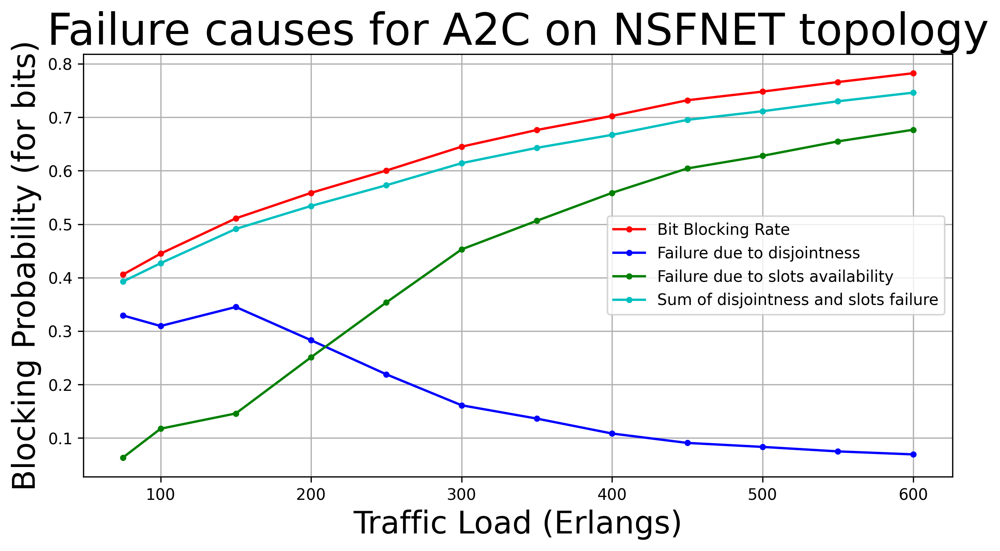

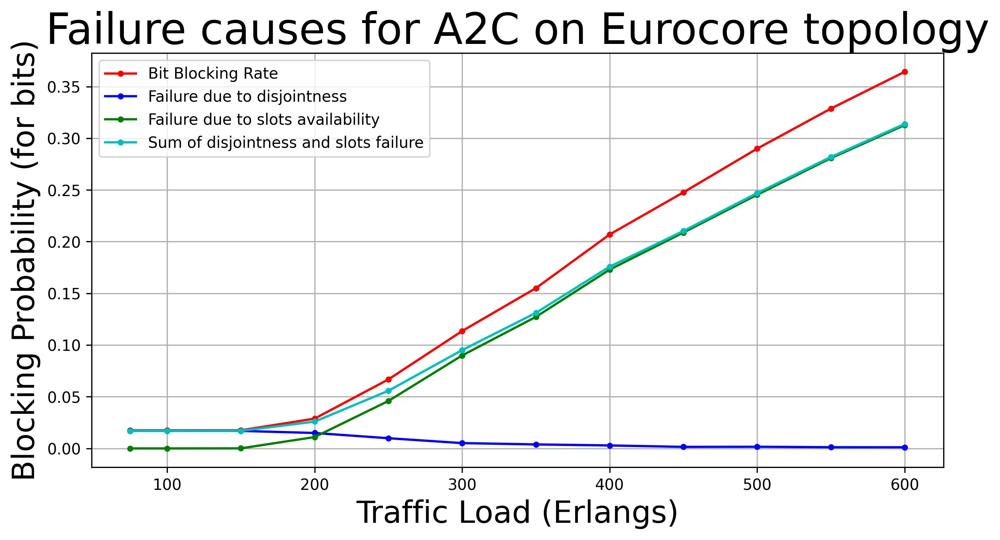

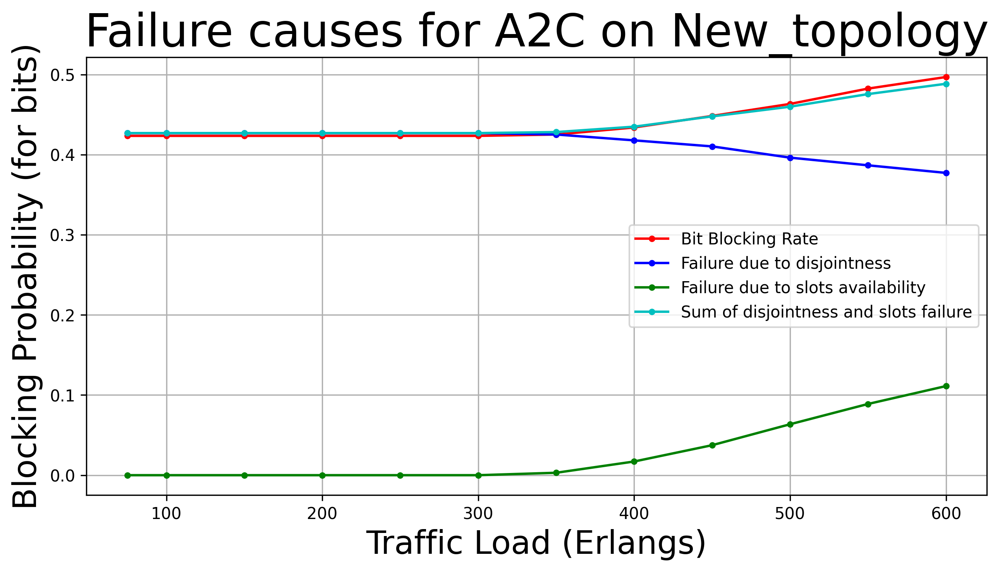

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

Matrix = [7.5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]

means_bit_rate_a2c_nsfnet = []
means_episode_a2c_nsfnet = []
means_disjointness_a2c_nsfnet = []
means_slots_failure_a2c_nsfnet = []

for i in Matrix: 
  df=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-{}-nsfnet/testing.monitor.csv'.format(i),header=1)
  means_bit_rate_a2c_nsfnet.append(df.bit_rate_blocking_rate.mean())
  means_episode_a2c_nsfnet.append(df.episode_service_blocking_rate.mean())
  means_disjointness_a2c_nsfnet.append(df.failure_disjointness.mean())
  means_slots_failure_a2c_nsfnet.append(df.failure_slots.mean())
  
print(means_bit_rate_a2c_nsfnet)
print(means_episode_a2c_nsfnet)
print(means_disjointness_a2c_nsfnet)


means_bit_rate_a2c_eurocore = []
means_episode_a2c_eurocore = []
means_disjointness_a2c_eurocore = []
means_slots_failure_a2c_eurocore = []

for i in Matrix: 
  df2=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/explainability/fragmentation_study/a2c-{}-eurocore/testing.monitor.csv'.format(i),header=1)
  means_bit_rate_a2c_eurocore.append(df2.bit_rate_blocking_rate.mean())
  means_episode_a2c_eurocore.append(df2.episode_service_blocking_rate.mean())
  means_disjointness_a2c_eurocore.append(df2.failure_disjointness.mean())
  means_slots_failure_a2c_eurocore.append(df2.failure_slots.mean())


means_bit_rate_a2c_newt = []
means_episode_a2c_newt = []
means_disjointness_a2c_newt = []
means_slots_failure_a2c_newt = []

for i in Matrix: 
  df3=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-{}-new_topology/testing.monitor.csv'.format(i),header=1)
  means_bit_rate_a2c_newt.append(df3.bit_rate_blocking_rate.mean())
  means_episode_a2c_newt.append(df3.episode_service_blocking_rate.mean())
  means_disjointness_a2c_newt.append(df3.failure_disjointness.mean())
  means_slots_failure_a2c_newt.append(df3.failure_slots.mean())




means_bit_rate_a2c_nsfnet_tuned = []
means_episode_a2c_nsfnet_tuned = []



for i in Matrix:
  df_7 = pd.read_csv("/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-{}-nsfnet_tuned/testing.monitor.csv".format(i), header=1)
  df_8 = pd.read_csv("/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-{}-eurocore_tuned/testing.monitor.csv".format(i), header = 1)
  df_9 = pd.read_csv("/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-{}-new_topology_tuned/testing.monitor.csv".format(i), header=1)

  means_bit_rate_a2c_nsfnet_tuned.append(df_7.bit_rate_blocking_rate.mean())
  means_episode_a2c_nsfnet_tuned.append(df_7.episode_service_blocking_rate.mean()) 

  



Loads = []
for i in Matrix:
  Loads.append(i*10)


plt.figure(figsize=(10,5), dpi = 300)


y_10 = means_bit_rate_a2c_nsfnet
y_11 = means_disjointness_a2c_nsfnet
y_12 = means_slots_failure_a2c_nsfnet
zipped_results = zip(y_11, y_12)
y_13 = [x + y for (x, y) in zipped_results]




plt.plot(Loads,y_10,'r.-', linewidth = 1.5)
plt.plot(Loads, y_11, 'b.-', linewidth = 1.5)
plt.plot(Loads,y_12, 'g.-', linewidth = 1.5)
plt.plot(Loads, y_13, 'c.-', linewidth = 1.5)


#plt.yscale("log")
plt.grid(axis='y', which = 'both')
plt.grid(axis='x', which='both')
plt.title(("Failure causes for A2C on NSFNET topology"), fontsize = 28)

plt.xlabel(("Traffic Load (Erlangs)"), fontsize = 20)
plt.ylabel(("Blocking Probability (for bits)"), fontsize = 20)

plt.gca().legend(('Bit Blocking Rate', 'Failure due to disjointness', 'Failure due to slots availability', 'Sum of disjointness and slots failure'))
images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Failure_comparison_nsfnet.png")
plt.show()





plt.figure(figsize=(10,5), dpi = 300)


y_20 = means_bit_rate_a2c_eurocore
y_21 = means_disjointness_a2c_eurocore
y_22 = means_slots_failure_a2c_eurocore
zipped_results = zip(y_21, y_22)
y_23 = [x + y for (x, y) in zipped_results]




plt.plot(Loads,y_20,'r.-', linewidth = 1.5)
plt.plot(Loads, y_21, 'b.-', linewidth = 1.5)
plt.plot(Loads,y_22, 'g.-', linewidth = 1.5)
plt.plot(Loads, y_23, 'c.-', linewidth = 1.5)


#plt.yscale("log")
plt.grid(axis='y', which = 'both')
plt.grid(axis='x', which='both')
plt.title(("Failure causes for A2C on Eurocore topology"), fontsize = 28)

plt.xlabel(("Traffic Load (Erlangs)"), fontsize = 20)
plt.ylabel(("Blocking Probability (for bits)"), fontsize = 20)

plt.gca().legend(('Bit Blocking Rate', 'Failure due to disjointness', 'Failure due to slots availability', 'Sum of disjointness and slots failure'))
images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Failure_comparison_eurocore.png")
plt.show()




plt.figure(figsize=(10,5), dpi = 300)


y_30 = means_bit_rate_a2c_newt
y_31 = means_disjointness_a2c_newt
y_32 = means_slots_failure_a2c_newt
zipped_results = zip(y_31, y_32)
y_33 = [x + y for (x, y) in zipped_results]




plt.plot(Loads,y_30,'r.-', linewidth = 1.5)
plt.plot(Loads, y_31, 'b.-', linewidth = 1.5)
plt.plot(Loads,y_32, 'g.-', linewidth = 1.5)
plt.plot(Loads, y_33, 'c.-', linewidth = 1.5)


#plt.yscale("log")
plt.grid(axis='y', which = 'both')
plt.grid(axis='x', which='both')
plt.title(("Failure causes for A2C on New_topology"), fontsize = 28)

plt.xlabel(("Traffic Load (Erlangs)"), fontsize = 20)
plt.ylabel(("Blocking Probability (for bits)"), fontsize = 20)

plt.gca().legend(('Bit Blocking Rate', 'Failure due to disjointness', 'Failure due to slots availability', 'Sum of disjointness and slots failure'))
images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Failure_comparison_new_topology.png")
plt.show()





# Trying to explain simply the results

## nsfnet

mean_reward:-26.02 +/- 6.52


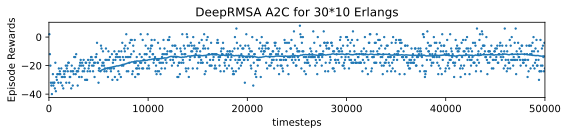

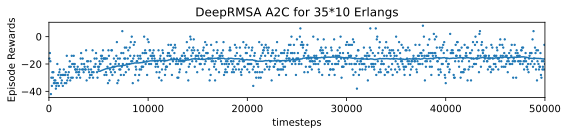

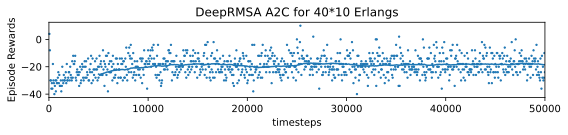

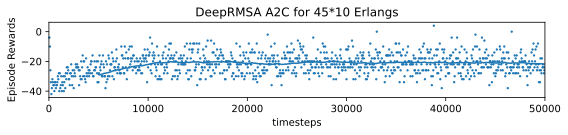

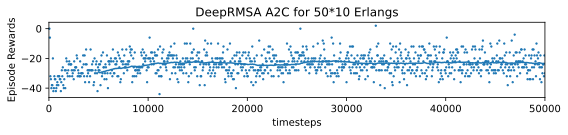

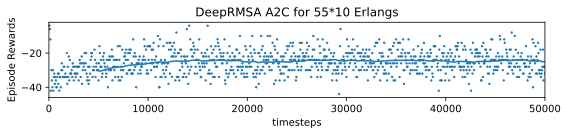

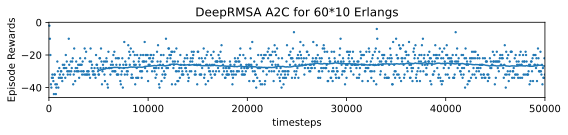

In [ ]:
from stable_baselines3.a2c.policies import MlpPolicy

for ht in [7.5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]:

  # mean_service_holding_time varying between 7.5 and 60,
  env_args = dict(topology=topology, seed=10, 
                allow_rejection=False, # the agent cannot proactively reject a request
                j=1, # consider only the first suitable spectrum block for the spectrum assignment
                mean_service_holding_time=ht, # value is not set as in the paper to achieve comparable reward values
                episode_length=50, node_request_probabilities=node_request_probabilities, num_spectrum_resources = 358)
  
  # Create log dir
  log_dir = "/content/drive/MyDrive/optical-rl-gym-Modif/tmp/explainability/fragmentation_study/a2c-{}-nsfnet/".format(ht)
  os.makedirs(log_dir, exist_ok=True)
  callback = SaveOnBestTrainingRewardCallback(check_freq=100, log_dir=log_dir)

  env = gym.make('DeepRMSADPP-v0', **env_args)

  # logs will be saved in log_dir/monitor.csv
  # in this case, on top of the usual monitored things, we also monitor service and bit rate blocking probabilities
  env = Monitor(env, log_dir + 'training', info_keywords=('episode_service_blocking_rate', 'bit_rate_blocking_rate', 'failure', 'episode_failure',
                    'failure_slots','episode_failure_slots', 
                    'failure_disjointness','episode_failure_disjointness', 'length_comparison', 'length_wp', 'length_bp', 'hops_wp', 'hops_bp', 'number_slots_wp',
                    'number_slots_bp',
                    'initial_slots_wp',
                    'initial_slots_bp',  
                    'average_external_fragmentation_wp', 
                    'average_external_fragmentation_bp')) #'1', '2', '3', '4', '5', '6', '7', '8'

  policy_args = dict(net_arch=5*[128])#, act_fun=tf.nn.elu) # the neural network has four layers with 150 neurons each

  agent = A2C(MlpPolicy, env, verbose=0, tensorboard_log="/content/drive/MyDrive/optical-rl-gym-Modif/tb/A2C-50-DeepRMSA-v0/", policy_kwargs=policy_args, gamma=.95 , learning_rate=10e-5)

  a = agent.learn(total_timesteps=50000, callback=callback)

  from stable_baselines3.common import results_plotter

  results_plotter.plot_results([log_dir], 1e10, results_plotter.X_TIMESTEPS, "DeepRMSA A2C for {}*10 Erlangs".format(ht))

  from stable_baselines3.common.evaluation import evaluate_policy

  testing_env = gym.make('DeepRMSADPP-v0', **env_args)

  # Logs will be saved in log_dir/monitor.csv
  testing_env = Monitor(testing_env, log_dir + 'testing', info_keywords=('episode_service_blocking_rate', 'bit_rate_blocking_rate','failure', 'episode_failure',
                    'failure_slots','episode_failure_slots', 
                    'failure_disjointness','episode_failure_disjointness', 'length_comparison', 'length_wp', 'length_bp', 'hops_wp', 'hops_bp', 'number_slots_wp',
                    'number_slots_bp',
                    'initial_slots_wp',
                    'initial_slots_bp', 
                    'average_external_fragmentation_wp', 
                    'average_external_fragmentation_bp')) #'1', '2', '3', '4', '5', '6', '7', '8'

  # Evaluate the trained agent
  mean_reward, std_reward = evaluate_policy(a, testing_env, n_eval_episodes=500)

  print(f"mean_reward:{mean_reward:.2f} +/- {std_reward:.2f}")


## Nsfnet with the new h5 file

mean_reward:-26.02 +/- 6.52


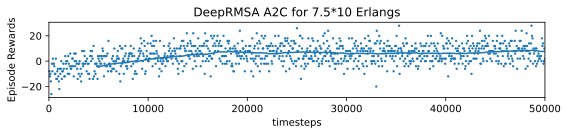

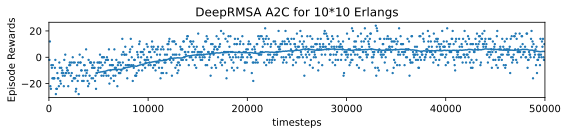

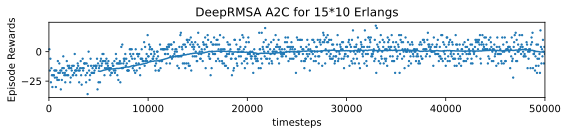

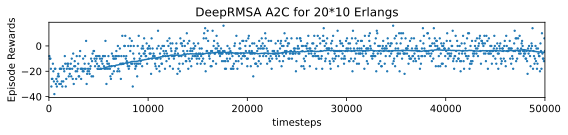

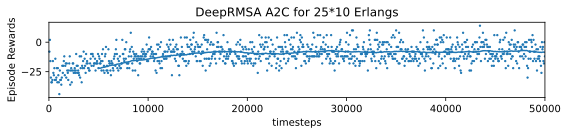

...

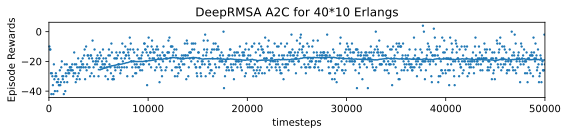

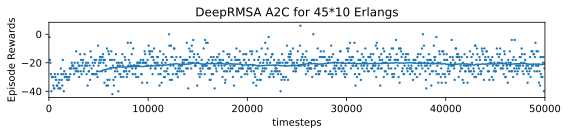

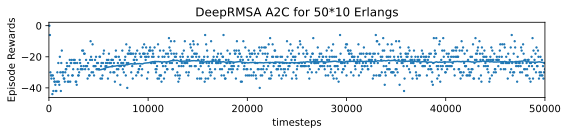

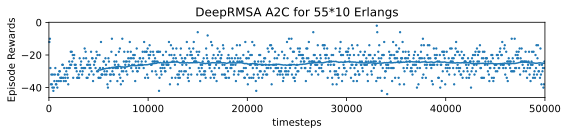

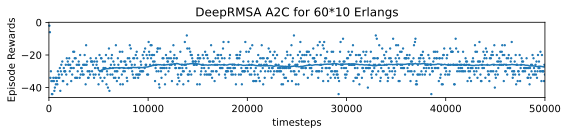

In [ ]:
from stable_baselines3.a2c.policies import MlpPolicy

for ht in [7.5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]:

  # mean_service_holding_time varying between 7.5 and 60,
  env_args = dict(topology=topology, seed=10, 
                allow_rejection=False, # the agent cannot proactively reject a request
                j=1, # consider only the first suitable spectrum block for the spectrum assignment
                mean_service_holding_time=ht, # value is not set as in the paper to achieve comparable reward values
                episode_length=50, node_request_probabilities=node_request_probabilities, num_spectrum_resources = 358)
  
  # Create log dir
  log_dir = "/content/drive/MyDrive/optical-rl-gym-Modif/tmp/explainability/test/a2c-{}-nsfnet/".format(ht)
  os.makedirs(log_dir, exist_ok=True)
  callback = SaveOnBestTrainingRewardCallback(check_freq=100, log_dir=log_dir)

  env = gym.make('DeepRMSADPP-v0', **env_args)

  # logs will be saved in log_dir/monitor.csv
  # in this case, on top of the usual monitored things, we also monitor service and bit rate blocking probabilities
  env = Monitor(env, log_dir + 'training', info_keywords=('episode_service_blocking_rate', 'bit_rate_blocking_rate', 'failure', 'episode_failure',
                    'failure_slots','episode_failure_slots', 
                    'failure_disjointness','episode_failure_disjointness', 'length_comparison', 'length_wp', 'length_bp', 'hops_wp', 'hops_bp', 'number_slots_wp',
                    'number_slots_bp',
                    'initial_slots_wp',
                    'initial_slots_bp',  
                    'average_external_fragmentation_wp', 
                    'average_external_fragmentation_bp')) #'1', '2', '3', '4', '5', '6', '7', '8'

  policy_args = dict(net_arch=5*[128])#, act_fun=tf.nn.elu) # the neural network has four layers with 150 neurons each

  agent = A2C(MlpPolicy, env, verbose=0, tensorboard_log="/content/drive/MyDrive/optical-rl-gym-Modif/tb/A2C-50-DeepRMSA-v0/", policy_kwargs=policy_args, gamma=.95 , learning_rate=10e-5)

  a = agent.learn(total_timesteps=50000, callback=callback)

  from stable_baselines3.common import results_plotter

  results_plotter.plot_results([log_dir], 1e10, results_plotter.X_TIMESTEPS, "DeepRMSA A2C for {}*10 Erlangs".format(ht))

  from stable_baselines3.common.evaluation import evaluate_policy

  testing_env = gym.make('DeepRMSADPP-v0', **env_args)

  # Logs will be saved in log_dir/monitor.csv
  testing_env = Monitor(testing_env, log_dir + 'testing', info_keywords=('episode_service_blocking_rate', 'bit_rate_blocking_rate','failure', 'episode_failure',
                    'failure_slots','episode_failure_slots', 
                    'failure_disjointness','episode_failure_disjointness', 'length_comparison', 'length_wp', 'length_bp', 'hops_wp', 'hops_bp', 'number_slots_wp',
                    'number_slots_bp',
                    'initial_slots_wp',
                    'initial_slots_bp', 
                    'average_external_fragmentation_wp', 
                    'average_external_fragmentation_bp')) #'1', '2', '3', '4', '5', '6', '7', '8'

  # Evaluate the trained agent
  mean_reward, std_reward = evaluate_policy(a, testing_env, n_eval_episodes=500)

  print(f"mean_reward:{mean_reward:.2f} +/- {std_reward:.2f}")

## eurocore

In [ ]:
from stable_baselines3.a2c.policies import MlpPolicy

for ht in [7.5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]:

  # mean_service_holding_time varying between 7.5 and 60,
  env_args = dict(topology = topology2, seed=10, 
                allow_rejection=False, # the agent cannot proactively reject a request
                j=1, # consider only the first suitable spectrum block for the spectrum assignment
                mean_service_holding_time=ht, # value is not set as in the paper to achieve comparable reward values
                episode_length=50, node_request_probabilities=node_request_probabilities_eurocore, num_spectrum_resources = 358)
  
  # Create log dir
  log_dir = "/content/drive/MyDrive/optical-rl-gym-Modif/tmp/explainability/fragmentation_study/a2c-{}-eurocore/".format(ht)
  os.makedirs(log_dir, exist_ok=True)
  callback = SaveOnBestTrainingRewardCallback(check_freq=100, log_dir=log_dir)

  env = gym.make('DeepRMSADPP-v0', **env_args)

  # logs will be saved in log_dir/monitor.csv
  # in this case, on top of the usual monitored things, we also monitor service and bit rate blocking probabilities
  env = Monitor(env, log_dir + 'training', info_keywords=('episode_service_blocking_rate', 'bit_rate_blocking_rate', 'failure', 'episode_failure',
                    'failure_slots','episode_failure_slots', 
                    'failure_disjointness','episode_failure_disjointness', 'length_comparison', 'length_wp', 'length_bp', 'hops_wp', 'hops_bp', 'number_slots_wp',
                    'number_slots_bp',
                    'initial_slots_wp',
                    'initial_slots_bp',
                    'average_external_fragmentation_wp', 
                    'average_external_fragmentation_bp'))

  policy_args = dict(net_arch=5*[128])#, act_fun=tf.nn.elu) # the neural network has four layers with 150 neurons each

  agent = A2C(MlpPolicy, env, verbose=0, tensorboard_log="/content/drive/MyDrive/optical-rl-gym-Modif/tb/A2C-50-DeepRMSA-v0/", policy_kwargs=policy_args, gamma=.95 , learning_rate=10e-5)

  a = agent.learn(total_timesteps=50000, callback=callback)

  from stable_baselines3.common import results_plotter

  results_plotter.plot_results([log_dir], 1e10, results_plotter.X_TIMESTEPS, "DeepRMSA A2C for {}*10 Erlangs".format(ht))

  from stable_baselines3.common.evaluation import evaluate_policy

  testing_env = gym.make('DeepRMSADPP-v0', **env_args)

  # Logs will be saved in log_dir/monitor.csv
  testing_env = Monitor(testing_env, log_dir + 'testing', info_keywords=('episode_service_blocking_rate', 'bit_rate_blocking_rate','failure', 'episode_failure',
                    'failure_slots','episode_failure_slots', 
                    'failure_disjointness','episode_failure_disjointness', 'length_comparison', 'length_wp', 'length_bp', 'hops_wp', 'hops_bp', 'number_slots_wp',
                    'number_slots_bp',
                    'initial_slots_wp',
                    'initial_slots_bp',
                    'average_external_fragmentation_wp', 
                    'average_external_fragmentation_bp'))

  # Evaluate the trained agent
  mean_reward, std_reward = evaluate_policy(a, testing_env, n_eval_episodes=500)

  print(f"mean_reward:{mean_reward:.2f} +/- {std_reward:.2f}")

Output hidden; open in https://colab.research.google.com to view.

## New_topology

In [ ]:
from stable_baselines3.a2c.policies import MlpPolicy

for ht in [7.5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]:

  # mean_service_holding_time varying between 7.5 and 60,
  env_args = dict(topology=topology2, seed=10, 
                allow_rejection=False, # the agent cannot proactively reject a request
                j=1, # consider only the first suitable spectrum block for the spectrum assignment
                mean_service_holding_time=ht, # value is not set as in the paper to achieve comparable reward values
                episode_length=50, node_request_probabilities=node_request_probabilities_new_topology, num_spectrum_resources = 358)
  
  # Create log dir
  log_dir = "/content/drive/MyDrive/optical-rl-gym-Modif/tmp/explainability/a2c-{}-new_topology/".format(ht)
  os.makedirs(log_dir, exist_ok=True)
  callback = SaveOnBestTrainingRewardCallback(check_freq=100, log_dir=log_dir)

  env = gym.make('DeepRMSADPP-v0', **env_args)

  # logs will be saved in log_dir/monitor.csv
  # in this case, on top of the usual monitored things, we also monitor service and bit rate blocking probabilities
  env = Monitor(env, log_dir + 'training', info_keywords=('episode_service_blocking_rate', 'bit_rate_blocking_rate', 'failure', 'episode_failure',
                    'failure_slots','episode_failure_slots', 
                    'failure_disjointness','episode_failure_disjointness', 'length_comparison', 'length_wp', 'length_bp', 'hops_wp', 'hops_bp', 'number_slots_wp',
                    'number_slots_bp',
                    'initial_slots_wp',
                    'initial_slots_bp'))

  policy_args = dict(net_arch=5*[128])#, act_fun=tf.nn.elu) # the neural network has four layers with 150 neurons each

  agent = A2C(MlpPolicy, env, verbose=0, tensorboard_log="/content/drive/MyDrive/optical-rl-gym-Modif/tb/A2C-50-DeepRMSA-v0/", policy_kwargs=policy_args, gamma=.95 , learning_rate=10e-5)

  a = agent.learn(total_timesteps=50000, callback=callback)

  from stable_baselines3.common import results_plotter

  results_plotter.plot_results([log_dir], 1e10, results_plotter.X_TIMESTEPS, "DeepRMSA A2C for {}*10 Erlangs".format(ht))

  from stable_baselines3.common.evaluation import evaluate_policy

  testing_env = gym.make('DeepRMSADPP-v0', **env_args)

  # Logs will be saved in log_dir/monitor.csv
  testing_env = Monitor(testing_env, log_dir + 'testing', info_keywords=('episode_service_blocking_rate', 'bit_rate_blocking_rate','failure', 'episode_failure',
                    'failure_slots','episode_failure_slots', 
                    'failure_disjointness','episode_failure_disjointness', 'length_comparison', 'length_wp', 'length_bp', 'hops_wp', 'hops_bp', 'number_slots_wp',
                    'number_slots_bp',
                    'initial_slots_wp',
                    'initial_slots_bp'))

  # Evaluate the trained agent
  mean_reward, std_reward = evaluate_policy(a, testing_env, n_eval_episodes=500)

  print(f"mean_reward:{mean_reward:.2f} +/- {std_reward:.2f}")

## Heuristics

## Nsfnet

In [ ]:
import time
from stable_baselines3.a2c import MlpPolicy
from optical_rl_gym.envs.deeprmsa_env_dpp_ksp import shortest_path_first_fit, shortest_available_path_first_fit

from stable_baselines3.common.evaluation import evaluate_policy
from optical_rl_gym.utils import evaluate_heuristic, random_policy


testing_runtime_heuristic_nsfnet_sp_ff = []

for ht in [7.5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]:

  env_args = dict(topology=topology, seed=10, 
                  allow_rejection=False, # the agent cannot proactively reject a request
                  j=1, # consider only the first suitable spectrum block for the spectrum assignment
                  mean_service_holding_time=ht, # value is not set as in the paper to achieve comparable reward values
                  episode_length=50, node_request_probabilities=node_request_probabilities, num_spectrum_resources = 358)

  # Create log dir
  log_dir = "/content/drive/MyDrive/optical-rl-gym-Modif/tmp/explainability/fragmentation_study/heuristics-{}-nsfnet/".format(ht)
  os.makedirs(log_dir, exist_ok=True)
  callback = SaveOnBestTrainingRewardCallback(check_freq=50, log_dir=log_dir)

  env = gym.make('DeepRMSADPPKSP-v0', **env_args)

  # logs will be saved in log_dir/monitor.csv
  # in this case, on top of the usual monitored things, we also monitor service and bit rate blocking probabilities

  env = Monitor(env, log_dir + 'sp_ff', info_keywords=('episode_service_blocking_rate','bit_rate_blocking_rate','failure', 'episode_failure',
                      'failure_slots','episode_failure_slots', 
                      'failure_disjointness','episode_failure_disjointness', 'length_comparison', 'length_wp', 'length_bp', 'hops_wp', 'hops_bp', 'number_slots_wp',
                      'number_slots_bp',
                      'initial_slots_wp',
                      'initial_slots_bp',
                      'average_external_fragmentation_wp', 
                      'average_external_fragmentation_bp'))


  # Evaluate the trained agent
  
  start_testing = time.time()
  mean_reward_sp_ff, std_reward_sp_ff = evaluate_heuristic(env, shortest_path_first_fit, n_eval_episodes=2000)

  end_testing = time.time()

  time_testing = end_testing - start_testing

  testing_runtime_heuristic_nsfnet_sp_ff.append(time_testing)

  print("Time testing: ", end_testing - start_testing)

  print(f"mean_reward:{mean_reward_sp_ff:.2f} +/- {std_reward_sp_ff:.2f}")

  print('SP-FF:'.ljust(8), f'{mean_reward_sp_ff:.4f}  {std_reward_sp_ff:>7.4f}')
  print('Bit rate blocking:', (env.episode_bit_rate_requested - env.episode_bit_rate_provisioned) / env.episode_bit_rate_requested)
  print('Request blocking:', (env.episode_services_processed - env.episode_services_accepted) / env.episode_services_processed)

Time testing:  450.20418906211853
mean_reward:-23.37 +/- 7.08
SP-FF:   -23.3680   7.0824
Bit rate blocking: 0.844731977818854
Request blocking: 0.76


## Eurocore

In [ ]:
import time
from stable_baselines3.a2c import MlpPolicy
from optical_rl_gym.envs.deeprmsa_env_dpp_ksp import shortest_path_first_fit, shortest_available_path_first_fit

from stable_baselines3.common.evaluation import evaluate_policy
from optical_rl_gym.utils import evaluate_heuristic, random_policy


testing_runtime_heuristic_eurocore_sp_ff = []

for ht in [7.5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]:


  env_args = dict(topology=topology2, seed=10, 
                  allow_rejection=False, # the agent cannot proactively reject a request
                  j=1, # consider only the first suitable spectrum block for the spectrum assignment
                  mean_service_holding_time=ht, # value is not set as in the paper to achieve comparable reward values
                  episode_length=50, node_request_probabilities=node_request_probabilities_eurocore, num_spectrum_resources = 358)

  # Create log dir
  log_dir = "/content/drive/MyDrive/optical-rl-gym-Modif/tmp/explainability/fragmentation_study/heuristics-{}-eurocore/".format(ht)
  os.makedirs(log_dir, exist_ok=True)
  callback = SaveOnBestTrainingRewardCallback(check_freq=50, log_dir=log_dir)

  env = gym.make('DeepRMSADPPKSP-v0', **env_args)

  # logs will be saved in log_dir/monitor.csv
  # in this case, on top of the usual monitored things, we also monitor service and bit rate blocking probabilities

  env = Monitor(env, log_dir + 'sp_ff', info_keywords=('episode_service_blocking_rate','bit_rate_blocking_rate','failure', 'episode_failure',
                      'failure_slots','episode_failure_slots', 
                      'failure_disjointness','episode_failure_disjointness', 'length_comparison', 'length_wp', 'length_bp', 'hops_wp', 'hops_bp', 'number_slots_wp',
                      'number_slots_bp',
                      'initial_slots_wp',
                      'initial_slots_bp',
                      'average_external_fragmentation_wp', 
                      'average_external_fragmentation_bp'))


  # Evaluate the trained agent
  
  start_testing = time.time()
  mean_reward_sp_ff, std_reward_sp_ff = evaluate_heuristic(env, shortest_path_first_fit, n_eval_episodes=2000)

  end_testing = time.time()

  time_testing = end_testing - start_testing

  testing_runtime_heuristic_eurocore_sp_ff.append(time_testing)

  print("Time testing: ", end_testing - start_testing)

  print(f"mean_reward:{mean_reward_sp_ff:.2f} +/- {std_reward_sp_ff:.2f}")

  print('SP-FF:'.ljust(8), f'{mean_reward_sp_ff:.4f}  {std_reward_sp_ff:>7.4f}')
  print('Bit rate blocking:', (env.episode_bit_rate_requested - env.episode_bit_rate_provisioned) / env.episode_bit_rate_requested)
  print('Request blocking:', (env.episode_services_processed - env.episode_services_accepted) / env.episode_services_processed)

Time testing:  481.19005608558655
mean_reward:50.00 +/- 0.00
SP-FF:   50.0000   0.0000
Bit rate blocking: 0.0
Request blocking: 0.0
Time testing:  472.0626699924469
mean_reward:50.00 +/- 0.00
SP-FF:   50.0000   0.0000
Bit rate blocking: 0.0
Request blocking: 0.0
Time testing:  486.8158574104309
mean_reward:50.00 +/- 0.00
SP-FF:   50.0000   0.0000
Bit rate blocking: 0.0
Request blocking: 0.0
Time testing:  501.48232340812683
mean_reward:49.75 +/- 0.85
SP-FF:   49.7520   0.8476
Bit rate blocking: 0.0
Request blocking: 0.0
Time testing:  508.03036427497864
mean_reward:48.11 +/- 2.45
SP-FF:   48.1060   2.4456
Bit rate blocking: 0.026956253850893407
Request blocking: 0.02
Time testing:  509.4810471534729
mean_reward:45.07 +/- 3.93
SP-FF:   45.0740   3.9277
Bit rate blocking: 0.15542205791743685
Request blocking: 0.16
Time testing:  502.8602650165558
mean_reward:41.22 +/- 5.24
SP-FF:   41.2240   5.2366
Bit rate blocking: 0.17144177449168208
Request blocking: 0.16
Time testing:  496.074752569

## New Topology

In [ ]:
import time
from stable_baselines3.a2c import MlpPolicy
from optical_rl_gym.envs.deeprmsa_env_dpp_ksp import shortest_path_first_fit, shortest_available_path_first_fit

from stable_baselines3.common.evaluation import evaluate_policy
from optical_rl_gym.utils import evaluate_heuristic, random_policy


testing_runtime_heuristic_nsfnet_sp_ff = []

for ht in [7.5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]:


  env_args = dict(topology=topology3, seed=10, 
                  allow_rejection=False, # the agent cannot proactively reject a request
                  j=1, # consider only the first suitable spectrum block for the spectrum assignment
                  mean_service_holding_time=ht, # value is not set as in the paper to achieve comparable reward values
                  episode_length=50, node_request_probabilities=node_request_probabilities_new_topology, num_spectrum_resources = 358)

  # Create log dir
  log_dir = "/content/drive/MyDrive/optical-rl-gym-Modif/tmp/explainability/heuristics-{}-nsfnet/".format(ht)
  os.makedirs(log_dir, exist_ok=True)
  callback = SaveOnBestTrainingRewardCallback(check_freq=50, log_dir=log_dir)

  env = gym.make('DeepRMSADPPKSP-v0', **env_args)

  # logs will be saved in log_dir/monitor.csv
  # in this case, on top of the usual monitored things, we also monitor service and bit rate blocking probabilities

  env = Monitor(env, log_dir + 'sp_ff', info_keywords=('episode_service_blocking_rate','bit_rate_blocking_rate','failure', 'episode_failure',
                      'failure_slots','episode_failure_slots', 
                      'failure_disjointness','episode_failure_disjointness', 'length_comparison', 'length_wp', 'length_bp', 'hops_wp', 'hops_bp', 'number_slots_wp',
                      'number_slots_bp',
                      'initial_slots_wp',
                      'initial_slots_bp',
                      'average_external_fragmentation_wp', 
                      'average_external_fragmentation_bp'))


  # Evaluate the trained agent
  
  start_testing = time.time()
  mean_reward_sp_ff, std_reward_sp_ff = evaluate_heuristic(env, shortest_path_first_fit, n_eval_episodes=2000)

  end_testing = time.time()

  time_testing = end_testing - start_testing

  testing_runtime_heuristic_nsfnet_sp_ff.append(time_testing)

  print("Time testing: ", end_testing - start_testing)

  print(f"mean_reward:{mean_reward_sp_ff:.2f} +/- {std_reward_sp_ff:.2f}")

  print('SP-FF:'.ljust(8), f'{mean_reward_sp_ff:.4f}  {std_reward_sp_ff:>7.4f}')
  print('Bit rate blocking:', (env.episode_bit_rate_requested - env.episode_bit_rate_provisioned) / env.episode_bit_rate_requested)
  print('Request blocking:', (env.episode_services_processed - env.episode_services_accepted) / env.episode_services_processed)

# Plots

<Figure size 3000x1500 with 0 Axes>

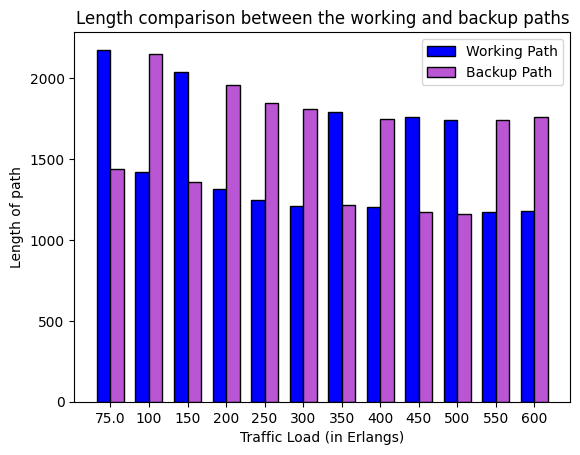

<Figure size 3000x1500 with 0 Axes>

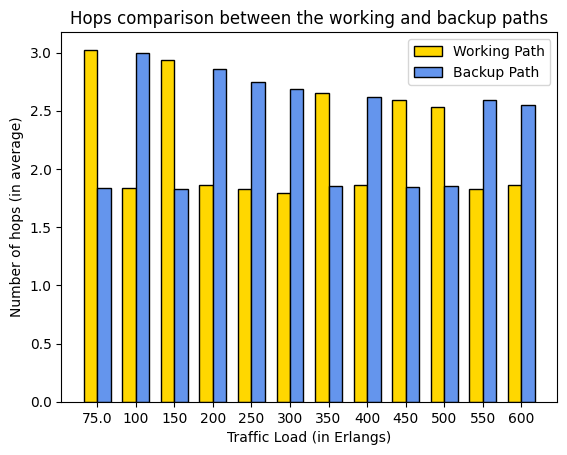

<Figure size 3000x1500 with 0 Axes>

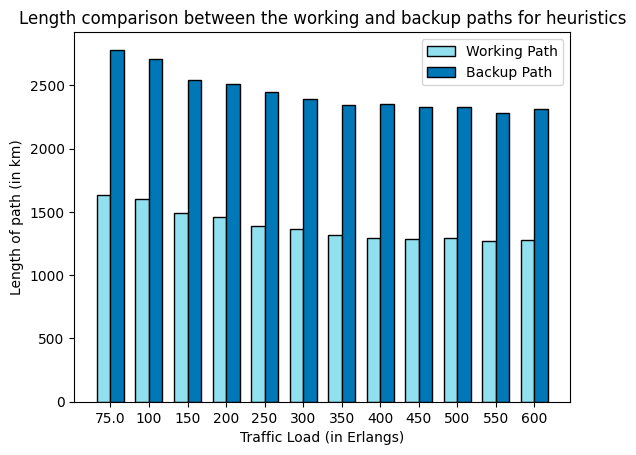

<Figure size 3000x1500 with 0 Axes>

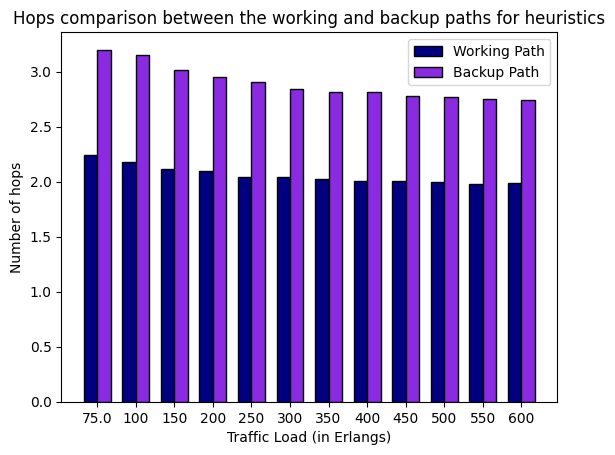

<Figure size 3000x1500 with 0 Axes>

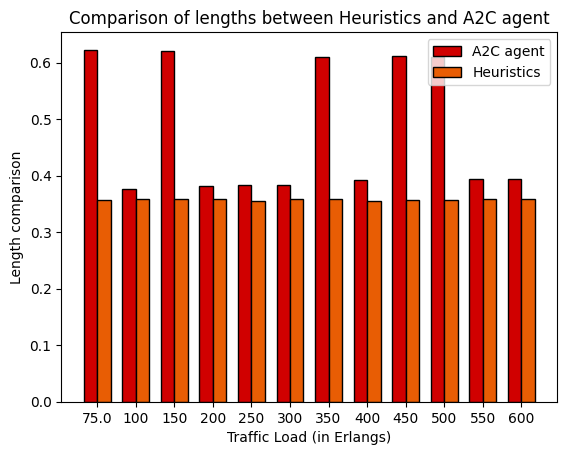

<Figure size 3000x1500 with 0 Axes>

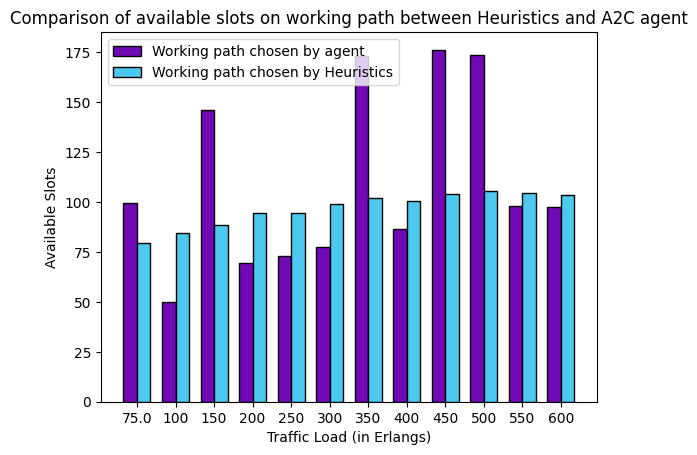

<Figure size 3000x1500 with 0 Axes>

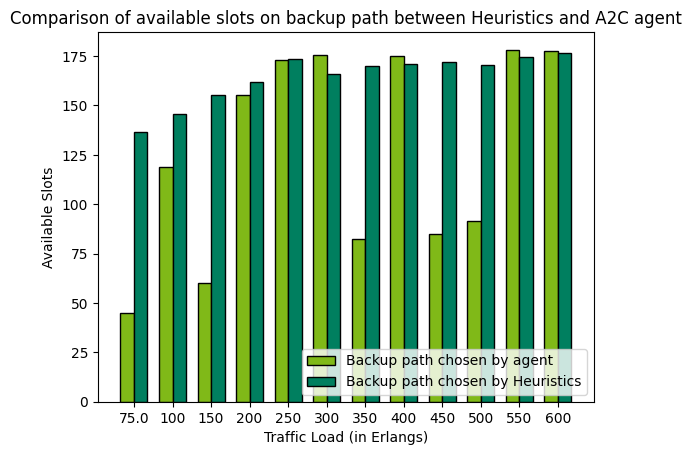

<Figure size 3000x1500 with 0 Axes>

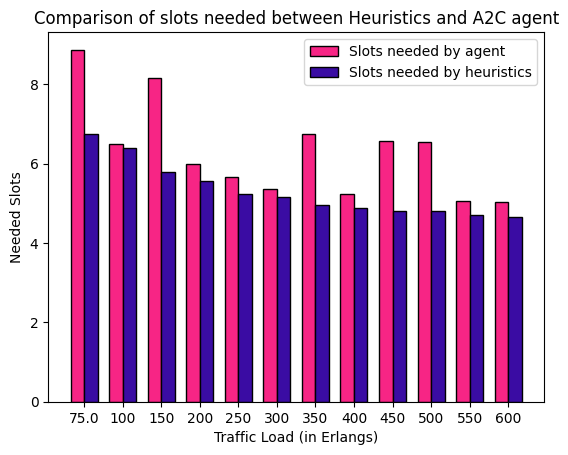

<Figure size 3000x1500 with 0 Axes>

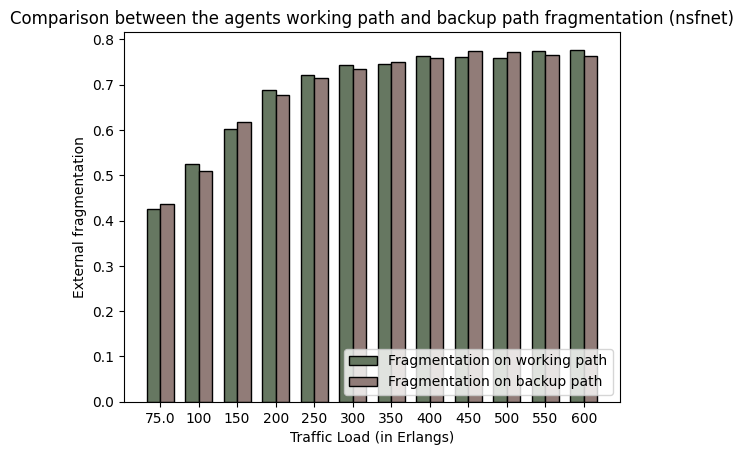

<Figure size 3000x1500 with 0 Axes>

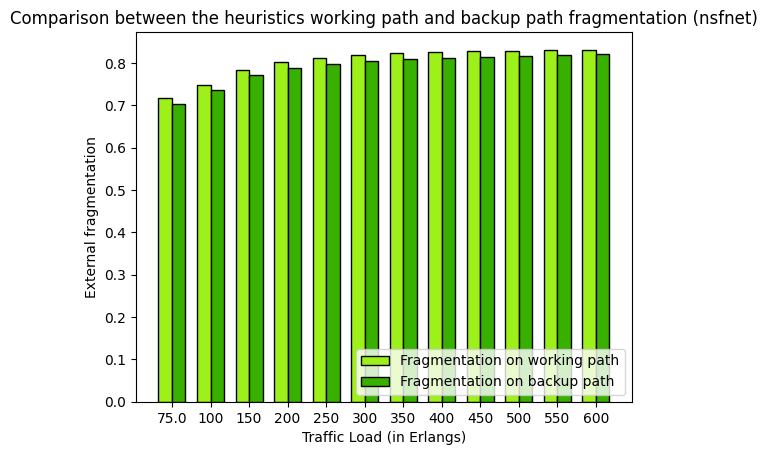

<Figure size 3000x1500 with 0 Axes>

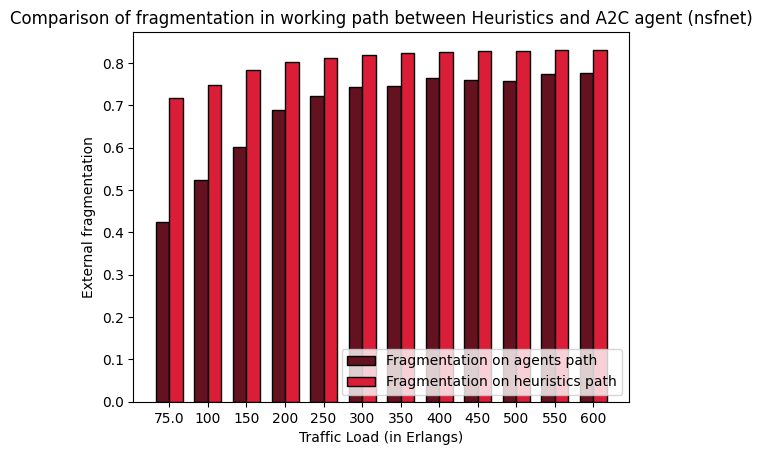

<Figure size 3000x1500 with 0 Axes>

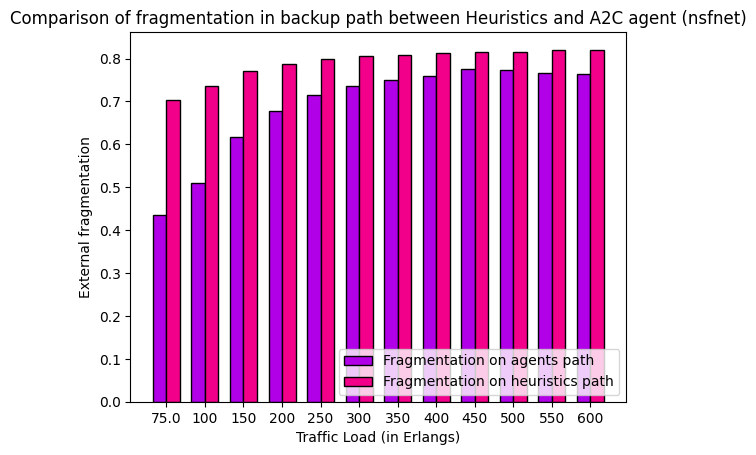

<Figure size 3000x1500 with 0 Axes>

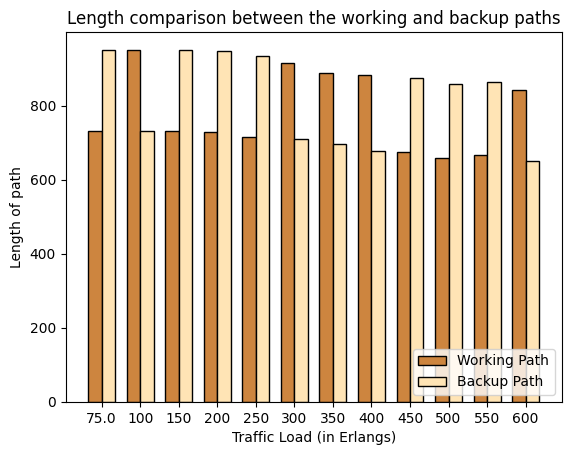

<Figure size 3000x1500 with 0 Axes>

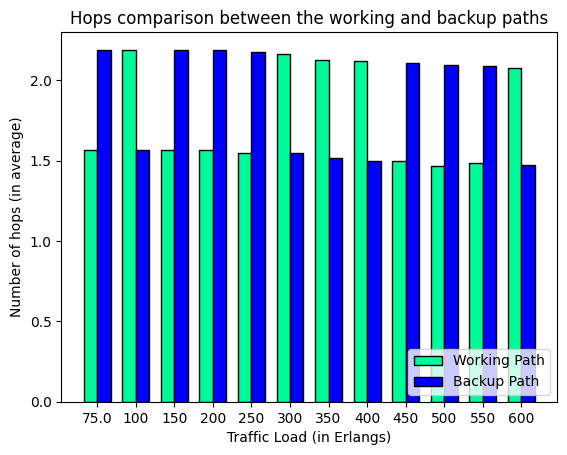

<Figure size 3000x1500 with 0 Axes>

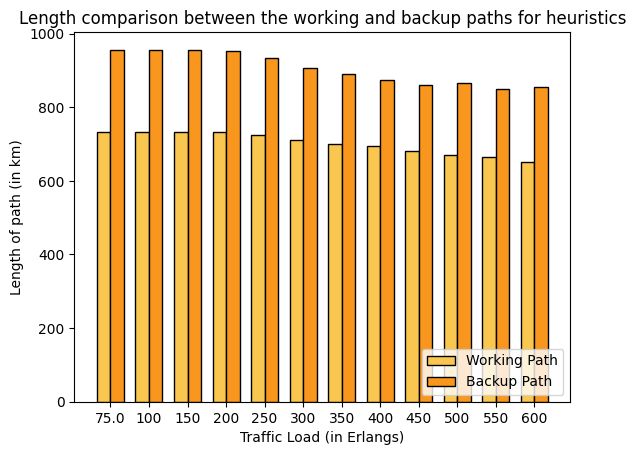

<Figure size 3000x1500 with 0 Axes>

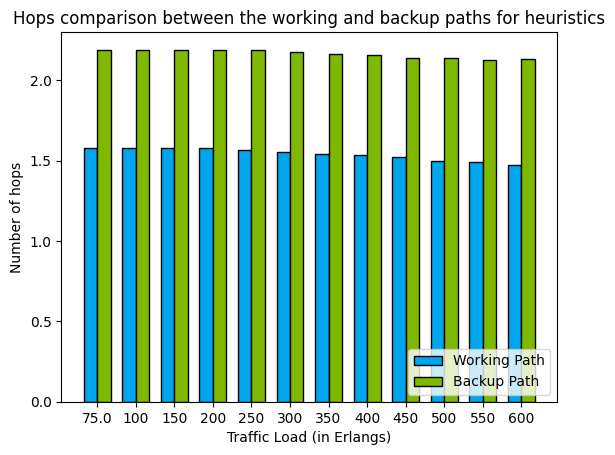

<Figure size 3000x1500 with 0 Axes>

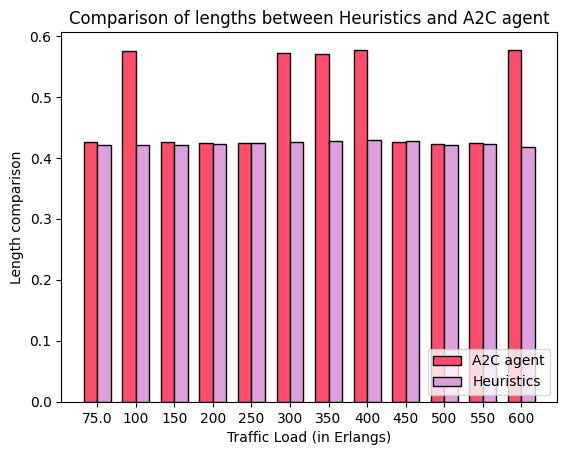

<Figure size 3000x1500 with 0 Axes>

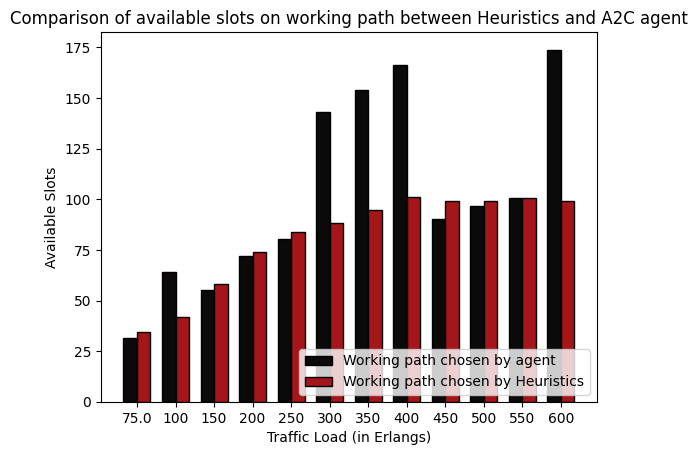

<Figure size 3000x1500 with 0 Axes>

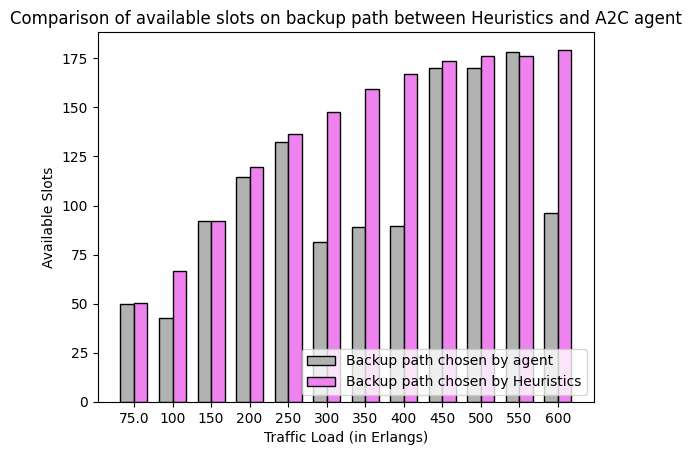

<Figure size 3000x1500 with 0 Axes>

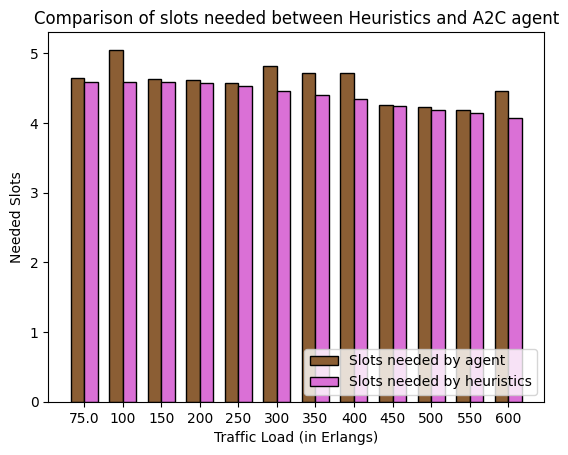

<Figure size 3000x1500 with 0 Axes>

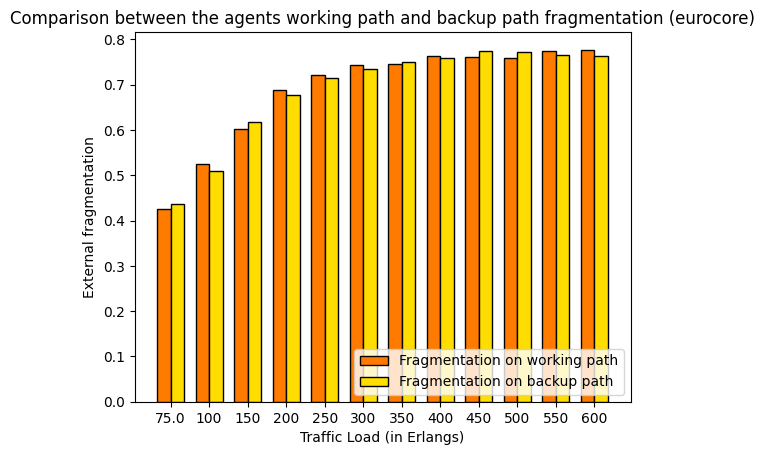

<Figure size 3000x1500 with 0 Axes>

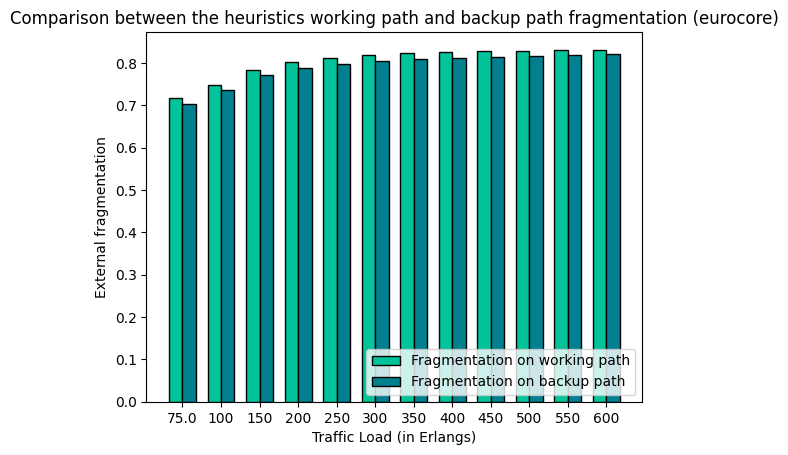

<Figure size 3000x1500 with 0 Axes>

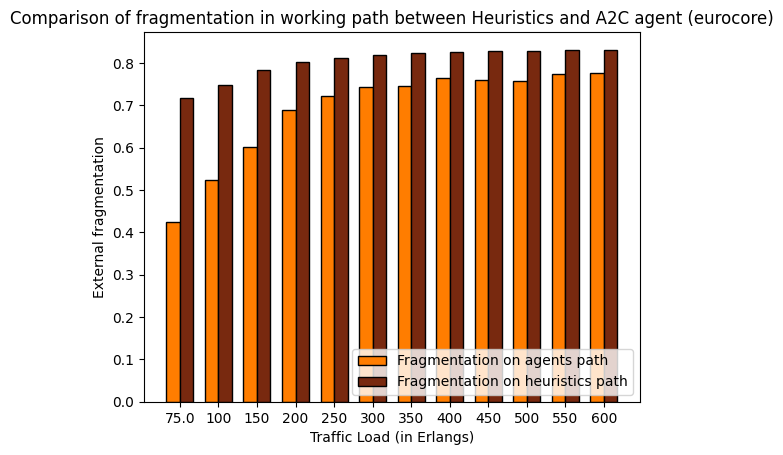

<Figure size 3000x1500 with 0 Axes>

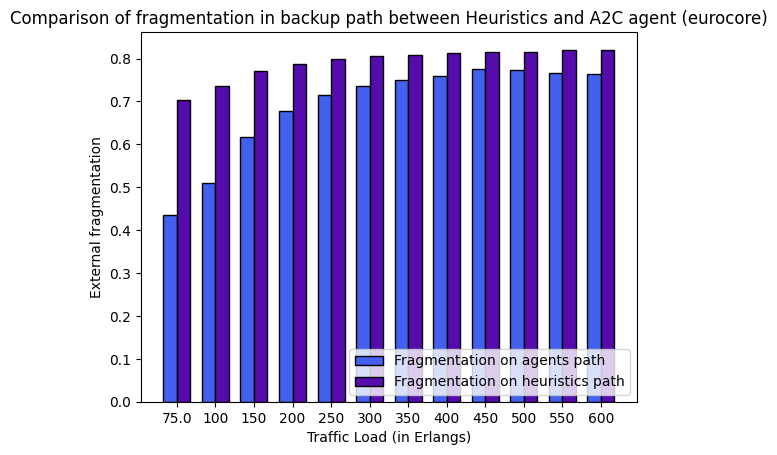

<Figure size 3000x1500 with 0 Axes>

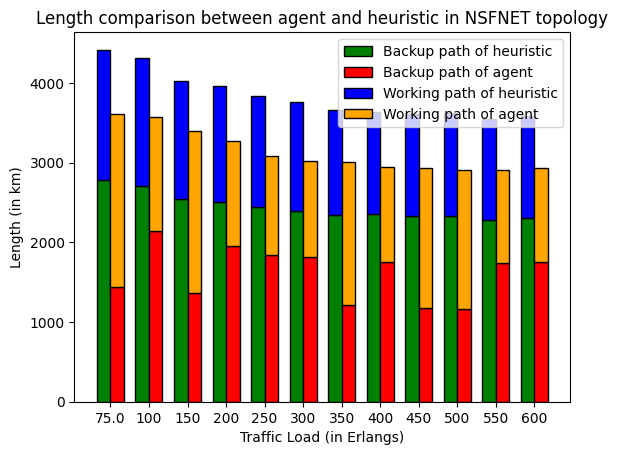

<Figure size 3000x1500 with 0 Axes>

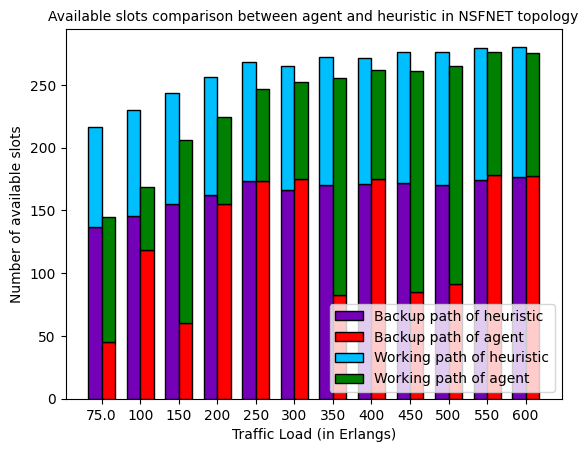

<Figure size 3000x1500 with 0 Axes>

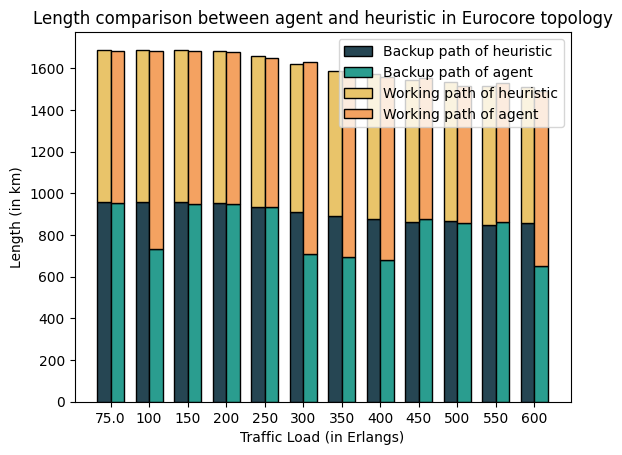

<Figure size 3000x1500 with 0 Axes>

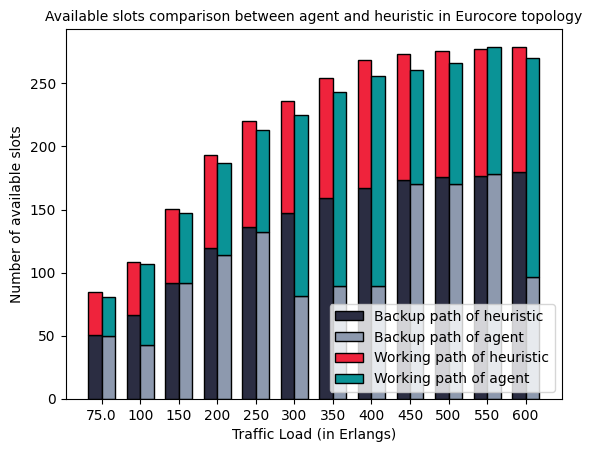

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

Matrix = [7.5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]

means_bit_rate_a2c_nsfnet = []
means_episode_a2c_nsfnet = []
means_disjointness_a2c_nsfnet = []
means_slots_failure_a2c_nsfnet = []
means_length_comparison_nsfnet = []
means_length_wp_nsfnet = []
means_length_bp_nsfnet = []
means_hops_wp_nsfnet = []
means_hops_bp_nsfnet = []
means_number_slots_wp = []
means_number_slots_bp = []
means_initial_slots_wp = []
means_initial_slots_bp = []
means_fragmentation_wp = []
means_fragmentation_bp = []

for i in Matrix: 
  df=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/explainability/fragmentation_study/a2c-{}-nsfnet/testing.monitor.csv'.format(i),header=1)
  means_bit_rate_a2c_nsfnet.append(df.bit_rate_blocking_rate.mean())
  means_episode_a2c_nsfnet.append(df.episode_service_blocking_rate.mean())
  means_disjointness_a2c_nsfnet.append(df.failure_disjointness.mean())
  means_slots_failure_a2c_nsfnet.append(df.failure_slots.mean())
  means_length_comparison_nsfnet.append(df.length_comparison.mean())
  means_length_wp_nsfnet.append(df.length_wp.mean())
  means_length_bp_nsfnet.append(df.length_bp.mean())
  means_hops_wp_nsfnet.append(df.hops_wp.mean())
  means_hops_bp_nsfnet.append(df.hops_bp.mean())
  means_number_slots_wp.append(df.number_slots_wp.mean())
  means_number_slots_bp.append(df.number_slots_bp.mean())
  means_initial_slots_wp.append(df.initial_slots_wp.mean())
  means_initial_slots_bp.append(df.initial_slots_bp.mean())
  means_fragmentation_wp.append(df.average_external_fragmentation_wp.mean())
  means_fragmentation_bp.append(df.average_external_fragmentation_bp.mean())
  
#print(means_length_comparison_nsfnet)
#print(means_length_wp_nsfnet)
#print(means_length_bp_nsfnet)


means_bit_rate_a2c_eurocore = []
means_episode_a2c_eurocore = []
means_disjointness_a2c_eurocore = []
means_slots_failure_a2c_eurocore = []
means_length_comparison_eurocore = []
means_length_wp_eurocore = []
means_length_bp_eurocore = []
means_hops_wp_eurocore = []
means_hops_bp_eurocore = []
means_number_slots_wp_eurocore  = []
means_number_slots_bp_eurocore  = []
means_initial_slots_wp_eurocore  = []
means_initial_slots_bp_eurocore  = []
means_fragmentation_wp_eurocore = []
means_fragmentation_bp_eurocore = []

for i in Matrix: 
  df2=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/explainability/fragmentation_study/a2c-{}-eurocore/testing.monitor.csv'.format(i) ,header=1)
  means_bit_rate_a2c_eurocore.append(df2.bit_rate_blocking_rate.mean())
  means_episode_a2c_eurocore.append(df2.episode_service_blocking_rate.mean())
  means_disjointness_a2c_eurocore.append(df2.failure_disjointness.mean())
  means_slots_failure_a2c_eurocore.append(df2.failure_slots.mean())
  means_length_comparison_eurocore.append(df2.length_comparison.mean())
  means_length_wp_eurocore.append(df2.length_wp.mean())
  means_length_bp_eurocore.append(df2.length_bp.mean())
  means_hops_wp_eurocore.append(df2.hops_wp.mean())
  means_hops_bp_eurocore.append(df2.hops_bp.mean())
  means_number_slots_wp_eurocore.append(df2.number_slots_wp.mean())
  means_number_slots_bp_eurocore.append(df2.number_slots_bp.mean())
  means_initial_slots_wp_eurocore.append(df2.initial_slots_wp.mean())
  means_initial_slots_bp_eurocore.append(df2.initial_slots_bp.mean())
  means_fragmentation_wp_eurocore.append(df2.average_external_fragmentation_wp.mean())
  means_fragmentation_bp_eurocore.append(df2.average_external_fragmentation_bp.mean())
  


#means_bit_rate_a2c_newt = []
#means_episode_a2c_newt = []
#means_disjointness_a2c_newt = []
#means_slots_failure_a2c_newt = []

#for i in Matrix: 
#  df3=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/explainability/a2c-{}-new_topology/testing.monitor.csv'.format(i),header=1)

#  means_bit_rate_a2c_newt.append(df3.bit_rate_blocking_rate.mean())
#  means_episode_a2c_newt.append(df3.episode_service_blocking_rate.mean())
#  means_disjointness_a2c_newt.append(df3.failure_disjointness.mean())
#  means_slots_failure_a2c_newt.append(df3.failure_slots.mean())


means_bit_rate_a2c_nsfnet_h = []
means_episode_a2c_nsfnet_h = []
means_disjointness_a2c_nsfnet_h = []
means_slots_failure_a2c_nsfnet_h = []
means_length_comparison_nsfnet_h = []
means_length_wp_nsfnet_h = []
means_length_bp_nsfnet_h = []
means_hops_wp_nsfnet_h = []
means_hops_bp_nsfnet_h = []
means_number_slots_wp_h = []
means_number_slots_bp_h = []
means_initial_slots_wp_h = []
means_initial_slots_bp_h = []
means_fragmentation_wp_h = []
means_fragmentation_bp_h = []

for i in Matrix: 
  df4=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/explainability/fragmentation_study/heuristics-{}-nsfnet/sp_ff.monitor.csv'.format(i),header=1)
  means_bit_rate_a2c_nsfnet_h.append(df4.bit_rate_blocking_rate.mean())
  means_episode_a2c_nsfnet_h.append(df4.episode_service_blocking_rate.mean())
  means_disjointness_a2c_nsfnet_h.append(df4.failure_disjointness.mean())
  means_slots_failure_a2c_nsfnet_h.append(df4.failure_slots.mean())
  means_length_comparison_nsfnet_h.append(df4.length_comparison.mean())
  means_length_wp_nsfnet_h.append(df4.length_wp.mean())
  means_length_bp_nsfnet_h.append(df4.length_bp.mean())
  means_hops_wp_nsfnet_h.append(df4.hops_wp.mean())
  means_hops_bp_nsfnet_h.append(df4.hops_bp.mean())
  means_number_slots_wp_h.append(df4.number_slots_wp.mean())
  means_number_slots_bp_h.append(df4.number_slots_bp.mean())
  means_initial_slots_wp_h.append(df4.initial_slots_wp.mean())
  means_initial_slots_bp_h.append(df4.initial_slots_bp.mean())
  means_fragmentation_wp_h.append(df4.average_external_fragmentation_wp.mean())
  means_fragmentation_bp_h.append(df4.average_external_fragmentation_bp.mean())
  
#print(means_length_comparison_nsfnet_h)
#print(means_length_wp_nsfnet_h)
#print(means_length_bp_nsfnet_h)

means_bit_rate_a2c_eurocore_h = []
means_episode_a2c_eurocore_h = []
means_disjointness_a2c_eurocore_h = []
means_slots_failure_a2c_eurocore_h = []
means_length_comparison_eurocore_h = []
means_length_wp_eurocore_h = []
means_length_bp_eurocore_h = []
means_hops_wp_eurocore_h = []
means_hops_bp_eurocore_h = []
means_number_slots_wp_eurocore_h = []
means_number_slots_bp_eurocore_h = []
means_initial_slots_wp_eurocore_h = []
means_initial_slots_bp_eurocore_h = []
means_fragmentation_wp_eurocore_h = []
means_fragmentation_bp_eurocore_h = []

for i in Matrix: 
  df5=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/explainability/fragmentation_study/heuristics-{}-eurocore/sp_ff.monitor.csv'.format(i),header=1)
  means_bit_rate_a2c_eurocore_h.append(df5.bit_rate_blocking_rate.mean())
  means_episode_a2c_eurocore_h.append(df5.episode_service_blocking_rate.mean())
  means_disjointness_a2c_eurocore_h.append(df5.failure_disjointness.mean())
  means_slots_failure_a2c_eurocore_h.append(df5.failure_slots.mean())
  means_length_comparison_eurocore_h.append(df5.length_comparison.mean())
  means_length_wp_eurocore_h.append(df5.length_wp.mean())
  means_length_bp_eurocore_h.append(df5.length_bp.mean())
  means_hops_wp_eurocore_h.append(df5.hops_wp.mean())
  means_hops_bp_eurocore_h.append(df5.hops_bp.mean())
  means_number_slots_wp_eurocore_h.append(df5.number_slots_wp.mean())
  means_number_slots_bp_eurocore_h.append(df5.number_slots_bp.mean())
  means_initial_slots_wp_eurocore_h.append(df5.initial_slots_wp.mean())
  means_initial_slots_bp_eurocore_h.append(df5.initial_slots_bp.mean())
  means_fragmentation_wp_eurocore_h.append(df5.average_external_fragmentation_wp.mean())
  means_fragmentation_bp_eurocore_h.append(df5.average_external_fragmentation_bp.mean())
  


Loads = []
for i in Matrix:
  Loads.append(i*10)

y_10 = means_bit_rate_a2c_nsfnet
y_11 = means_disjointness_a2c_nsfnet
y_12 = means_slots_failure_a2c_nsfnet
y_13 = means_length_comparison_nsfnet
y_14 = means_length_wp_nsfnet
y_15 = means_length_bp_nsfnet
y_16 = means_hops_wp_nsfnet
y_17 = means_hops_bp_nsfnet
y_18 = means_number_slots_wp
y_19 = means_number_slots_bp
y_120 = means_initial_slots_wp
y_121 = means_initial_slots_bp
y_122 = means_fragmentation_wp
y_123 = means_fragmentation_bp


y_20 = means_bit_rate_a2c_nsfnet_h
y_21 = means_disjointness_a2c_nsfnet_h
y_22 = means_slots_failure_a2c_nsfnet_h
y_23 = means_length_comparison_nsfnet_h
y_24 = means_length_wp_nsfnet_h
y_25 = means_length_bp_nsfnet_h
y_26 = means_hops_wp_nsfnet_h
y_27 = means_hops_bp_nsfnet_h
y_28 = means_number_slots_wp_h
y_29 = means_number_slots_bp_h
y_220 = means_initial_slots_wp_h
y_221 = means_initial_slots_bp_h
y_222 = means_fragmentation_wp_h
y_223 = means_fragmentation_bp_h


y_30 = means_bit_rate_a2c_eurocore
y_31 = means_disjointness_a2c_eurocore
y_32 = means_slots_failure_a2c_eurocore
y_33 = means_length_comparison_eurocore
y_34 = means_length_wp_eurocore
y_35 = means_length_bp_eurocore
y_36 = means_hops_wp_eurocore
y_37 = means_hops_bp_eurocore
y_38 = means_number_slots_wp_eurocore
y_39 = means_number_slots_bp_eurocore
y_320 = means_initial_slots_wp_eurocore
y_321 = means_initial_slots_bp_eurocore
y_322 = means_fragmentation_wp_eurocore
y_323 = means_fragmentation_bp_eurocore


y_40 = means_bit_rate_a2c_eurocore_h
y_41 = means_disjointness_a2c_eurocore_h
y_42 = means_slots_failure_a2c_eurocore_h
y_43 = means_length_comparison_eurocore_h
y_44 = means_length_wp_eurocore_h
y_45 = means_length_bp_eurocore_h
y_46 = means_hops_wp_eurocore_h
y_47 = means_hops_bp_eurocore_h
y_48 = means_number_slots_wp_eurocore_h
y_49 = means_number_slots_bp_eurocore_h
y_420 = means_initial_slots_wp_eurocore_h
y_421 = means_initial_slots_bp_eurocore_h
y_422 = means_fragmentation_wp_eurocore_h
y_423 = means_fragmentation_bp_eurocore_h



# NSFNET PLOTS

# A2C agent

# Comparison between the working path and backup path length

plt.figure(figsize=(10,5), dpi = 300)

x = np.arange(len(Loads))
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, y_14, width, label='Working Path', color='blue', edgecolor='black')
rects2 = ax.bar(x + width/2, y_15, width, label='Backup Path', color='mediumorchid', edgecolor='black')

ax.set_ylabel('Length of path')
ax.set_xlabel('Traffic Load (in Erlangs)')
ax.set_title('Length comparison between the working and backup paths')
ax.set_xticks(x)
ax.set_xticklabels(Loads)
ax.legend()

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Length_nsfnet.png")
plt.show()


# Comparison between the working path and backup path hops
plt.figure(figsize=(10,5), dpi = 300)

x = np.arange(len(Loads))
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, y_16, width, label='Working Path', color='gold', edgecolor='black')
rects2 = ax.bar(x + width/2, y_17, width, label='Backup Path', color='cornflowerblue', edgecolor='black')

ax.set_ylabel('Number of hops (in average)')
ax.set_xlabel('Traffic Load (in Erlangs)')
ax.set_title('Hops comparison between the working and backup paths')
ax.set_xticks(x)
ax.set_xticklabels(Loads)
ax.legend()

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Hops_nsfnet.png")
plt.show()


# Heuristics

# Comparison between the working path and backup path length
plt.figure(figsize=(10,5), dpi = 300)
x = np.arange(len(Loads))
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, y_24, width, label='Working Path', color='#90e0ef', edgecolor='black')
rects2 = ax.bar(x + width/2, y_25, width, label='Backup Path', color='#0077b6', edgecolor='black')

ax.set_ylabel('Length of path (in km)')
ax.set_xlabel('Traffic Load (in Erlangs)')
ax.set_title('Length comparison between the working and backup paths for heuristics')
ax.set_xticks(x)
ax.set_xticklabels(Loads)
ax.legend()

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Length_nsfnet_heuristics.png")
plt.show()


# Comparison between the working path and backup path hops
plt.figure(figsize=(10,5), dpi = 300)
x = np.arange(len(Loads))
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, y_26, width, label='Working Path', color='navy', edgecolor='black')
rects2 = ax.bar(x + width/2, y_27, width, label='Backup Path', color='blueviolet', edgecolor='black')

ax.set_ylabel('Number of hops')
ax.set_xlabel('Traffic Load (in Erlangs)')
ax.set_title('Hops comparison between the working and backup paths for heuristics')
ax.set_xticks(x)
ax.set_xticklabels(Loads)
ax.legend()

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Hops_nsfnet_heuristics.png")
plt.show()


# Comparison between Agent and Heuristics

# Comparison of length using the function (working_path.length / backup_path.length) / ( 1 + (working_path.length / backup_path.length))

plt.figure(figsize=(10,5), dpi = 300)
x = np.arange(len(Loads))
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, y_13, width, label='A2C agent', color='#d00000', edgecolor='black')
rects2 = ax.bar(x + width/2, y_23, width, label='Heuristics', color='#e85d04', edgecolor='black')

ax.set_ylabel('Length comparison')
ax.set_xlabel('Traffic Load (in Erlangs)')
ax.set_title('Comparison of lengths between Heuristics and A2C agent')
ax.set_xticks(x)
ax.set_xticklabels(Loads)
ax.legend()

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Length_comparison_nsfnet_heuristics.png")
plt.show()



# Comparison between the agent and the heuristics on the available slots for the path chosen in the case of the working path

plt.figure(figsize=(10,5), dpi = 300)
x = np.arange(len(Loads))
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects2 = ax.bar(x - width/2, y_120, width, label='Working path chosen by agent', color='#7209b7', edgecolor='black')
rects3 = ax.bar(x + width/2, y_220, width, label='Working path chosen by Heuristics', color='#4cc9f0', edgecolor='black')


ax.set_ylabel('Available Slots')
ax.set_xlabel('Traffic Load (in Erlangs)')
ax.set_title('Comparison of available slots on working path between Heuristics and A2C agent')
ax.set_xticks(x)
ax.set_xticklabels(Loads)
ax.legend()

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Slots_nsfnet_agent.png")
plt.show()



# Comparison between the agent and the heuristics on the available slots for the path chosen in the case of the backup path

plt.figure(figsize=(10,5), dpi = 300)
x = np.arange(len(Loads))
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects2 = ax.bar(x - width/2, y_121, width, label='Backup path chosen by agent', color='#80b918', edgecolor='black')
rects3 = ax.bar(x + width/2, y_221, width, label='Backup path chosen by Heuristics', color='#007f5f', edgecolor='black')


ax.set_ylabel('Available Slots')
ax.set_xlabel('Traffic Load (in Erlangs)')
ax.set_title('Comparison of available slots on backup path between Heuristics and A2C agent')
ax.set_xticks(x)
ax.set_xticklabels(Loads)
ax.legend(loc='lower right')

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Slots_backup_nsfnet_agent.png")
plt.show()


# Comparison between the agent and the heuristics on the needed slots for the service

plt.figure(figsize=(10,5), dpi = 300)
x = np.arange(len(Loads))
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, y_18, width, label='Slots needed by agent', color='#f72585', edgecolor='black')
rects4 = ax.bar(x + width/2, y_28, width, label='Slots needed by heuristics', color='#3a0ca3', edgecolor='black')


ax.set_ylabel('Needed Slots')
ax.set_xlabel('Traffic Load (in Erlangs)')
ax.set_title('Comparison of slots needed between Heuristics and A2C agent')
ax.set_xticks(x)
ax.set_xticklabels(Loads)
ax.legend()

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Needed_slots_nsfnet_agent.png")
plt.show()




# Comparison between the agent's working path and backup path fragmentation

plt.figure(figsize=(10,5), dpi = 300)
x = np.arange(len(Loads))
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, y_122, width, label='Fragmentation on working path', color='#667761', edgecolor='black')
rects4 = ax.bar(x + width/2, y_123, width, label='Fragmentation on backup path', color='#917c78', edgecolor='black')


ax.set_ylabel('External fragmentation')
ax.set_xlabel('Traffic Load (in Erlangs)')
ax.set_title('Comparison between the agents working path and backup path fragmentation (nsfnet)')
ax.set_xticks(x)
ax.set_xticklabels(Loads)
ax.legend(loc='lower right')

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Frag__nsfnet_agent.png")
plt.show()



# Comparison between the heuristics's working path and backup path fragmentation

plt.figure(figsize=(10,5), dpi = 300)
x = np.arange(len(Loads))
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, y_222, width, label='Fragmentation on working path', color='#9ef01a', edgecolor='black')
rects4 = ax.bar(x + width/2, y_223, width, label='Fragmentation on backup path', color='#38b000', edgecolor='black')


ax.set_ylabel('External fragmentation')
ax.set_xlabel('Traffic Load (in Erlangs)')
ax.set_title('Comparison between the heuristics working path and backup path fragmentation (nsfnet)')
ax.set_xticks(x)
ax.set_xticklabels(Loads)
ax.legend(loc='lower right')

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Frag__nsfnet_heuristics.png")
plt.show()


# Comparison between the agent and the heuristics on the fragmentation of working path

plt.figure(figsize=(10,5), dpi = 300)
x = np.arange(len(Loads))
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, y_122, width, label='Fragmentation on agents path', color='#641220', edgecolor='black')
rects4 = ax.bar(x + width/2, y_222, width, label='Fragmentation on heuristics path', color='#da1e37', edgecolor='black')


ax.set_ylabel('External fragmentation')
ax.set_xlabel('Traffic Load (in Erlangs)')
ax.set_title('Comparison of fragmentation in working path between Heuristics and A2C agent (nsfnet)')
ax.set_xticks(x)
ax.set_xticklabels(Loads)
ax.legend(loc='lower right')

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Frag_comparison_nsfnet_agent_heuristic_wp.png")
plt.show()



# Comparison between the agent and the heuristics on the fragmentation of backup path

plt.figure(figsize=(10,5), dpi = 300)
x = np.arange(len(Loads))
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, y_123, width, label='Fragmentation on agents path', color='#b100e8', edgecolor='black')
rects4 = ax.bar(x + width/2, y_223, width, label='Fragmentation on heuristics path', color='#f20089', edgecolor='black')


ax.set_ylabel('External fragmentation')
ax.set_xlabel('Traffic Load (in Erlangs)')
ax.set_title('Comparison of fragmentation in backup path between Heuristics and A2C agent (nsfnet)')
ax.set_xticks(x)
ax.set_xticklabels(Loads)
ax.legend(loc='lower right')

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Frag_comparison_nsfnet_agent_heuristic_bp.png")
plt.show()



# EUROCORE PLOTS


# A2C agent

# Comparison between the working path and backup path length

plt.figure(figsize=(10,5), dpi = 300)

x = np.arange(len(Loads))
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, y_34, width, label='Working Path', color='peru', edgecolor='black')
rects2 = ax.bar(x + width/2, y_35, width, label='Backup Path', color='moccasin', edgecolor='black')

ax.set_ylabel('Length of path')
ax.set_xlabel('Traffic Load (in Erlangs)')
ax.set_title('Length comparison between the working and backup paths')
ax.set_xticks(x)
ax.set_xticklabels(Loads)
ax.legend(loc='lower right')

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Length_eurocore.png")
plt.show()


# Comparison between the working path and backup path hops
plt.figure(figsize=(10,5), dpi = 300)

x = np.arange(len(Loads))
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, y_36, width, label='Working Path', color='mediumspringgreen', edgecolor='black')
rects2 = ax.bar(x + width/2, y_37, width, label='Backup Path', color='blue', edgecolor='black')

ax.set_ylabel('Number of hops (in average)')
ax.set_xlabel('Traffic Load (in Erlangs)')
ax.set_title('Hops comparison between the working and backup paths')
ax.set_xticks(x)
ax.set_xticklabels(Loads)
ax.legend(loc='lower right')

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Hops_eurocore.png")
plt.show()


# Heuristics

# Comparison between the working path and backup path length
plt.figure(figsize=(10,5), dpi = 300)
x = np.arange(len(Loads))
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, y_44, width, label='Working Path', color='#f9c74f', edgecolor='black')
rects2 = ax.bar(x + width/2, y_45, width, label='Backup Path', color='#f8961e', edgecolor='black')

ax.set_ylabel('Length of path (in km)')
ax.set_xlabel('Traffic Load (in Erlangs)')
ax.set_title('Length comparison between the working and backup paths for heuristics')
ax.set_xticks(x)
ax.set_xticklabels(Loads)
ax.legend(loc='lower right')

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Length_eurocore_heuristics.png")
plt.show()


# Comparison between the working path and backup path hops
plt.figure(figsize=(10,5), dpi = 300)
x = np.arange(len(Loads))
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, y_46, width, label='Working Path', color='#00a6ed', edgecolor='black')
rects2 = ax.bar(x + width/2, y_47, width, label='Backup Path', color='#7fb800', edgecolor='black')

ax.set_ylabel('Number of hops')
ax.set_xlabel('Traffic Load (in Erlangs)')
ax.set_title('Hops comparison between the working and backup paths for heuristics')
ax.set_xticks(x)
ax.set_xticklabels(Loads)
ax.legend(loc='lower right')

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Hops_eurocore_heuristics.png")
plt.show()


# Comparison between Agent and Heuristics

# Comparison of length using the function (working_path.length / backup_path.length) / ( 1 + (working_path.length / backup_path.length))

plt.figure(figsize=(10,5), dpi = 300)
x = np.arange(len(Loads))
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, y_33, width, label='A2C agent', color='#ff4d6d', edgecolor='black')
rects2 = ax.bar(x + width/2, y_43, width, label='Heuristics', color='plum', edgecolor='black')

ax.set_ylabel('Length comparison')
ax.set_xlabel('Traffic Load (in Erlangs)')
ax.set_title('Comparison of lengths between Heuristics and A2C agent')
ax.set_xticks(x)
ax.set_xticklabels(Loads)
ax.legend(loc='lower right')

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Length_comparison_eurocore_heuristics.png")
plt.show()



# Comparison between the agent and the heuristics on the available slots for the path chosen in the case of the working path

plt.figure(figsize=(10,5), dpi = 300)
x = np.arange(len(Loads))
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects2 = ax.bar(x - width/2, y_320, width, label='Working path chosen by agent', color='#0b090a', edgecolor='black')
rects3 = ax.bar(x + width/2, y_420, width, label='Working path chosen by Heuristics', color='#a4161a', edgecolor='black')


ax.set_ylabel('Available Slots')
ax.set_xlabel('Traffic Load (in Erlangs)')
ax.set_title('Comparison of available slots on working path between Heuristics and A2C agent')
ax.set_xticks(x)
ax.set_xticklabels(Loads)
ax.legend(loc='lower right')

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Slots_eurocore_agent.png")
plt.show()



# Comparison between the agent and the heuristics on the available slots for the path chosen in the case of the backup path

plt.figure(figsize=(10,5), dpi = 300)
x = np.arange(len(Loads))
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects2 = ax.bar(x - width/2, y_321, width, label='Backup path chosen by agent', color='#b2b2b2', edgecolor='black')
rects3 = ax.bar(x + width/2, y_421, width, label='Backup path chosen by Heuristics', color='violet', edgecolor='black')


ax.set_ylabel('Available Slots')
ax.set_xlabel('Traffic Load (in Erlangs)')
ax.set_title('Comparison of available slots on backup path between Heuristics and A2C agent')
ax.set_xticks(x)
ax.set_xticklabels(Loads)
ax.legend(loc='lower right')

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Slots_backup_eurocore_agent.png")
plt.show()


# Comparison between the agent and the heuristics on the needed slots for the service

plt.figure(figsize=(10,5), dpi = 300)
x = np.arange(len(Loads))
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, y_38, width, label='Slots needed by agent', color='#8b5e34', edgecolor='black')
rects4 = ax.bar(x + width/2, y_48, width, label='Slots needed by heuristics', color='orchid', edgecolor='black')


ax.set_ylabel('Needed Slots')
ax.set_xlabel('Traffic Load (in Erlangs)')
ax.set_title('Comparison of slots needed between Heuristics and A2C agent')
ax.set_xticks(x)
ax.set_xticklabels(Loads)
ax.legend(loc='lower right')

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Needed_slots_eurocore_agent.png")
plt.show()



# Comparison between the agent's working path and backup path fragmentation

plt.figure(figsize=(10,5), dpi = 300)
x = np.arange(len(Loads))
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, y_122, width, label='Fragmentation on working path', color='#ff7b00', edgecolor='black')
rects4 = ax.bar(x + width/2, y_123, width, label='Fragmentation on backup path', color='#ffdd00', edgecolor='black')


ax.set_ylabel('External fragmentation')
ax.set_xlabel('Traffic Load (in Erlangs)')
ax.set_title('Comparison between the agents working path and backup path fragmentation (eurocore)')
ax.set_xticks(x)
ax.set_xticklabels(Loads)
ax.legend(loc='lower right')

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Frag__eurocore_agent.png")
plt.show()



# Comparison between the heuristics's working path and backup path fragmentation

plt.figure(figsize=(10,5), dpi = 300)
x = np.arange(len(Loads))
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, y_222, width, label='Fragmentation on working path', color='#02c39a', edgecolor='black')
rects4 = ax.bar(x + width/2, y_223, width, label='Fragmentation on backup path', color='#028090', edgecolor='black')


ax.set_ylabel('External fragmentation')
ax.set_xlabel('Traffic Load (in Erlangs)')
ax.set_title('Comparison between the heuristics working path and backup path fragmentation (eurocore)')
ax.set_xticks(x)
ax.set_xticklabels(Loads)
ax.legend(loc='lower right')

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Frag__eurocore_heuristics.png")
plt.show()


# Comparison between the agent and the heuristics on the fragmentation of working path

plt.figure(figsize=(10,5), dpi = 300)
x = np.arange(len(Loads))
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, y_122, width, label='Fragmentation on agents path', color='#ff7d00', edgecolor='black')
rects4 = ax.bar(x + width/2, y_222, width, label='Fragmentation on heuristics path', color='#78290f', edgecolor='black')


ax.set_ylabel('External fragmentation')
ax.set_xlabel('Traffic Load (in Erlangs)')
ax.set_title('Comparison of fragmentation in working path between Heuristics and A2C agent (eurocore)')
ax.set_xticks(x)
ax.set_xticklabels(Loads)
ax.legend(loc='lower right')

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Frag_comparison_eurocore_agent_heuristic_wp.png")
plt.show()



# Comparison between the agent and the heuristics on the fragmentation of backup path

plt.figure(figsize=(10,5), dpi = 300)
x = np.arange(len(Loads))
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, y_123, width, label='Fragmentation on agents path', color='#4361ee', edgecolor='black')
rects4 = ax.bar(x + width/2, y_223, width, label='Fragmentation on heuristics path', color='#560bad', edgecolor='black')


ax.set_ylabel('External fragmentation')
ax.set_xlabel('Traffic Load (in Erlangs)')
ax.set_title('Comparison of fragmentation in backup path between Heuristics and A2C agent (eurocore)')
ax.set_xticks(x)
ax.set_xticklabels(Loads)
ax.legend(loc='lower right')

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Frag_comparison_eurocore_agent_heuristic_bp.png")
plt.show()








plt.figure(figsize=(10,5), dpi = 300)
x = np.arange(len(Loads))
width = 0.35 # the width of the bars

fig, ax = plt.subplots()
#ax = fig.add_axes([0,0,1,1])
rects3 = ax.bar(x - width/2, y_25, width, label='Backup path of heuristic', color='green', edgecolor='black')
rects4 = ax.bar(x + width/2, y_15, width, label='Backup path of agent', color='red', edgecolor='black')
rects1 = ax.bar(x - width/2, y_24, width, label='Working path of heuristic', bottom = y_25, color='blue', edgecolor='black')
rects2 = ax.bar(x + width/2, y_14, width, label='Working path of agent',  bottom = y_15, color='orange', edgecolor='black')

ax.set_ylabel('Length (in km)')
ax.set_xlabel('Traffic Load (in Erlangs)')
ax.set_title('Length comparison between agent and heuristic in NSFNET topology')
ax.set_xticks(x)
ax.set_xticklabels(Loads)
ax.legend()

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Length_comparison_VIVA.png")
plt.show()



plt.figure(figsize=(10,5), dpi = 300)
x = np.arange(len(Loads))
width = 0.35 # the width of the bars

fig, ax = plt.subplots()
rects3 = ax.bar(x - width/2, y_221, width, label='Backup path of heuristic', color='#7400b8', edgecolor='black')
rects4 = ax.bar(x + width/2, y_121, width, label='Backup path of agent', color='red', edgecolor='black')#4ea8de
rects1 = ax.bar(x - width/2, y_220, width, label='Working path of heuristic', bottom = y_221, color='deepskyblue', edgecolor='black')
rects2 = ax.bar(x + width/2, y_120, width, label='Working path of agent', bottom = y_121, color='green', edgecolor='black')#38b000

ax.set_ylabel('Number of available slots')
ax.set_xlabel('Traffic Load (in Erlangs)')
ax.set_title('Available slots comparison between agent and heuristic in NSFNET topology', fontsize = 10)
ax.set_xticks(x)
ax.set_xticklabels(Loads)
ax.legend(loc='lower right')

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Slots_comparison_VIVA.png")
plt.show()




plt.figure(figsize=(10,5), dpi = 300)
x = np.arange(len(Loads))
width = 0.35 # the width of the bars

fig, ax = plt.subplots()
#ax = fig.add_axes([0,0,1,1])
rects3 = ax.bar(x - width/2, y_45, width, label='Backup path of heuristic', color='#264653', edgecolor='black')
rects4 = ax.bar(x + width/2, y_35, width, label='Backup path of agent', color='#2a9d8f', edgecolor='black')
rects1 = ax.bar(x - width/2, y_44, width, label='Working path of heuristic', bottom = y_45, color='#e9c46a', edgecolor='black')
rects2 = ax.bar(x + width/2, y_34, width, label='Working path of agent',  bottom = y_35, color='#f4a261', edgecolor='black')

ax.set_ylabel('Length (in km)')
ax.set_xlabel('Traffic Load (in Erlangs)')
ax.set_title('Length comparison between agent and heuristic in Eurocore topology')
ax.set_xticks(x)
ax.set_xticklabels(Loads)
ax.legend()

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Length_eurocore.png")
plt.show()



plt.figure(figsize=(10,5), dpi = 300)
x = np.arange(len(Loads))
width = 0.35 # the width of the bars

fig, ax = plt.subplots()
rects3 = ax.bar(x - width/2, y_421, width, label='Backup path of heuristic', color='#2b2d42', edgecolor='black')
rects4 = ax.bar(x + width/2, y_321, width, label='Backup path of agent', color='#8d99ae', edgecolor='black')#4ea8de
rects1 = ax.bar(x - width/2, y_420, width, label='Working path of heuristic', bottom = y_421, color='#ef233c', edgecolor='black')
rects2 = ax.bar(x + width/2, y_320, width, label='Working path of agent', bottom = y_321, color='#0a9396', edgecolor='black')#38b000

ax.set_ylabel('Number of available slots')
ax.set_xlabel('Traffic Load (in Erlangs)')
ax.set_title('Available slots comparison between agent and heuristic in Eurocore topology', fontsize = 10)
ax.set_xticks(x)
ax.set_xticklabels(Loads)
ax.legend(loc='lower right')

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Slots_eurocore.png")
plt.show()




[0.4212361430037325, 0.4500472390142004, 0.5109970197849039, 0.558668817079142, 0.6003982269249866, 0.6450488546083967, 0.6762882129146958, 0.7025989803048074, 0.7319491846308284, 0.7481123753426725, 0.7659687744409497, 0.7824787976686493]
[0.41940000000000005, 0.44136000000000003, 0.49344000000000005, 0.5385599999999999, 0.582, 0.6229199999999999, 0.6547200000000001, 0.6796800000000001, 0.70804, 0.7262799999999999, 0.7444000000000001, 0.76024]
[0.01449176165011876, 0.01449176165011876, 0.01449176165011876, 0.01449176165011876, 0.01449176165011876, 0.016041084970291067, 0.03307003533007755, 0.06027311413739201, 0.09519938160685365, 0.1202393400583329, 0.15553840594142443, 0.18119678224758448]
[0.016800000000000002, 0.016800000000000002, 0.016800000000000002, 0.016800000000000002, 0.016800000000000002, 0.0212, 0.046400000000000004, 0.07659999999999999, 0.11800000000000002, 0.1516, 0.18739999999999998, 0.22659999999999997]
[0.41586386845735135, 0.4500472390142004, 0.5109970197849039, 0.5

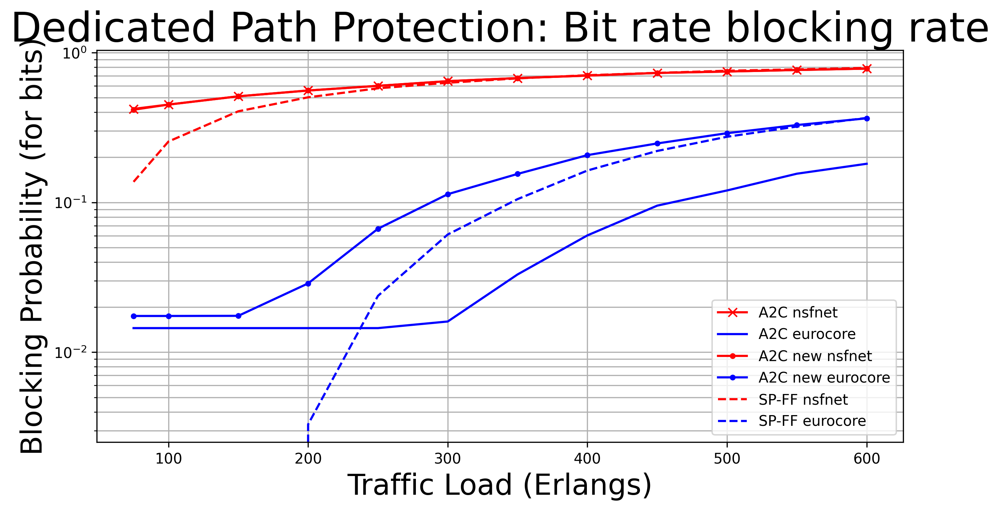

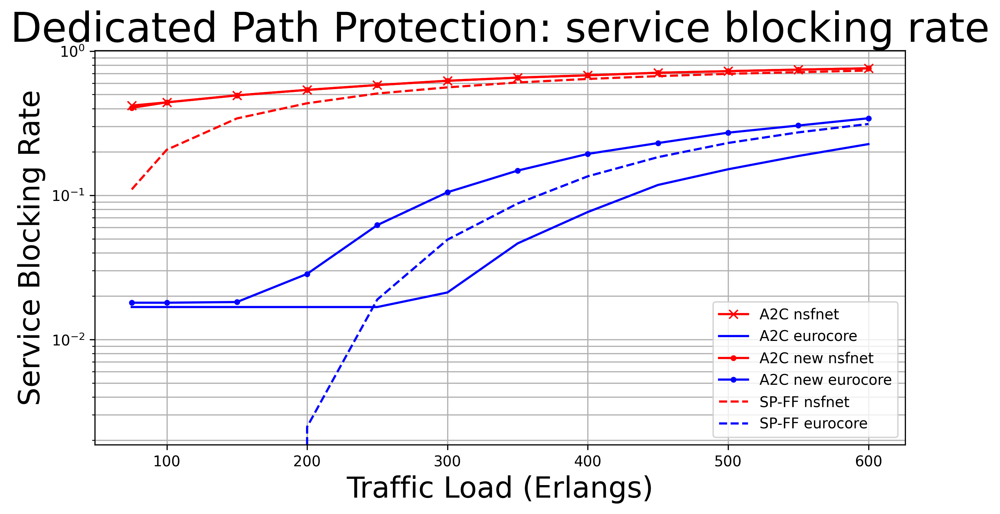

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

Matrix = [7.5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]

means_bit_rate_a2c_nsfnet = []
means_episode_a2c_nsfnet = []

for i in Matrix: 
  df=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/explainability/fragmentation_study/a2c-{}-nsfnet/testing.monitor.csv'.format(i),header=1)
  means_bit_rate_a2c_nsfnet.append(df.bit_rate_blocking_rate.mean())
  means_episode_a2c_nsfnet.append(df.episode_service_blocking_rate.mean())
  
print(means_bit_rate_a2c_nsfnet)
print(means_episode_a2c_nsfnet)

means_bit_rate_a2c_eurocore = []
means_episode_a2c_eurocore = []

for i in Matrix: 
  df_2=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/topologies_results/a2c-{}-eurocore/testing.monitor.csv'.format(i),header=1)
  means_bit_rate_a2c_eurocore.append(df_2.bit_rate_blocking_rate.mean())
  means_episode_a2c_eurocore.append(df_2.episode_service_blocking_rate.mean())

print(means_bit_rate_a2c_eurocore)
print(means_episode_a2c_eurocore)

means_bit_rate_a2c_nsfnet_length = []
means_episode_a2c_nsfnet_length = []


for i in Matrix: 
  df_3=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/explainability/test/a2c-{}-nsfnet/testing.monitor.csv'.format(i),header=1)
  means_bit_rate_a2c_nsfnet_length.append(df_3.bit_rate_blocking_rate.mean())
  means_episode_a2c_nsfnet_length.append(df_3.episode_service_blocking_rate.mean())

print(means_bit_rate_a2c_nsfnet_length)
print(means_episode_a2c_nsfnet_length)



means_bit_rate_a2c_eurocore_length = []
means_episode_a2c_eurocore_length = []


for i in Matrix:
  df_5 = pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/explainability/fragmentation_study/a2c-{}-eurocore/testing.monitor.csv'.format(i),header=1)
  means_bit_rate_a2c_eurocore_length.append(df_5.bit_rate_blocking_rate.mean())
  means_episode_a2c_eurocore_length.append(df_5.episode_service_blocking_rate.mean())  


means_bit_rate_heuristics_nsfnet = []
means_episode_heuristics_nsfnet = []


for i in Matrix:
  df_6 = pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/explainability/fragmentation_study/heuristics-{}-nsfnet/sp_ff.monitor.csv'.format(i),header=1)
  means_bit_rate_heuristics_nsfnet.append(df_6.bit_rate_blocking_rate.mean())
  means_episode_heuristics_nsfnet.append(df_6.episode_service_blocking_rate.mean())  


means_bit_rate_heuristics_eurocore = []
means_episode_heuristics_eurocore = []


for i in Matrix:
  df_7 = pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/explainability/fragmentation_study/heuristics-{}-eurocore/sp_ff.monitor.csv'.format(i),header=1)
  means_bit_rate_heuristics_eurocore.append(df_7.bit_rate_blocking_rate.mean())
  means_episode_heuristics_eurocore.append(df_7.episode_service_blocking_rate.mean())  
  



Loads = []
for i in Matrix:
  Loads.append(i*10)


plt.figure(figsize=(10,5), dpi = 300)


y_10 = means_bit_rate_a2c_nsfnet

y_20 = means_bit_rate_a2c_eurocore

y_30 = means_bit_rate_a2c_nsfnet_length

y_21 = means_bit_rate_a2c_eurocore_length

y_22 = means_bit_rate_heuristics_nsfnet

y_23 = means_bit_rate_heuristics_eurocore





plt.plot(Loads,y_10, color = 'r', marker = 'x', linewidth = 1.5)
plt.plot(Loads, y_20, 'b', linewidth = 1.5)
plt.plot(Loads, y_30, 'r.-', linewidth = 1.5)
plt.plot(Loads,y_21, 'b.-', linewidth = 1.5)
plt.plot(Loads,y_22, color = 'r', linestyle='dashed', linewidth = 1.5)
plt.plot(Loads,y_23, color = 'b', linestyle='dashed', linewidth = 1.5)



plt.yscale("log")
plt.grid(axis='y', which = 'both')
plt.grid(axis='x', which='both')
plt.title(("Dedicated Path Protection: Bit rate blocking rate"), fontsize = 28)

plt.xlabel(("Traffic Load (Erlangs)"), fontsize = 20)
plt.ylabel(("Blocking Probability (for bits)"), fontsize = 20)

plt.gca().legend(('A2C nsfnet', 'A2C eurocore', 'A2C new nsfnet', 'A2C new eurocore', 'SP-FF nsfnet', 'SP-FF eurocore'))
images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results/'
plt.savefig(f"{images_dir}agents3.png")
plt.show()


y_40 = means_episode_a2c_nsfnet

y_50 = means_episode_a2c_eurocore

y_60 = means_episode_a2c_nsfnet_length

y_51 = means_episode_a2c_eurocore_length

y_52 = means_episode_heuristics_nsfnet

y_53 = means_episode_heuristics_eurocore


plt.figure(figsize=(10,5), dpi = 300)

plt.plot(Loads,y_40, color = 'r', marker = 'x', linewidth = 1.5)
plt.plot(Loads, y_50, 'b', linewidth = 1.5)
plt.plot(Loads, y_60, 'r.-', linewidth = 1.5)
plt.plot(Loads,y_51, 'b.-', linewidth = 1.5)
plt.plot(Loads,y_52, color = 'r', linestyle='dashed', linewidth = 1.5)
plt.plot(Loads,y_53, color = 'b', linestyle='dashed', linewidth = 1.5)

plt.yscale("log")
plt.grid(axis='y', which = 'both')
plt.grid(axis='x', which='both')
plt.title(("Dedicated Path Protection: service blocking rate"), fontsize = 28)

plt.xlabel(("Traffic Load (Erlangs)"), fontsize = 20)
plt.ylabel(("Service Blocking Rate"), fontsize = 20)

plt.gca().legend(('A2C nsfnet', 'A2C eurocore', 'A2C new nsfnet',  'A2C new eurocore', 'SP-FF nsfnet', 'SP-FF eurocore'))

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results/'
plt.savefig(f"{images_dir}agents3_sbr.png")
plt.show()

## Making the rewards take in account the fragmentation of path

NSFNET

mean_reward:-26.02 +/- 6.52


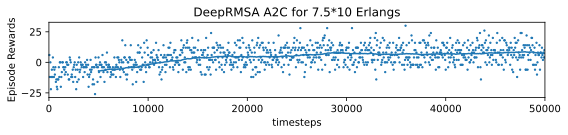

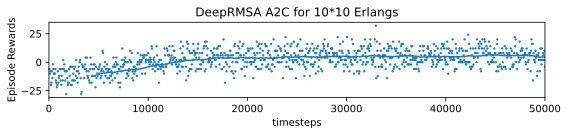

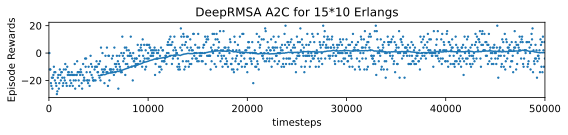

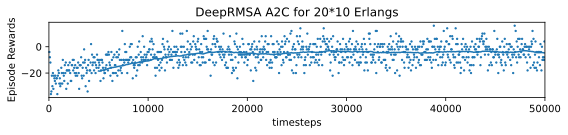

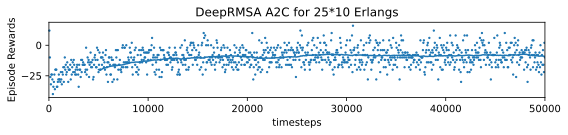

...

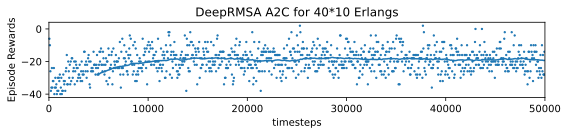

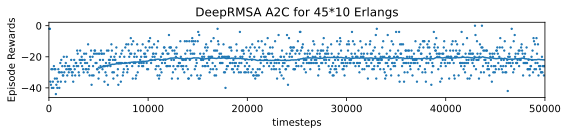

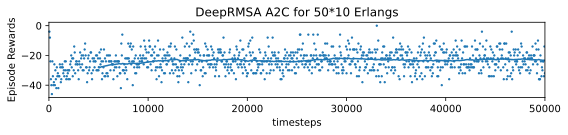

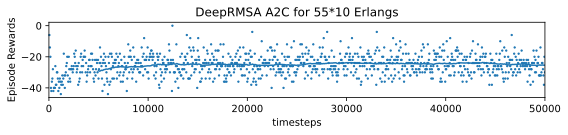

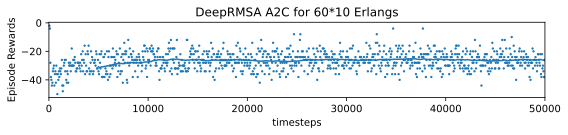

In [ ]:
from stable_baselines3.a2c.policies import MlpPolicy

for ht in [7.5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]:

  # mean_service_holding_time varying between 7.5 and 60,
  env_args = dict(topology=topology, seed=10, 
                allow_rejection=False, # the agent cannot proactively reject a request
                j=1, # consider only the first suitable spectrum block for the spectrum assignment
                mean_service_holding_time=ht, # value is not set as in the paper to achieve comparable reward values
                episode_length=50, node_request_probabilities=node_request_probabilities, num_spectrum_resources = 358)
  
  # Create log dir
  log_dir = "/content/drive/MyDrive/optical-rl-gym-Modif/tmp/explainability/reward_shaping/a2c-{}-nsfnet/".format(ht)
  os.makedirs(log_dir, exist_ok=True)
  callback = SaveOnBestTrainingRewardCallback(check_freq=100, log_dir=log_dir)

  env = gym.make('DeepRMSADPP-v0', **env_args)

  # logs will be saved in log_dir/monitor.csv
  # in this case, on top of the usual monitored things, we also monitor service and bit rate blocking probabilities
  env = Monitor(env, log_dir + 'training', info_keywords=('episode_service_blocking_rate', 'bit_rate_blocking_rate', 'failure', 'episode_failure',
                    'failure_slots','episode_failure_slots', 
                    'failure_disjointness','episode_failure_disjointness', 'length_comparison', 'length_wp', 'length_bp', 'hops_wp', 'hops_bp', 'number_slots_wp',
                    'number_slots_bp',
                    'initial_slots_wp',
                    'initial_slots_bp',
                    'average_external_fragmentation_wp', 
                    'average_external_fragmentation_bp'))

  policy_args = dict(net_arch=5*[128])#, act_fun=tf.nn.elu) # the neural network has four layers with 150 neurons each

  agent = A2C(MlpPolicy, env, verbose=0, tensorboard_log="/content/drive/MyDrive/optical-rl-gym-Modif/tb/A2C-50-DeepRMSA-v0/", policy_kwargs=policy_args, gamma=.95 , learning_rate=10e-5)

  a = agent.learn(total_timesteps=50000, callback=callback)

  from stable_baselines3.common import results_plotter

  results_plotter.plot_results([log_dir], 1e10, results_plotter.X_TIMESTEPS, "DeepRMSA A2C for {}*10 Erlangs".format(ht))

  from stable_baselines3.common.evaluation import evaluate_policy

  testing_env = gym.make('DeepRMSADPP-v0', **env_args)

  # Logs will be saved in log_dir/monitor.csv
  testing_env = Monitor(testing_env, log_dir + 'testing', info_keywords=('episode_service_blocking_rate', 'bit_rate_blocking_rate','failure', 'episode_failure',
                    'failure_slots','episode_failure_slots', 
                    'failure_disjointness','episode_failure_disjointness', 'length_comparison', 'length_wp', 'length_bp', 'hops_wp', 'hops_bp', 'number_slots_wp',
                    'number_slots_bp',
                    'initial_slots_wp',
                    'initial_slots_bp',
                    'average_external_fragmentation_wp', 
                    'average_external_fragmentation_bp'))

  # Evaluate the trained agent
  mean_reward, std_reward = evaluate_policy(a, testing_env, n_eval_episodes=500)

  print(f"mean_reward:{mean_reward:.2f} +/- {std_reward:.2f}")

### Eurocore

mean_reward:15.78 +/- 8.76


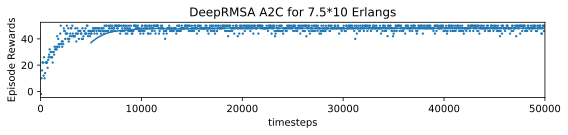

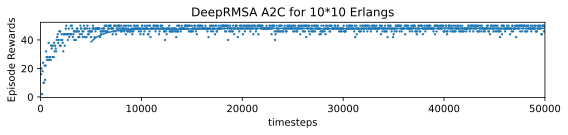

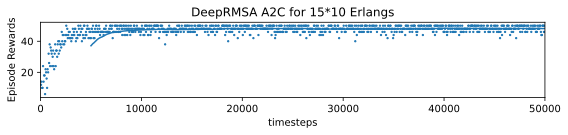

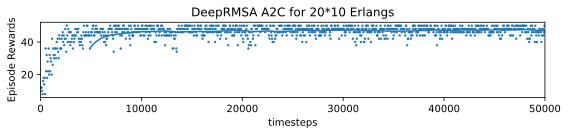

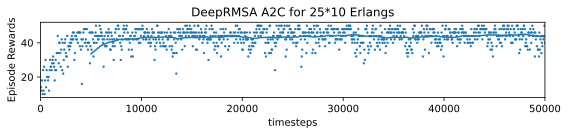

...

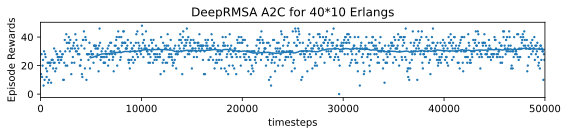

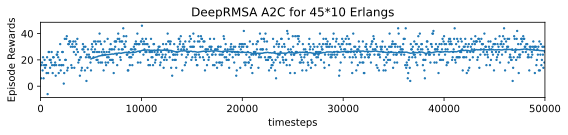

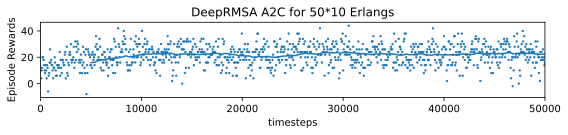

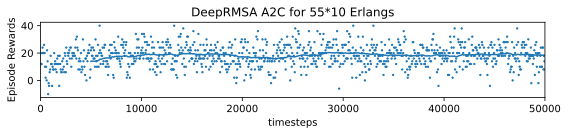

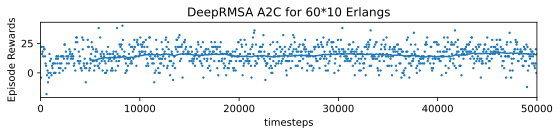

In [ ]:
from stable_baselines3.a2c.policies import MlpPolicy

for ht in [7.5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]:

  # mean_service_holding_time varying between 7.5 and 60,
  env_args = dict(topology=topology2, seed=10, 
                allow_rejection=False, # the agent cannot proactively reject a request
                j=1, # consider only the first suitable spectrum block for the spectrum assignment
                mean_service_holding_time=ht, # value is not set as in the paper to achieve comparable reward values
                episode_length=50, node_request_probabilities=node_request_probabilities_eurocore, num_spectrum_resources = 358)
  
  # Create log dir
  log_dir = "/content/drive/MyDrive/optical-rl-gym-Modif/tmp/explainability/reward_shaping/a2c-{}-eurocore/".format(ht)
  os.makedirs(log_dir, exist_ok=True)
  callback = SaveOnBestTrainingRewardCallback(check_freq=100, log_dir=log_dir)

  env = gym.make('DeepRMSADPP-v0', **env_args)

  # logs will be saved in log_dir/monitor.csv
  # in this case, on top of the usual monitored things, we also monitor service and bit rate blocking probabilities
  env = Monitor(env, log_dir + 'training', info_keywords=('episode_service_blocking_rate', 'bit_rate_blocking_rate', 'failure', 'episode_failure',
                    'failure_slots','episode_failure_slots', 
                    'failure_disjointness','episode_failure_disjointness', 'length_comparison', 'length_wp', 'length_bp', 'hops_wp', 'hops_bp', 'number_slots_wp',
                    'number_slots_bp',
                    'initial_slots_wp',
                    'initial_slots_bp',
                    'average_external_fragmentation_wp', 
                    'average_external_fragmentation_bp'))

  policy_args = dict(net_arch=5*[128])#, act_fun=tf.nn.elu) # the neural network has four layers with 150 neurons each

  agent = A2C(MlpPolicy, env, verbose=0, tensorboard_log="/content/drive/MyDrive/optical-rl-gym-Modif/tb/A2C-50-DeepRMSA-v0/", policy_kwargs=policy_args, gamma=.95 , learning_rate=10e-5)

  a = agent.learn(total_timesteps=50000, callback=callback)

  from stable_baselines3.common import results_plotter

  results_plotter.plot_results([log_dir], 1e10, results_plotter.X_TIMESTEPS, "DeepRMSA A2C for {}*10 Erlangs".format(ht))

  from stable_baselines3.common.evaluation import evaluate_policy

  testing_env = gym.make('DeepRMSADPP-v0', **env_args)

  # Logs will be saved in log_dir/monitor.csv
  testing_env = Monitor(testing_env, log_dir + 'testing', info_keywords=('episode_service_blocking_rate', 'bit_rate_blocking_rate','failure', 'episode_failure',
                    'failure_slots','episode_failure_slots', 
                    'failure_disjointness','episode_failure_disjointness', 'length_comparison', 'length_wp', 'length_bp', 'hops_wp', 'hops_bp', 'number_slots_wp',
                    'number_slots_bp',
                    'initial_slots_wp',
                    'initial_slots_bp',
                    'average_external_fragmentation_wp', 
                    'average_external_fragmentation_bp'))

  # Evaluate the trained agent
  mean_reward, std_reward = evaluate_policy(a, testing_env, n_eval_episodes=500)

  print(f"mean_reward:{mean_reward:.2f} +/- {std_reward:.2f}")

## Plotting the obtained results

<Figure size 3000x1500 with 0 Axes>

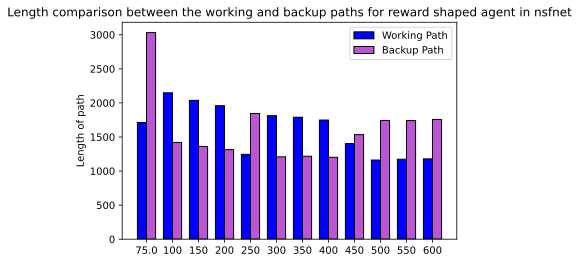

<Figure size 3000x1500 with 0 Axes>

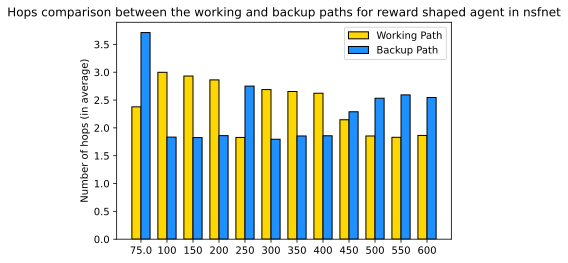

<Figure size 3000x1500 with 0 Axes>

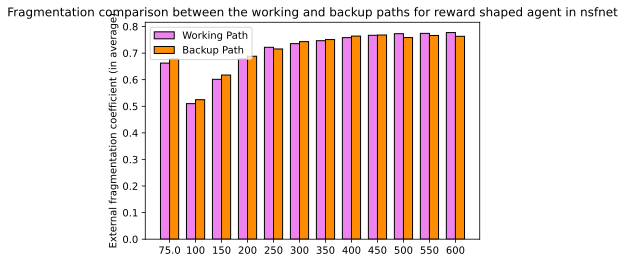

<Figure size 3000x1500 with 0 Axes>

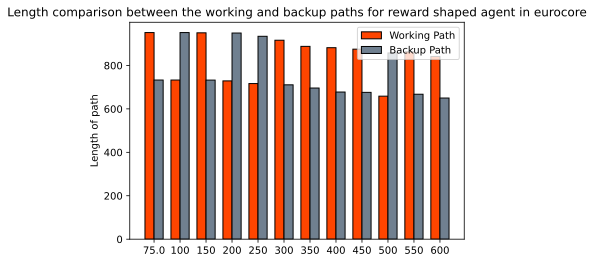

<Figure size 3000x1500 with 0 Axes>

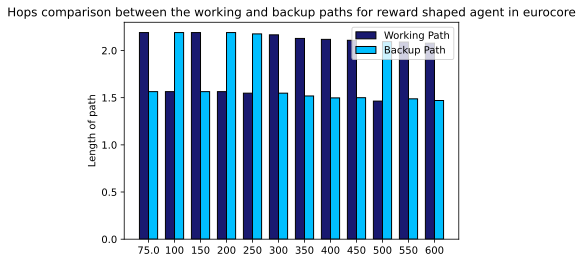

<Figure size 3000x1500 with 0 Axes>

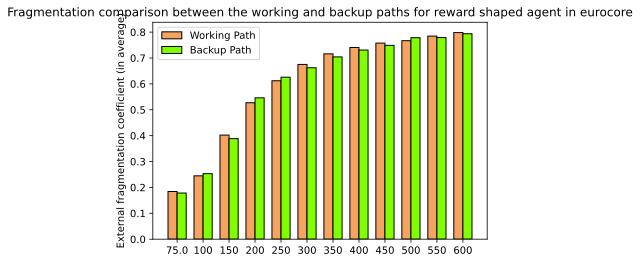

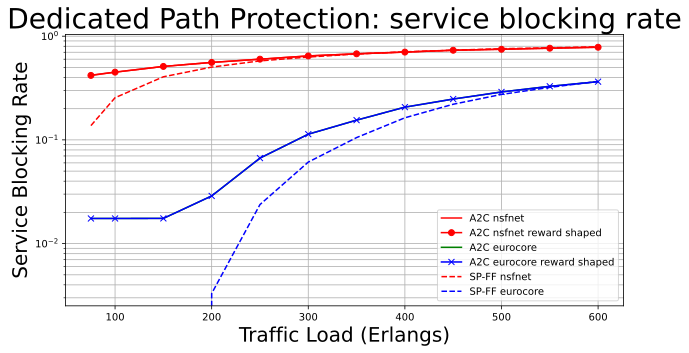

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

Matrix = [7.5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]

means_bit_rate_a2c_nsfnet = []
means_episode_a2c_nsfnet = []
means_disjointness_a2c_nsfnet = []
means_slots_failure_a2c_nsfnet = []
means_length_comparison_nsfnet = []
means_length_wp_nsfnet = []
means_length_bp_nsfnet = []
means_hops_wp_nsfnet = []
means_hops_bp_nsfnet = []
means_number_slots_wp = []
means_number_slots_bp = []
means_initial_slots_wp = []
means_initial_slots_bp = []
means_average_external_fragmentation_wp = []
means_average_external_fragmentation_bp = []

for i in Matrix: 
  df=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/explainability/fragmentation_study/a2c-{}-nsfnet/testing.monitor.csv'.format(i),header=1)
  means_bit_rate_a2c_nsfnet.append(df.bit_rate_blocking_rate.mean())
  means_episode_a2c_nsfnet.append(df.episode_service_blocking_rate.mean())
  means_disjointness_a2c_nsfnet.append(df.failure_disjointness.mean())
  means_slots_failure_a2c_nsfnet.append(df.failure_slots.mean())
  means_length_comparison_nsfnet.append(df.length_comparison.mean())
  means_length_wp_nsfnet.append(df.length_wp.mean())
  means_length_bp_nsfnet.append(df.length_bp.mean())
  means_hops_wp_nsfnet.append(df.hops_wp.mean())
  means_hops_bp_nsfnet.append(df.hops_bp.mean())
  means_number_slots_wp.append(df.number_slots_wp.mean())
  means_number_slots_bp.append(df.number_slots_bp.mean())
  means_initial_slots_wp.append(df.initial_slots_wp.mean())
  means_initial_slots_bp.append(df.initial_slots_bp.mean())
  means_average_external_fragmentation_wp.append(df.average_external_fragmentation_wp.mean())
  means_average_external_fragmentation_bp.append(df.average_external_fragmentation_bp.mean())


# With the reward shaping of -4 for higher fragmentation in the working path than in the backup path

means_bit_rate_a2c_nsfnet_reward = []
means_episode_a2c_nsfnet_reward = []
means_disjointness_a2c_nsfnet_reward = []
means_slots_failure_a2c_nsfnet_reward = []
means_length_comparison_nsfnet_reward = []
means_length_wp_nsfnet_reward = []
means_length_bp_nsfnet_reward = []
means_hops_wp_nsfnet_reward = []
means_hops_bp_nsfnet_reward = []
means_number_slots_wp_reward = []
means_number_slots_bp_reward = []
means_initial_slots_wp_reward = []
means_initial_slots_bp_reward = []
means_average_external_fragmentation_wp_reward = []
means_average_external_fragmentation_bp_reward = []

for i in Matrix: 
  df2=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/explainability/reward_shaping/a2c-{}-nsfnet/testing.monitor.csv'.format(i),header=1)
  means_bit_rate_a2c_nsfnet_reward.append(df2.bit_rate_blocking_rate.mean())
  means_episode_a2c_nsfnet_reward.append(df2.episode_service_blocking_rate.mean())
  means_disjointness_a2c_nsfnet_reward.append(df2.failure_disjointness.mean())
  means_slots_failure_a2c_nsfnet_reward.append(df2.failure_slots.mean())
  means_length_comparison_nsfnet_reward.append(df2.length_comparison.mean())
  means_length_wp_nsfnet_reward.append(df2.length_wp.mean())
  means_length_bp_nsfnet_reward.append(df2.length_bp.mean())
  means_hops_wp_nsfnet_reward.append(df2.hops_wp.mean())
  means_hops_bp_nsfnet_reward.append(df2.hops_bp.mean())
  means_number_slots_wp_reward.append(df2.number_slots_wp.mean())
  means_number_slots_bp_reward.append(df2.number_slots_bp.mean())
  means_initial_slots_wp_reward.append(df2.initial_slots_wp.mean())
  means_initial_slots_bp_reward.append(df2.initial_slots_bp.mean())
  means_average_external_fragmentation_wp_reward.append(df2.average_external_fragmentation_wp.mean())
  means_average_external_fragmentation_bp_reward.append(df2.average_external_fragmentation_bp.mean())
  

# Heuristics

means_bit_rate_a2c_eurocore = []
means_episode_a2c_eurocore = []
means_disjointness_a2c_eurocore = []
means_slots_failure_a2c_eurocore = []
means_length_comparison_eurocore = []
means_length_wp_eurocore = []
means_length_bp_eurocore = []
means_hops_wp_eurocore = []
means_hops_bp_eurocore = []
means_number_slots_wp_eurocore = []
means_number_slots_bp_eurocore = []
means_initial_slots_wp_eurocore = []
means_initial_slots_bp_eurocore = []
means_average_external_fragmentation_wp_eurocore = []
means_average_external_fragmentation_bp_eurocore = []

for i in Matrix: 
  df3=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/explainability/fragmentation_study/a2c-{}-eurocore/testing.monitor.csv'.format(i),header=1)
  means_bit_rate_a2c_eurocore.append(df3.bit_rate_blocking_rate.mean())
  means_episode_a2c_eurocore.append(df3.episode_service_blocking_rate.mean())
  means_disjointness_a2c_eurocore.append(df3.failure_disjointness.mean())
  means_slots_failure_a2c_eurocore.append(df3.failure_slots.mean())
  means_length_comparison_eurocore.append(df3.length_comparison.mean())
  means_length_wp_eurocore.append(df3.length_wp.mean())
  means_length_bp_eurocore.append(df3.length_bp.mean())
  means_hops_wp_eurocore.append(df3.hops_wp.mean())
  means_hops_bp_eurocore.append(df3.hops_bp.mean())
  means_number_slots_wp_eurocore.append(df3.number_slots_wp.mean())
  means_number_slots_bp_eurocore.append(df3.number_slots_bp.mean())
  means_initial_slots_wp_eurocore.append(df3.initial_slots_wp.mean())
  means_initial_slots_bp_eurocore.append(df3.initial_slots_bp.mean())
  means_average_external_fragmentation_wp_eurocore.append(df3.average_external_fragmentation_wp.mean())
  means_average_external_fragmentation_bp_eurocore.append(df3.average_external_fragmentation_bp.mean())


# With the reward shaping of -4 for higher fragmentation in the working path than in the backup path

means_bit_rate_a2c_eurocore_reward = []
means_episode_a2c_eurocore_reward = []
means_disjointness_a2c_eurocore_reward = []
means_slots_failure_a2c_eurocore_reward = []
means_length_comparison_eurocore_reward = []
means_length_wp_eurocore_reward = []
means_length_bp_eurocore_reward = []
means_hops_wp_eurocore_reward = []
means_hops_bp_eurocore_reward = []
means_number_slots_wp_eurocore_reward = []
means_number_slots_bp_eurocore_reward = []
means_initial_slots_wp_eurocore_reward = []
means_initial_slots_bp_eurocore_reward = []
means_average_external_fragmentation_wp_eurocore_reward = []
means_average_external_fragmentation_bp_eurocore_reward = []

for i in Matrix: 
  df4=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/explainability/reward_shaping/a2c-{}-eurocore/testing.monitor.csv'.format(i),header=1)
  means_bit_rate_a2c_eurocore_reward.append(df4.bit_rate_blocking_rate.mean())
  means_episode_a2c_eurocore_reward.append(df4.episode_service_blocking_rate.mean())
  means_disjointness_a2c_eurocore_reward.append(df4.failure_disjointness.mean())
  means_slots_failure_a2c_eurocore_reward.append(df4.failure_slots.mean())
  means_length_comparison_eurocore_reward.append(df4.length_comparison.mean())
  means_length_wp_eurocore_reward.append(df4.length_wp.mean())
  means_length_bp_eurocore_reward.append(df4.length_bp.mean())
  means_hops_wp_eurocore_reward.append(df4.hops_wp.mean())
  means_hops_bp_eurocore_reward.append(df4.hops_bp.mean())
  means_number_slots_wp_eurocore_reward.append(df4.number_slots_wp.mean())
  means_number_slots_bp_eurocore_reward.append(df4.number_slots_bp.mean())
  means_initial_slots_wp_eurocore_reward.append(df4.initial_slots_wp.mean())
  means_initial_slots_bp_eurocore_reward.append(df4.initial_slots_bp.mean())
  means_average_external_fragmentation_wp_eurocore_reward.append(df4.average_external_fragmentation_wp.mean())
  means_average_external_fragmentation_bp_eurocore_reward.append(df4.average_external_fragmentation_bp.mean())



means_bit_rate_heuristics_nsfnet = []
means_episode_heuristics_nsfnet = []
means_disjointness_heuristics_nsfnet = []
means_slots_failure_heuristics_nsfnet = []
means_length_comparison_heuristics_nsfnet = []
means_length_wp_heuristics_nsfnet = []
means_length_bp_heuristics_nsfnet = []
means_hops_wp_heuristics_nsfnet = []
means_hops_bp_heuristics_nsfnet = []
means_number_slots_wp_heuristics_nsfnet = []
means_number_slots_bp_heuristics_nsfnet = []
means_initial_slots_wp_heuristics_nsfnet = []
means_initial_slots_bp_heuristics_nsfnet = []
means_average_external_fragmentation_wp_heuristics_nsfnet = []
means_average_external_fragmentation_bp_heuristics_nsfnet = []

for i in Matrix: 
  df5=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/explainability/fragmentation_study/heuristics-{}-nsfnet/sp_ff.monitor.csv'.format(i),header=1)
  means_bit_rate_heuristics_nsfnet.append(df5.bit_rate_blocking_rate.mean())
  means_episode_heuristics_nsfnet.append(df5.episode_service_blocking_rate.mean())
  means_disjointness_heuristics_nsfnet.append(df5.failure_disjointness.mean())
  means_slots_failure_heuristics_nsfnet.append(df5.failure_slots.mean())
  means_length_comparison_heuristics_nsfnet.append(df5.length_comparison.mean())
  means_length_wp_heuristics_nsfnet.append(df5.length_wp.mean())
  means_length_bp_heuristics_nsfnet.append(df5.length_bp.mean())
  means_hops_wp_heuristics_nsfnet.append(df5.hops_wp.mean())
  means_hops_bp_heuristics_nsfnet.append(df5.hops_bp.mean())
  means_number_slots_wp_heuristics_nsfnet.append(df5.number_slots_wp.mean())
  means_number_slots_bp_heuristics_nsfnet.append(df5.number_slots_bp.mean())
  means_initial_slots_wp_heuristics_nsfnet.append(df5.initial_slots_wp.mean())
  means_initial_slots_bp_heuristics_nsfnet.append(df5.initial_slots_bp.mean())
  means_average_external_fragmentation_wp_heuristics_nsfnet.append(df5.average_external_fragmentation_wp.mean())
  means_average_external_fragmentation_bp_heuristics_nsfnet.append(df5.average_external_fragmentation_bp.mean())




means_bit_rate_heuristics_eurocore = []
means_episode_heuristics_eurocore = []
means_disjointness_heuristics_eurocore = []
means_slots_failure_heuristics_eurocore = []
means_length_comparison_heuristics_eurocore = []
means_length_wp_heuristics_eurocore = []
means_length_bp_heuristics_eurocore = []
means_hops_wp_heuristics_eurocore = []
means_hops_bp_heuristics_eurocore = []
means_number_slots_wp_heuristics_eurocore = []
means_number_slots_bp_heuristics_eurocore = []
means_initial_slots_wp_heuristics_eurocore = []
means_initial_slots_bp_heuristics_eurocore = []
means_average_external_fragmentation_wp_heuristics_eurocore = []
means_average_external_fragmentation_bp_heuristics_eurocore = []

for i in Matrix: 
  df6=pd.read_csv('/content/drive/MyDrive/optical-rl-gym-Modif/tmp/explainability/fragmentation_study/heuristics-{}-eurocore/sp_ff.monitor.csv'.format(i),header=1)
  means_bit_rate_heuristics_eurocore.append(df6.bit_rate_blocking_rate.mean())
  means_episode_heuristics_eurocore.append(df6.episode_service_blocking_rate.mean())
  means_disjointness_heuristics_eurocore.append(df6.failure_disjointness.mean())
  means_slots_failure_heuristics_eurocore.append(df6.failure_slots.mean())
  means_length_comparison_heuristics_eurocore.append(df6.length_comparison.mean())
  means_length_wp_heuristics_eurocore.append(df6.length_wp.mean())
  means_length_bp_heuristics_eurocore.append(df6.length_bp.mean())
  means_hops_wp_heuristics_eurocore.append(df6.hops_wp.mean())
  means_hops_bp_heuristics_eurocore.append(df6.hops_bp.mean())
  means_number_slots_wp_heuristics_eurocore.append(df6.number_slots_wp.mean())
  means_number_slots_bp_heuristics_eurocore.append(df6.number_slots_bp.mean())
  means_initial_slots_wp_heuristics_eurocore.append(df6.initial_slots_wp.mean())
  means_initial_slots_bp_heuristics_eurocore.append(df6.initial_slots_bp.mean())
  means_average_external_fragmentation_wp_heuristics_eurocore.append(df6.average_external_fragmentation_wp.mean())
  means_average_external_fragmentation_bp_heuristics_eurocore.append(df6.average_external_fragmentation_bp.mean())






Loads = []
for i in Matrix:
  Loads.append(i*10)

y_10 = means_bit_rate_a2c_nsfnet
y_11 = means_disjointness_a2c_nsfnet
y_12 = means_slots_failure_a2c_nsfnet
y_13 = means_length_comparison_nsfnet
y_14 = means_length_wp_nsfnet
y_15 = means_length_bp_nsfnet
y_16 = means_hops_wp_nsfnet
y_17 = means_hops_bp_nsfnet
y_18 = means_number_slots_wp
y_19 = means_number_slots_bp
y_120 = means_initial_slots_wp
y_121 = means_initial_slots_bp
y_122 = means_average_external_fragmentation_wp
y_123 = means_average_external_fragmentation_bp
y_124 = means_episode_a2c_nsfnet


y_20 = means_bit_rate_a2c_nsfnet_reward
y_21 = means_disjointness_a2c_nsfnet_reward
y_22 = means_slots_failure_a2c_nsfnet_reward
y_23 = means_length_comparison_nsfnet_reward
y_24 = means_length_wp_nsfnet_reward
y_25 = means_length_bp_nsfnet_reward
y_26 = means_hops_wp_nsfnet_reward
y_27 = means_hops_bp_nsfnet_reward
y_28 = means_number_slots_wp_reward
y_29 = means_number_slots_bp_reward
y_220 = means_initial_slots_wp_reward
y_221 = means_initial_slots_bp_reward
y_222 = means_average_external_fragmentation_wp_reward
y_223 = means_average_external_fragmentation_bp_reward
y_224 = means_episode_a2c_nsfnet_reward



y_30 = means_bit_rate_a2c_eurocore
y_31 = means_disjointness_a2c_eurocore
y_32 = means_slots_failure_a2c_eurocore
y_33 = means_length_comparison_eurocore
y_34 = means_length_wp_eurocore
y_35 = means_length_bp_eurocore
y_36 = means_hops_wp_eurocore
y_37 = means_hops_bp_eurocore
y_38 = means_number_slots_wp_eurocore
y_39 = means_number_slots_bp_eurocore
y_320 = means_initial_slots_wp_eurocore
y_321 = means_initial_slots_bp_eurocore
y_322 = means_average_external_fragmentation_wp_eurocore
y_323 = means_average_external_fragmentation_bp_eurocore
y_324 = means_episode_a2c_eurocore


y_40 = means_bit_rate_a2c_eurocore_reward
y_41 = means_disjointness_a2c_eurocore_reward
y_42 = means_slots_failure_a2c_eurocore_reward
y_43 = means_length_comparison_eurocore_reward
y_44 = means_length_wp_eurocore_reward
y_45 = means_length_bp_eurocore_reward
y_46 = means_hops_wp_eurocore_reward
y_47 = means_hops_bp_eurocore_reward
y_48 = means_number_slots_wp_eurocore_reward
y_49 = means_number_slots_bp_eurocore_reward
y_420 = means_initial_slots_wp_eurocore_reward
y_421 = means_initial_slots_bp_eurocore_reward
y_422 = means_average_external_fragmentation_wp_eurocore_reward
y_423 = means_average_external_fragmentation_bp_eurocore_reward
y_424 = means_episode_a2c_eurocore_reward


y_50 = means_bit_rate_heuristics_nsfnet
y_51 = means_disjointness_heuristics_nsfnet
y_52 = means_slots_failure_heuristics_nsfnet
y_53 = means_length_comparison_heuristics_nsfnet
y_54 = means_length_wp_heuristics_nsfnet
y_55 = means_length_bp_heuristics_nsfnet
y_56 = means_hops_wp_heuristics_nsfnet
y_57 = means_hops_bp_heuristics_nsfnet
y_58 = means_number_slots_wp_heuristics_nsfnet
y_59 = means_number_slots_bp_heuristics_nsfnet
y_520 = means_initial_slots_wp_heuristics_nsfnet
y_521 = means_initial_slots_bp_heuristics_nsfnet
y_522 = means_average_external_fragmentation_wp_heuristics_nsfnet
y_523 = means_average_external_fragmentation_bp_heuristics_nsfnet 
y_524 = means_episode_heuristics_nsfnet

y_60 = means_bit_rate_heuristics_eurocore
y_61 = means_disjointness_heuristics_eurocore
y_62 = means_slots_failure_heuristics_eurocore
y_63 = means_length_comparison_heuristics_eurocore
y_64 = means_length_wp_heuristics_eurocore
y_65 = means_length_bp_heuristics_eurocore
y_66 = means_hops_wp_heuristics_eurocore
y_67 = means_hops_bp_heuristics_eurocore
y_68 = means_number_slots_wp_heuristics_eurocore
y_69 = means_number_slots_bp_heuristics_eurocore
y_620 = means_initial_slots_wp_heuristics_eurocore
y_621 = means_initial_slots_bp_heuristics_eurocore
y_622 = means_average_external_fragmentation_wp_heuristics_eurocore
y_623 = means_average_external_fragmentation_bp_heuristics_eurocore
y_624 = means_episode_heuristics_nsfnet



# PLOTS

# NSFNET PLOTS

# A2C agent

# Comparison between the working path and backup path length

plt.figure(figsize=(10,5), dpi = 300)

x = np.arange(len(Loads))
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, y_24, width, label='Working Path', color='blue', edgecolor='black')
rects2 = ax.bar(x + width/2, y_25, width, label='Backup Path', color='mediumorchid', edgecolor='black')

ax.set_ylabel('Length of path')
ax.set_title('Length comparison between the working and backup paths for reward shaped agent in nsfnet')
ax.set_xticks(x)
ax.set_xticklabels(Loads)
ax.legend()

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Length_nsfnet_reward_shaped.png")
plt.show()


# Comparison between the working path and backup path hops
plt.figure(figsize=(10,5), dpi = 300)

x = np.arange(len(Loads))
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, y_26, width, label='Working Path', color='gold', edgecolor='black')
rects2 = ax.bar(x + width/2, y_27, width, label='Backup Path', color='dodgerblue', edgecolor='black')

ax.set_ylabel('Number of hops (in average)')
ax.set_title('Hops comparison between the working and backup paths for reward shaped agent in nsfnet')
ax.set_xticks(x)
ax.set_xticklabels(Loads)
ax.legend()

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Hops_nsfnet_reward_shaped.png")
plt.show()

# Comparison between the working path and backup path fragmentation
plt.figure(figsize=(10,5), dpi = 300)

x = np.arange(len(Loads))
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, y_222, width, label='Working Path', color='violet', edgecolor='black')
rects2 = ax.bar(x + width/2, y_223, width, label='Backup Path', color='darkorange', edgecolor='black')

ax.set_ylabel('External fragmentation coefficient (in average)')
ax.set_title('Fragmentation comparison between the working and backup paths for reward shaped agent in nsfnet')
ax.set_xticks(x)
ax.set_xticklabels(Loads)
ax.legend()

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Fragmentation_nsfnet_reward_shaped.png")
plt.show()


# Eurocore

plt.figure(figsize=(10,5), dpi = 300)

x = np.arange(len(Loads))
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, y_44, width, label='Working Path', color='orangered', edgecolor='black')
rects2 = ax.bar(x + width/2, y_45, width, label='Backup Path', color='slategray', edgecolor='black')

ax.set_ylabel('Length of path')
ax.set_title('Length comparison between the working and backup paths for reward shaped agent in eurocore')
ax.set_xticks(x)
ax.set_xticklabels(Loads)
ax.legend()

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Length_eurocore_reward_shaped.png")
plt.show()



plt.figure(figsize=(10,5), dpi = 300)

x = np.arange(len(Loads))
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, y_46, width, label='Working Path', color='midnightblue', edgecolor='black')
rects2 = ax.bar(x + width/2, y_47, width, label='Backup Path', color='deepskyblue', edgecolor='black')

ax.set_ylabel('Length of path')
ax.set_title('Hops comparison between the working and backup paths for reward shaped agent in eurocore')
ax.set_xticks(x)
ax.set_xticklabels(Loads)
ax.legend()

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Hops_eurocore_reward_shaped.png")
plt.show()


# Comparison between the working path and backup path fragmentation
plt.figure(figsize=(10,5), dpi = 300)

x = np.arange(len(Loads))
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, y_422, width, label='Working Path', color='sandybrown', edgecolor='black')
rects2 = ax.bar(x + width/2, y_423, width, label='Backup Path', color='chartreuse', edgecolor='black')

ax.set_ylabel('External fragmentation coefficient (in average)')
ax.set_title('Fragmentation comparison between the working and backup paths for reward shaped agent in eurocore')
ax.set_xticks(x)
ax.set_xticklabels(Loads)
ax.legend()

images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
plt.savefig(f"{images_dir}Fragmentation_eurocore_reward_shaped.png")
plt.show()




# Bit error rate comparison between reward shaped agent and initial agent

plt.figure(figsize=(10,5), dpi = 300)

plt.plot(Loads,y_10,'r', linewidth = 1.5)
plt.plot(Loads, y_20, 'r', marker = 'o', linewidth = 1.5)
plt.plot(Loads, y_30, 'g', linewidth = 1.5)
plt.plot(Loads, y_40, 'b', marker = 'x', linewidth = 1.5)
plt.plot(Loads, y_50, 'r--', linewidth = 1.5)
plt.plot(Loads, y_60, 'b--', linewidth = 1.5)
# Need to add the heuristics


plt.yscale("log")
plt.grid(axis='y', which = 'both')
plt.grid(axis='x', which='both')
plt.title(("Dedicated Path Protection: service blocking rate"), fontsize = 28)

plt.xlabel(("Traffic Load (Erlangs)"), fontsize = 20)
plt.ylabel(("Service Blocking Rate"), fontsize = 20)

plt.gca().legend(('A2C nsfnet', 'A2C nsfnet reward shaped', 'A2C eurocore',  'A2C eurocore reward shaped', 'SP-FF nsfnet', 'SP-FF eurocore'))

#images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results/'
#plt.savefig(f"{images_dir}Comparison_reward_shaping_SBR.png")
plt.show()






# Comparison between Agent and Heuristics

# Comparison of length using the function (working_path.length / backup_path.length) / ( 1 + (working_path.length / backup_path.length))

#plt.figure(figsize=(10,5), dpi = 300)
#x = np.arange(len(Loads))
#width = 0.25  # the width of the bars

#fig, ax = plt.subplots()
#rects1 = ax.bar(x - width, y_13, width, label='A2C agent', color='#d00000', edgecolor='black')
#rects2 = ax.bar(x + width, y_23, width, label='Heuristics', color='#e85d04', edgecolor='black')
#rects3 = ax.bar(x, y_33, width, label='A2C reward shaped', color='blue', edgecolor='black')

#ax.set_ylabel('Length comparison')
#ax.set_title('Comparison of lengths between Heuristics, A2C agent and reward shaped A2C agent')
#ax.set_xticks(x)
#ax.set_xticklabels(Loads)
#ax.legend()

#images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
#plt.savefig(f"{images_dir}Length_comparison_nsfnet_heuristics_reward_shaped.png")
#plt.show()



# Comparison between Agents and Heuristics

# Comparison of length using the function (working_path.length / backup_path.length) / ( 1 + (working_path.length / backup_path.length))

#plt.figure(figsize=(10,5), dpi = 300)
#x = np.arange(len(Loads))
#width = 0.15  # the width of the bars

#fig, ax = plt.subplots()
#rects1 = ax.bar(x - 3*width/2, y_13, width, label='A2C agent', color='#BBDEF0', edgecolor='black')
#rects2 = ax.bar(x + 3*width/2, y_23, width, label='Heuristics', color='#F49F0A', edgecolor='black')
#rects3 = ax.bar(x - width/2, y_33, width, label='A2C reward shaped', color='#00A6A6', edgecolor='black')
#rects4 = ax.bar(x + width/2, y_43, width, label='A2C reward shaped 2', color='#EFCA08', edgecolor='black')

#ax.set_ylabel('Length comparison')
#ax.set_title('Comparison of lengths between Heuristics, A2C agent and the two reward shaped A2C agents')
#ax.set_xticks(x)
#ax.set_xticklabels(Loads)
#ax.legend()

#images_dir = '/content/drive/MyDrive/optical-rl-gym-Modif/tmp/Results_explainability/'
#plt.savefig(f"{images_dir}Length_comparison_nsfnet_heuristics_reward_shaped_2.png")
#plt.show()
